# Your First GAN

### Goal
In this notebook, you're going to create your first generative adversarial network (GAN) for this course! Specifically, you will build and train a GAN that can generate hand-written images of digits (0-9). You will be using PyTorch in this specialization, so if you're not familiar with this framework, you may find the [PyTorch documentation](https://pytorch.org/docs/stable/index.html) useful. The hints will also often include links to relevant documentation.

### Learning Objectives
1.   Build the generator and discriminator components of a GAN from scratch.
2.   Create generator and discriminator loss functions.
3.   Train your GAN and visualize the generated images.


## Getting Started
You will begin by importing some useful packages and the dataset you will use to build and train your GAN. You are also provided with a visualizer function to help you investigate the images your GAN will create.


In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

d:\Anaconda\envs\YOLO\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
d:\Anaconda\envs\YOLO\lib\site-packages\onnxscript\converter.py:823: FutureWarning: 'onnxscript.values.Op.param_schemas' is deprecated in version 0.1 and will be removed in the future. Please use '.op_signature' instead.
  param_schemas = callee.param_schemas()
d:\Anaconda\envs\YOLO\lib\site-packages\onnxscript\converter.py:823: FutureWarning: 'onnxscript.values.OnnxFunction.param_schemas' is deprecated in version 0.1 and will be removed in the future. Please use '.op_signature' instead.
  param_schemas = callee.param_schemas()


#### MNIST Dataset
The training images your discriminator will be using is from a dataset called [MNIST](http://yann.lecun.com/exdb/mnist/). It contains 60,000 images of handwritten digits, from 0 to 9, like these:

![MNIST Digits](MnistExamples.png)

You may notice that the images are quite pixelated -- this is because they are all only 28 x 28! The small size of its images makes MNIST ideal for simple training. Additionally, these images are also in black-and-white so only one dimension, or "color channel", is needed to represent them (more on this later in the course).

#### Tensor
You will represent the data using [tensors](https://pytorch.org/docs/stable/tensors.html). Tensors are a generalization of matrices: for example, a stack of three matrices with the amounts of red, green, and blue at different locations in a 64 x 64 pixel image is a tensor with the shape 3 x 64 x 64.

Tensors are easy to manipulate and supported by [PyTorch](https://pytorch.org/), the machine learning library you will be using. Feel free to explore them more, but you can imagine these as multi-dimensional matrices or vectors!

#### Batches
While you could train your model after generating one image, it is extremely inefficient and leads to less stable training. In GANs, and in machine learning in general, you will process multiple images per training step. These are called batches.

This means that your generator will generate an entire batch of images and receive the discriminator's feedback on each before updating the model. The same goes for the discriminator, it will calculate its loss on the entire batch of generated images as well as on the reals before the model is updated.

## Generator
The first step is to build the generator component.

You will start by creating a function to make a single layer/block for the generator's neural network. Each block should include a [linear transformation](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) to map to another shape, a [batch normalization](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm1d.html) for stabilization, and finally a non-linear activation function (you use a [ReLU here](https://pytorch.org/docs/master/generated/torch.nn.ReLU.html)) so the output can be transformed in complex ways. You will learn more about activations and batch normalization later in the course.

In [2]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_generator_block
def get_generator_block(input_dim, output_dim):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation 
          followed by a batch normalization and then a relu activation
    '''
    return nn.Sequential(
        # Hint: Replace all of the "None" with the appropriate dimensions.
        # The documentation may be useful if you're less familiar with PyTorch:
        # https://pytorch.org/docs/stable/nn.html.
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True),
        #### END CODE HERE ####
    )

In [3]:
# Verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


Now you can build the generator class. It will take 3 values:

*   The noise vector dimension
*   The image dimension
*   The initial hidden dimension

Using these values, the generator will build a neural network with 5 layers/blocks. Beginning with the noise vector, the generator will apply non-linear transformations via the block function until the tensor is mapped to the size of the image to be outputted (the same size as the real images from MNIST). You will need to fill in the code for final layer since it is different than the others. The final layer does not need a normalization or activation function, but does need to be scaled with a [sigmoid function](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html). 

Finally, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">Generator</font></code></b>
</font>
</summary>

1. The output size of the final linear transformation should be im_dim, but remember you need to scale the outputs between 0 and 1 using the sigmoid function.
2. [nn.Linear](https://pytorch.org/docs/master/generated/torch.nn.Linear.html) and [nn.Sigmoid](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html) will be useful here. 
</details>


In [29]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Generator
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),
            # There is a dropdown with hints if you need them! 
            #### START CODE HERE ####
            nn.Linear(hidden_dim*8, im_dim),
            nn.Sigmoid()
            #### END CODE HERE ####
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return self.gen(noise)
    
    # Needed for grading
    def get_gen(self):
        '''
        Returns:
            the sequential model
        '''
        return self.gen

In [5]:
# Verify the generator class
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen()
    
    # Check there are six modules in the sequential part
    assert len(gen) == 6
    assert str(gen.__getitem__(4)).replace(' ', '') == f'Linear(in_features={hidden_dim * 8},out_features={im_dim},bias=True)'
    assert str(gen.__getitem__(5)).replace(' ', '') == 'Sigmoid()'
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    # Check that the output shape is correct
    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


## Noise
To be able to use your generator, you will need to be able to create noise vectors. The noise vector z has the important role of making sure the images generated from the same class don't all look the same -- think of it as a random seed. You will generate it randomly using PyTorch by sampling random numbers from the normal distribution. Since multiple images will be processed per pass, you will generate all the noise vectors at once.

Note that whenever you create a new tensor using torch.ones, torch.zeros, or torch.randn, you either need to create it on the target device, e.g. `torch.ones(3, 3, device=device)`, or move it onto the target device using `torch.ones(3, 3).to(device)`. You do not need to do this if you're creating a tensor by manipulating another tensor or by using a variation that defaults the device to the input, such as `torch.ones_like`. In general, use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros` where possible.

<details>

<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">get_noise</font></code></b>
</font>
</summary>

1. 
You will probably find [torch.randn](https://pytorch.org/docs/master/generated/torch.randn.html) useful here.
</details>

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_noise
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device 
    # argument to the function you use to generate the noise.
    #### START CODE HERE ####
    noise = torch.randn(n_samples,z_dim).to(device)
    return noise
    #### END CODE HERE ####
    #生成噪声：在生成对抗网络（GAN）中，生成器通常需要接收一个服从正态分布的噪声向量作为输入，然后生成接近真实数据分布的样本，此时 torch.randn 就可以用来生成这个噪声向量。

In [12]:
# Verify the noise vector function
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)
    
    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


## Discriminator
The second component that you need to construct is the discriminator. As with the generator component, you will start by creating a function that builds a neural network block for the discriminator.

*Note: You use leaky ReLUs to prevent the "dying ReLU" problem, which refers to the phenomenon where the parameters stop changing due to consistently negative values passed to a ReLU, which result in a zero gradient. You will learn more about this in the following lectures!* 


REctified Linear Unit (ReLU) |  Leaky ReLU
:-------------------------:|:-------------------------:
![](relu-graph.png)  |  ![](lrelu-graph.png)





In [22]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_discriminator_block
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation 
          followed by an nn.LeakyReLU activation with negative slope of 0.2 
          (https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html)
    '''
    return nn.Sequential(
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2,inplace=True)
        #### END CODE HERE ####
    )

In [23]:
# Verify the discriminator block function
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)
    
    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5
    
    assert str(block.__getitem__(0)).replace(' ', '') == f'Linear(in_features={in_features},out_features={out_features},bias=True)'        
    assert str(block.__getitem__(1)).replace(' ', '').replace(',inplace=True', '') == 'LeakyReLU(negative_slope=0.2)'


test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


Now you can use these blocks to make a discriminator! The discriminator class holds 2 values:

*   The image dimension
*   The hidden dimension

The discriminator will build a neural network with 4 layers. It will start with the image tensor and transform it until it returns a single number (1-dimension tensor) output. This output classifies whether an image is fake or real. Note that you do not need a sigmoid after the output layer since it is included in the loss function. Finally, to use your discrimator's neural network you are given a forward pass function that takes in an image tensor to be classified.


In [24]:
# UNQ_C5 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Discriminator
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Hint: You want to transform the final output into a single value,
            #       so add one more linear map.
            #### START CODE HERE ####
            nn.Linear(hidden_dim, 1)
            #### END CODE HERE ####
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image)
    
    # Needed for grading
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc

In [25]:
# Verify the discriminator class
def test_discriminator(z_dim, hidden_dim, num_test=100):
    
    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4
    assert type(disc.__getitem__(3)) == nn.Linear

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


## Training
Now you can put it all together!
First, you will set your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type, here using a GPU (which runs CUDA), not CPU

Next, you will load the MNIST dataset as tensors using a dataloader.



In [26]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'
# Load MNIST dataset as tensors
dataloader = DataLoader(
    MNIST('./data', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 9912422/9912422 [00:02<00:00, 4099186.82it/s]


Extracting ./data\MNIST\raw\train-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 28881/28881 [00:00<00:00, 150698.34it/s]


Extracting ./data\MNIST\raw\train-labels-idx1-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 1648877/1648877 [00:01<00:00, 1267691.11it/s]


Extracting ./data\MNIST\raw\t10k-images-idx3-ubyte.gz to ./data\MNIST\raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 4542/4542 [00:00<00:00, 940627.50it/s]

Extracting ./data\MNIST\raw\t10k-labels-idx1-ubyte.gz to ./data\MNIST\raw



Now, you can initialize your generator, discriminator, and optimizers. Note that each optimizer only takes the parameters of one particular model, since we want each optimizer to optimize only one of the models.

In [38]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before you train your GAN, you will need to create functions to calculate the discriminator's loss and the generator's loss. This is how the discriminator and generator will know how they are doing and improve themselves. Since the generator is needed when calculating the discriminator's loss, you will need to call .detach() on the generator result to ensure that only the discriminator is updated!

Remember that you have already defined a loss function earlier (`criterion`) and you are encouraged to use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros`. If you use `torch.ones` or `torch.zeros`, you'll need to pass `device=device` to them.

In [ ]:
# UNQ_C6 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_disc_loss
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images. 
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image 
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a 
    #            'ground truth' tensor in order to calculate the loss. 
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device=device)
    fake = gen(noise)
    fake_prd = disc(fake.detach()) # 这里使用 .detach()，因为不需要更新生成器
    fake_loss = criterion(fake_prd, torch.zeros_like(fake_prd))
    real_prd = disc(real)
    real_loss = criterion(real_prd, torch.ones_like(real_prd))
    disc_loss = (fake_loss + real_loss) / 2
    #### END CODE HERE ####
    return disc_loss

In [30]:
def test_disc_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data
        
        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")

Success!


In [35]:
# UNQ_C7 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images. 
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device)
    fake = gen(noise)
    fake_prd = disc(fake)
    gen_loss = criterion(fake_prd, torch.ones_like(fake_prd))
    #### END CODE HERE ####
    return gen_loss

In [36]:
def test_gen_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


Finally, you can put everything together! For each epoch, you will process the entire dataset in batches. For every batch, you will need to update the discriminator and generator using their loss. Batches are sets of images that will be predicted on before the loss functions are calculated (instead of calculating the loss function after each image). Note that you may see a loss to be greater than 1, this is okay since binary cross entropy loss can be any positive number for a sufficiently confident wrong guess. 

It’s also often the case that the discriminator will outperform the generator, especially at the start, because its job is easier. It's important that neither one gets too good (that is, near-perfect accuracy), which would cause the entire model to stop learning. Balancing the two models is actually remarkably hard to do in a standard GAN and something you will see more of in later lectures and assignments.

After you've submitted a working version with the original architecture, feel free to play around with the architecture if you want to see how different architectural choices can lead to better or worse GANs. For example, consider changing the size of the hidden dimension, or making the networks shallower or deeper by changing the number of layers.

<!-- In addition, be warned that this runs very slowly on a CPU. One way to run this more quickly is to use Google Colab: 

1.   Download the .ipynb
2.   Upload it to Google Drive and open it with Google Colab
3.   Make the runtime type GPU (under “Runtime” -> “Change runtime type” -> Select “GPU” from the dropdown)
4.   Replace `device = "cpu"` with `device = "cuda"`
5.   Make sure your `get_noise` function uses the right device -->

But remember, don’t expect anything spectacular: this is only the first lesson. The results will get better with later lessons as you learn methods to help keep your generator and discriminator at similar levels.

You should roughly expect to see this progression. On a GPU, this should take about 15 seconds per 500 steps, on average, while on CPU it will take roughly 1.5 minutes:
![MNIST Digits](MNIST_Progression.png)

  6%|▌         | 29/469 [00:00<00:11, 39.43it/s]

Step 500: Generator loss: 1.3984926623105998, discriminator loss: 0.4195314506292344


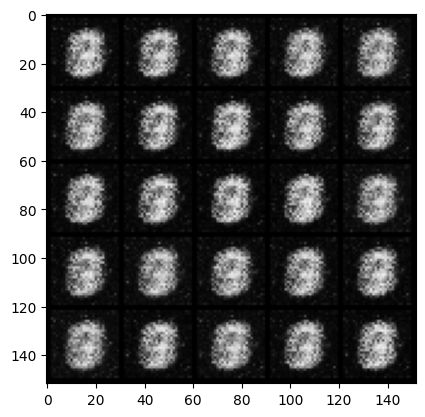

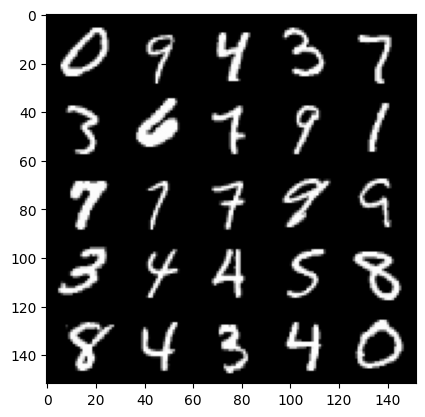

 13%|█▎        | 62/469 [00:01<00:10, 37.22it/s]

Step 1000: Generator loss: 1.692706567525863, discriminator loss: 0.2992978435456749


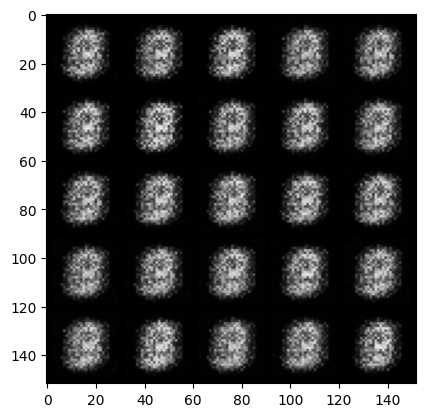

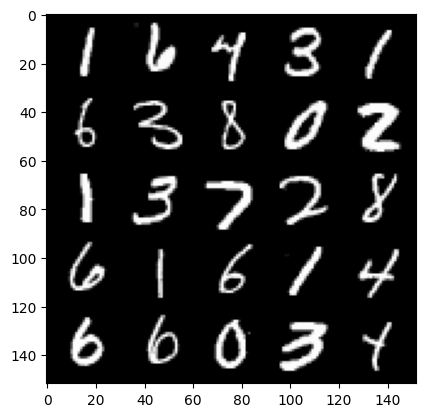

 20%|█▉        | 93/469 [00:02<00:09, 38.63it/s]

Step 1500: Generator loss: 1.9529437859058394, discriminator loss: 0.18262565246224413


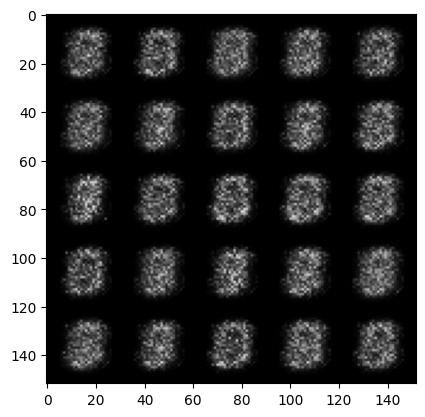

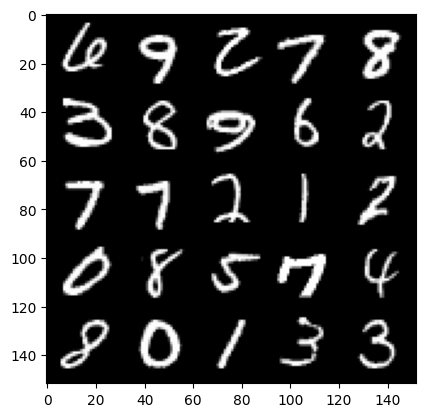

 26%|██▋       | 124/469 [00:03<00:08, 38.53it/s]

Step 2000: Generator loss: 1.7045771450996392, discriminator loss: 0.21431442287564273


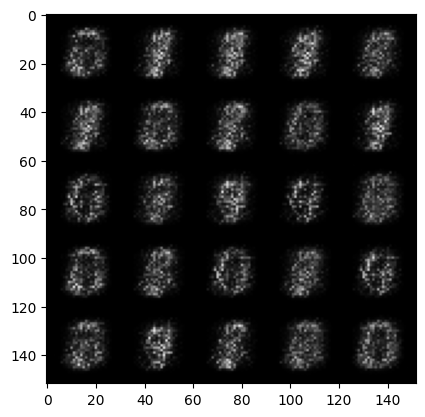

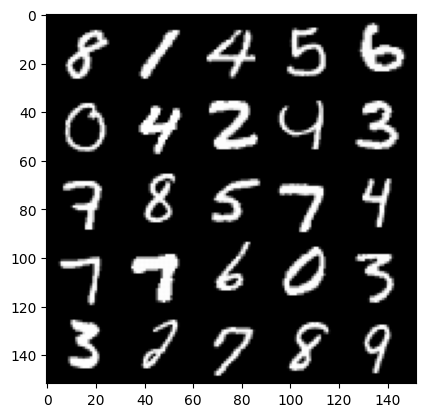

 33%|███▎      | 155/469 [00:03<00:07, 39.45it/s]

Step 2500: Generator loss: 1.6845051620006566, discriminator loss: 0.20554067277908328


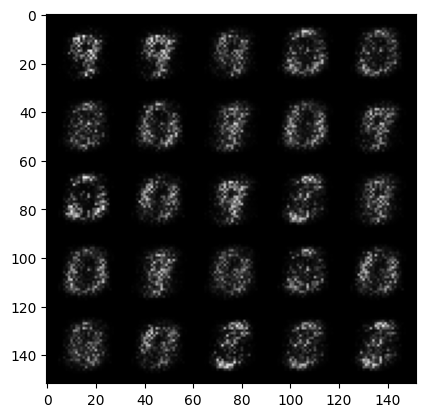

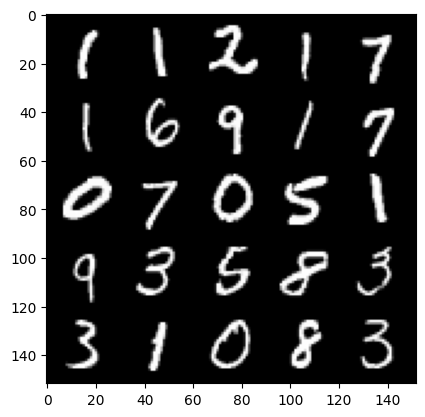

 39%|███▉      | 183/469 [00:04<00:07, 39.18it/s]

Step 3000: Generator loss: 1.9481280384063742, discriminator loss: 0.1603450834304094


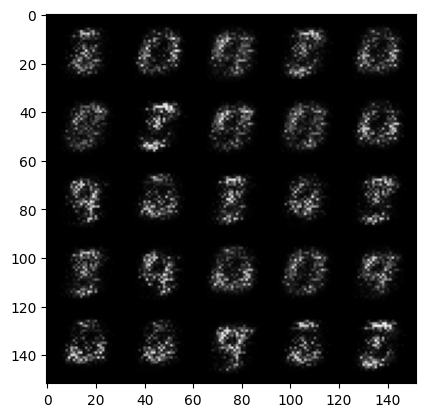

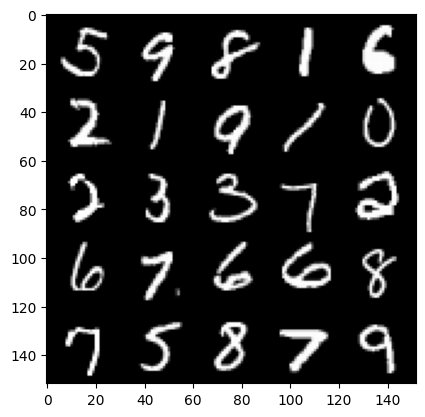

 46%|████▌     | 215/469 [00:05<00:06, 39.00it/s]

Step 3500: Generator loss: 2.287178317070009, discriminator loss: 0.14930177511274811


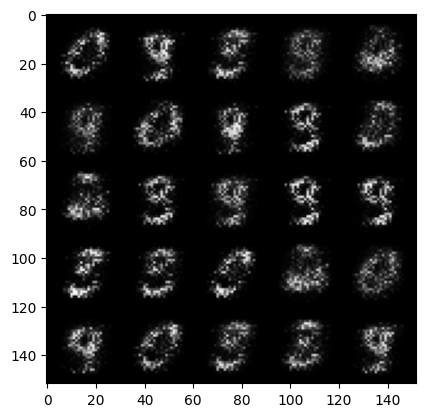

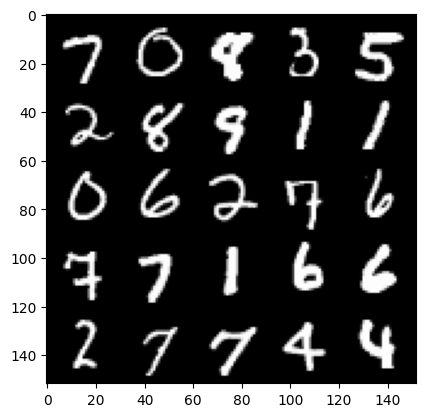

 52%|█████▏    | 246/469 [00:06<00:05, 38.57it/s]

Step 4000: Generator loss: 2.538601501464842, discriminator loss: 0.1461490421295166


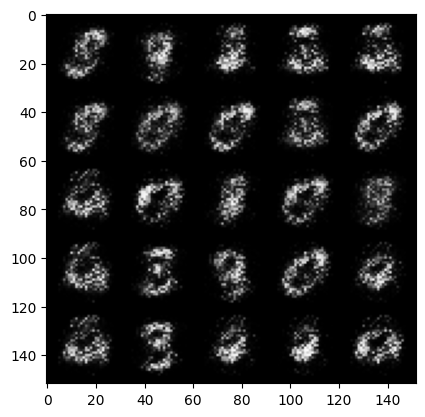

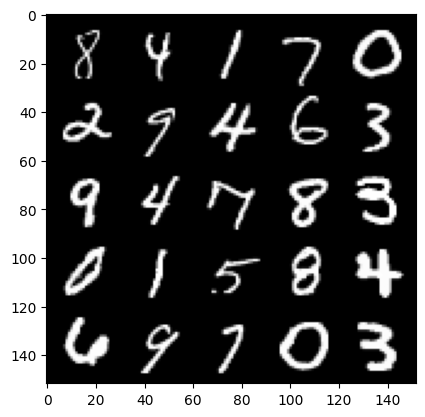

 59%|█████▉    | 277/469 [00:07<00:05, 38.15it/s]

Step 4500: Generator loss: 2.966392781734471, discriminator loss: 0.10919229289889336


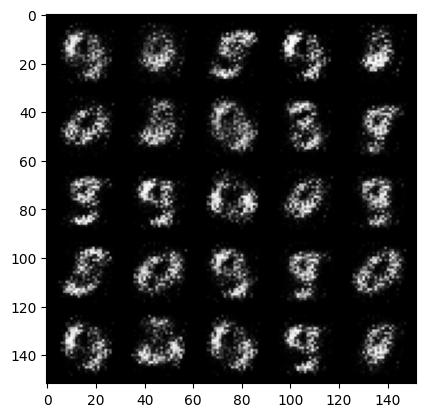

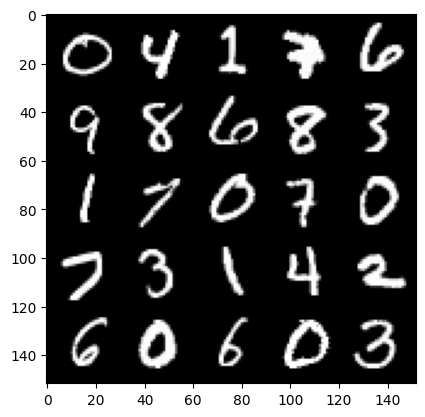

 66%|██████▌   | 310/469 [00:07<00:04, 38.21it/s]

Step 5000: Generator loss: 3.2691500720977755, discriminator loss: 0.08134474433213466


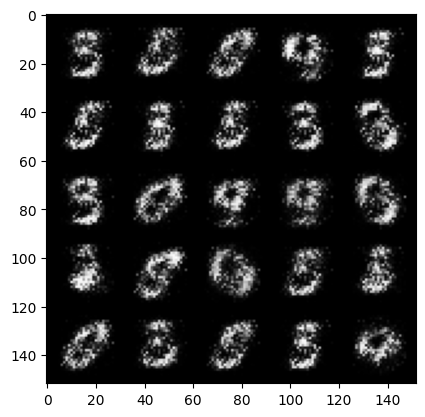

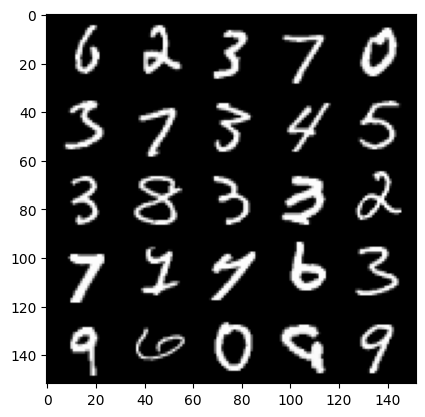

 73%|███████▎  | 341/469 [00:08<00:03, 34.89it/s]

Step 5500: Generator loss: 3.6222235050201443, discriminator loss: 0.07182506511360405


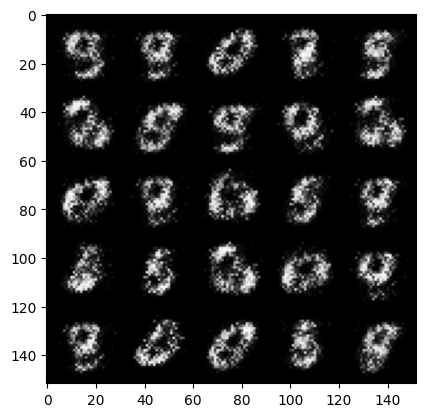

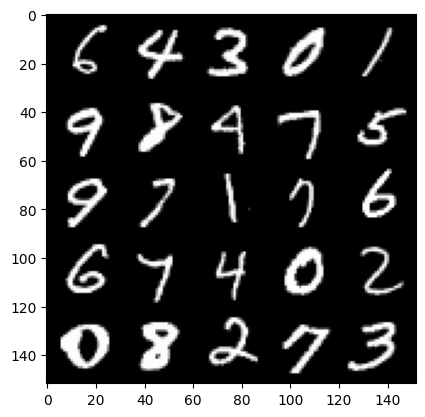

 79%|███████▉  | 371/469 [00:09<00:02, 38.01it/s]

Step 6000: Generator loss: 3.8174346556663505, discriminator loss: 0.07353443628549573


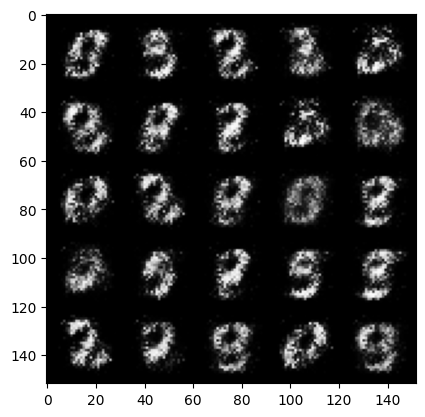

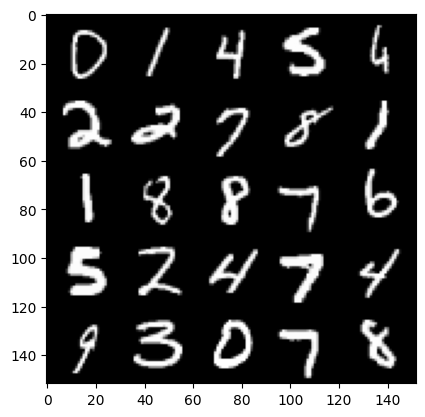

 85%|████████▌ | 400/469 [00:10<00:01, 38.71it/s]

Step 6500: Generator loss: 3.8345142264366143, discriminator loss: 0.07881973145902159


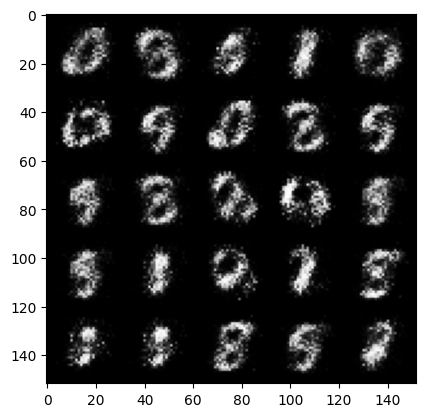

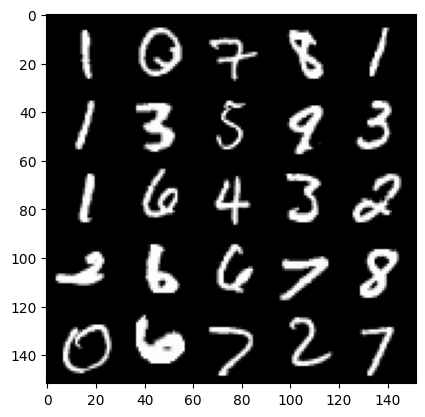

 92%|█████████▏| 431/469 [00:11<00:01, 36.34it/s]

Step 7000: Generator loss: 3.796564521312714, discriminator loss: 0.07383116210997111


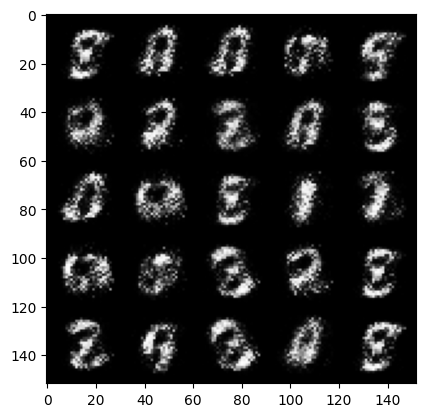

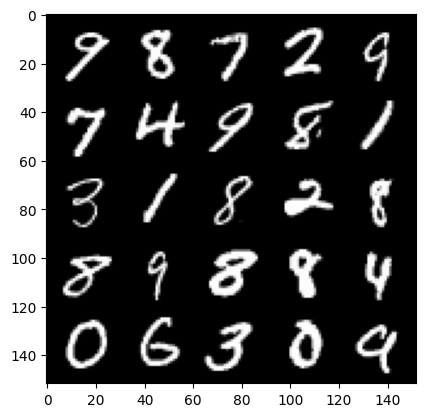

 99%|█████████▊| 462/469 [00:12<00:00, 39.11it/s]

Step 7500: Generator loss: 4.022600972652431, discriminator loss: 0.05797198869287965


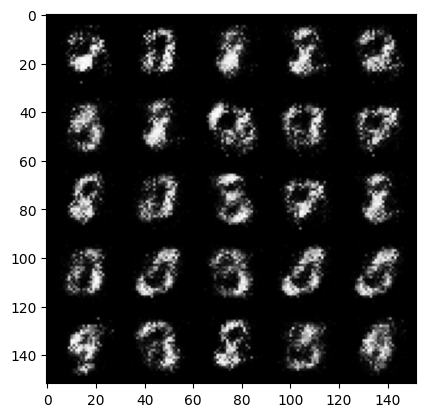

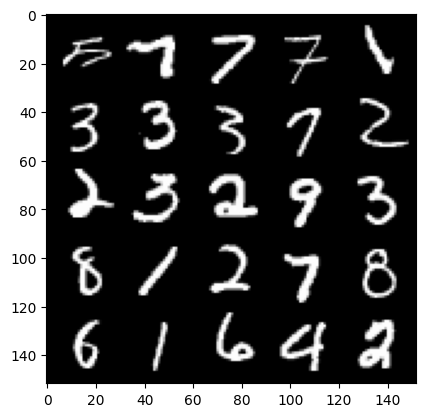

  5%|▌         | 24/469 [00:00<00:11, 37.58it/s]

Step 8000: Generator loss: 4.011428296566012, discriminator loss: 0.0598661864474416


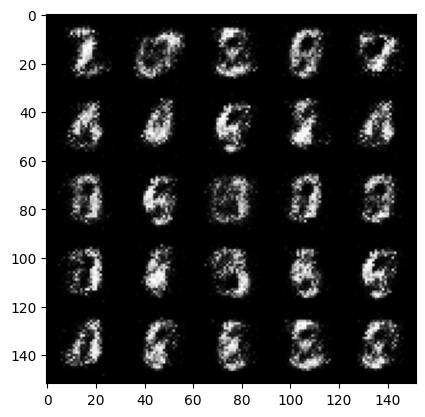

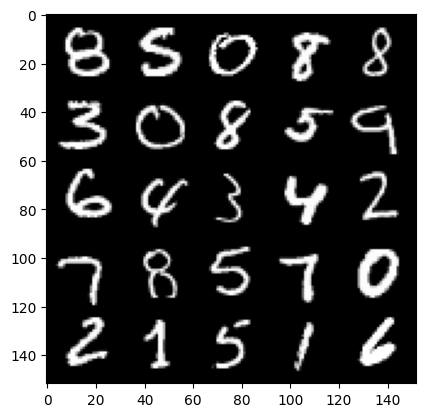

 12%|█▏        | 56/469 [00:01<00:11, 37.35it/s]

Step 8500: Generator loss: 4.06052890729904, discriminator loss: 0.057927539695054334


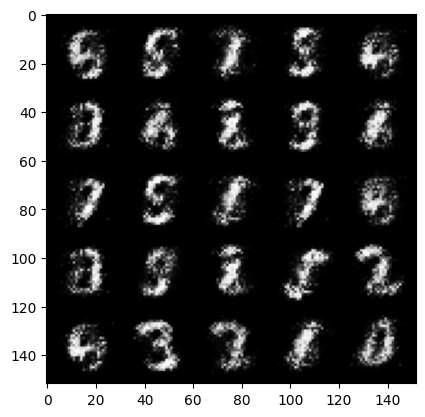

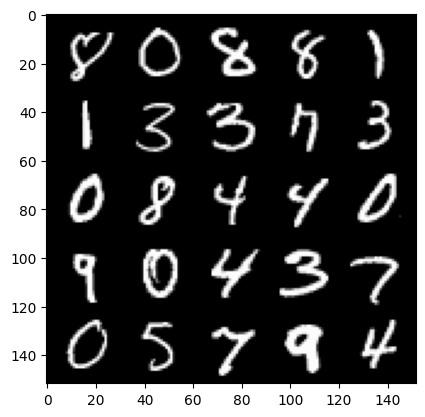

 18%|█▊        | 86/469 [00:02<00:09, 39.08it/s]

Step 9000: Generator loss: 3.996795419692991, discriminator loss: 0.06339433367550375


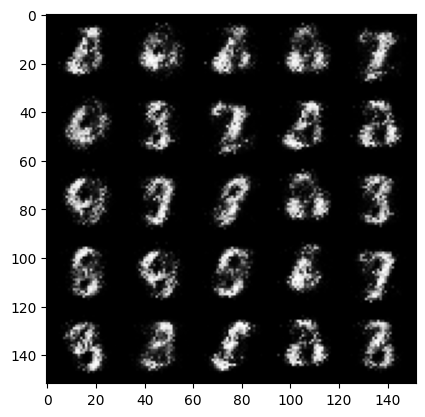

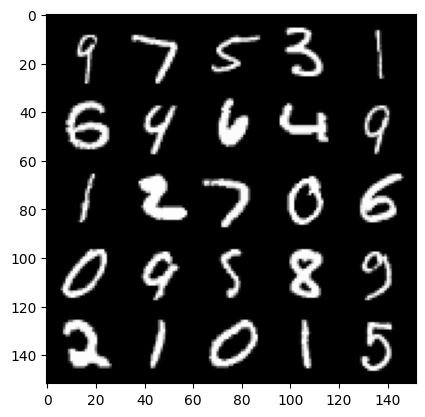

 25%|██▍       | 117/469 [00:02<00:08, 39.93it/s]

Step 9500: Generator loss: 3.9293610501289398, discriminator loss: 0.06549199353903537


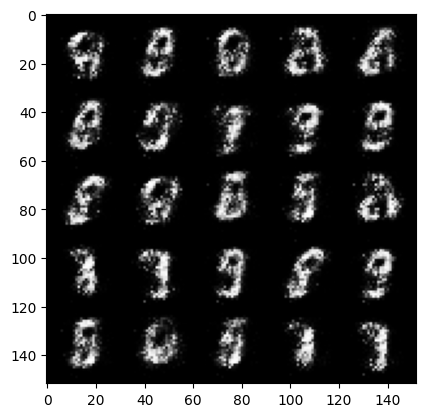

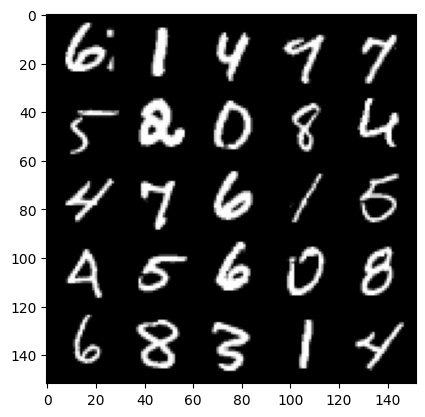

 32%|███▏      | 151/469 [00:03<00:08, 39.53it/s]

Step 10000: Generator loss: 4.105355877399441, discriminator loss: 0.06151452298834919


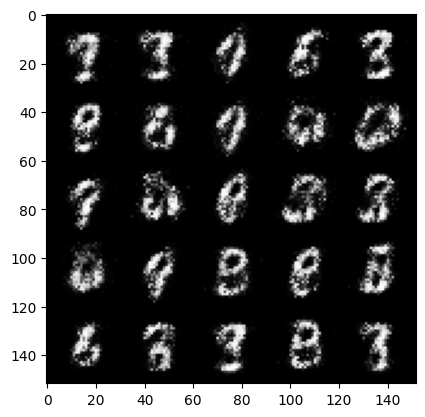

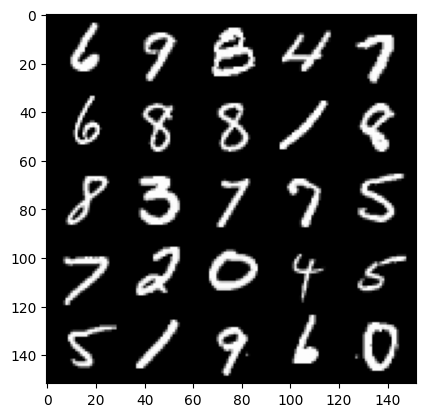

 39%|███▉      | 182/469 [00:04<00:07, 38.92it/s]

Step 10500: Generator loss: 3.987946393966677, discriminator loss: 0.06666361669450999


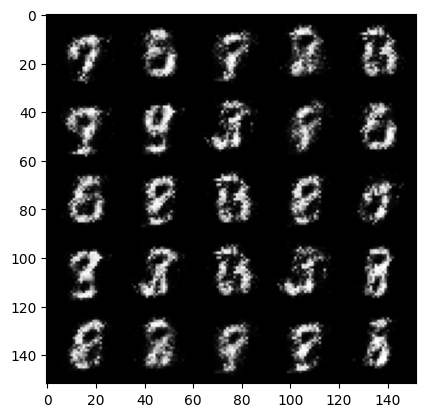

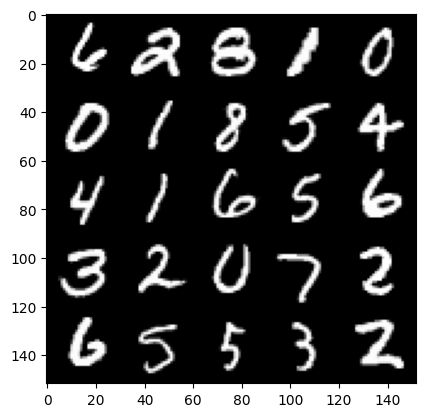

 45%|████▍     | 210/469 [00:05<00:06, 38.32it/s]

Step 11000: Generator loss: 3.8013283896446195, discriminator loss: 0.07528969333320851


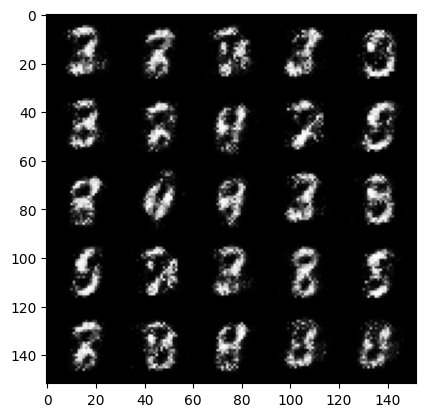

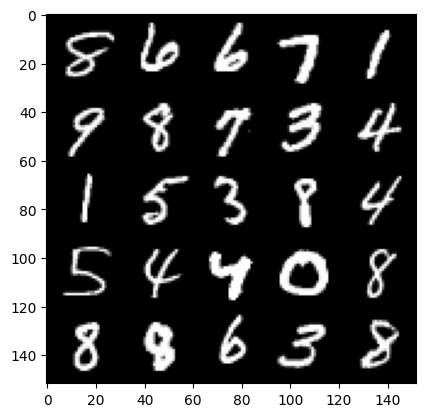

 52%|█████▏    | 243/469 [00:06<00:05, 40.03it/s]

Step 11500: Generator loss: 3.7785265326499955, discriminator loss: 0.08520664180070159


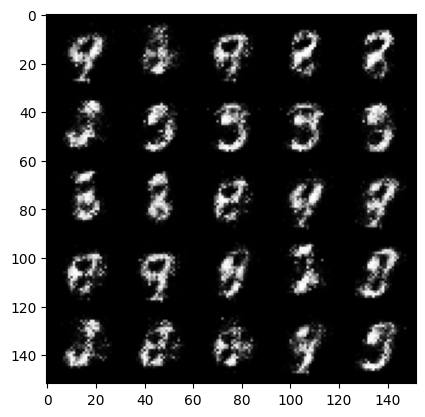

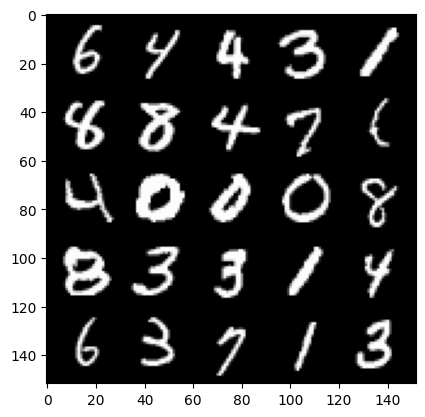

 58%|█████▊    | 273/469 [00:06<00:05, 37.83it/s]

Step 12000: Generator loss: 3.8903826980590845, discriminator loss: 0.09239078184217221


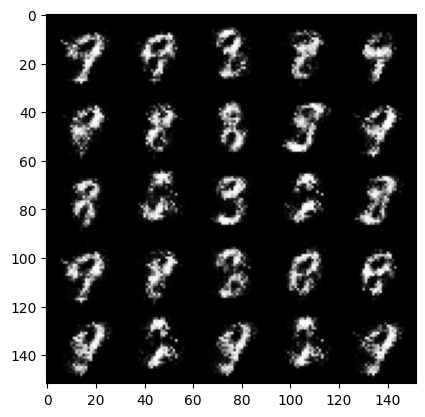

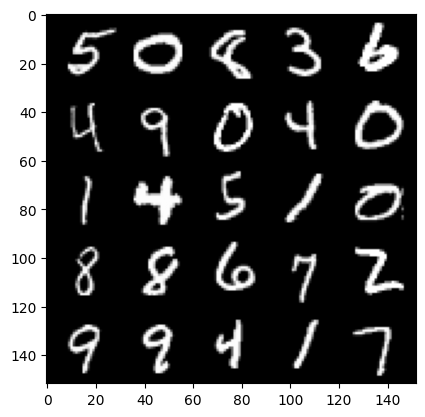

 65%|██████▌   | 305/469 [00:07<00:04, 38.63it/s]

Step 12500: Generator loss: 3.9404711060523976, discriminator loss: 0.08681443843245507


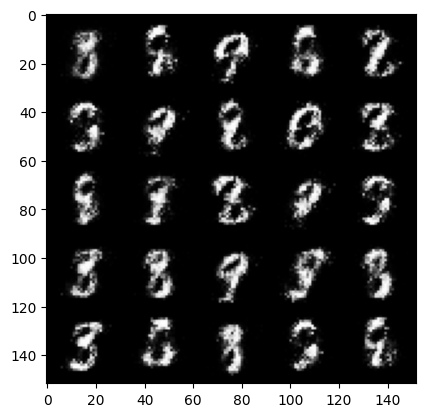

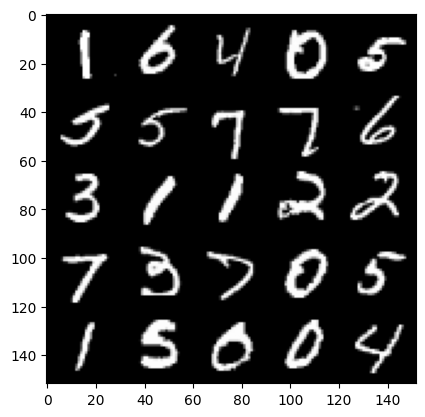

 72%|███████▏  | 337/469 [00:08<00:03, 39.89it/s]

Step 13000: Generator loss: 3.7890512423515306, discriminator loss: 0.08599355907738211


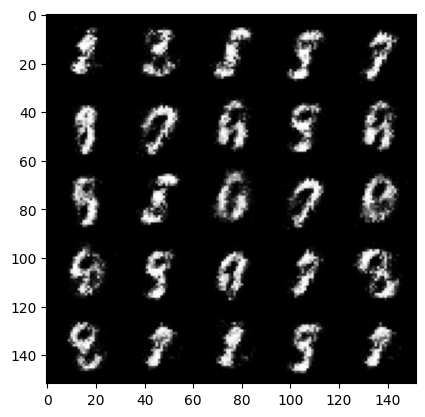

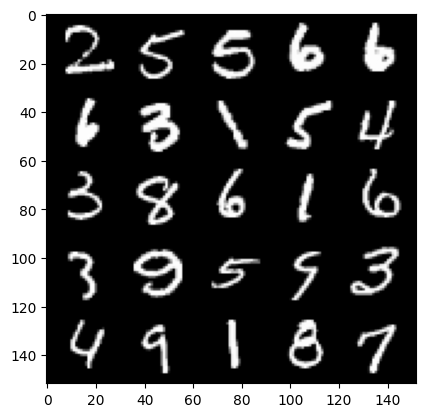

 78%|███████▊  | 366/469 [00:09<00:02, 36.44it/s]

Step 13500: Generator loss: 3.6846229109764095, discriminator loss: 0.08766919957101346


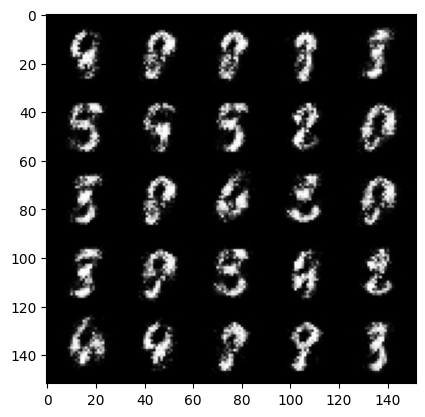

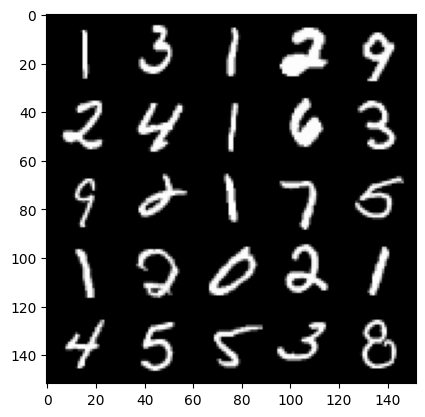

 85%|████████▍ | 398/469 [00:10<00:01, 40.20it/s]

Step 14000: Generator loss: 3.828131289482117, discriminator loss: 0.09228638575226061


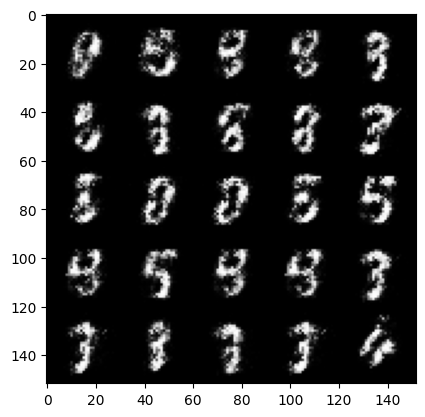

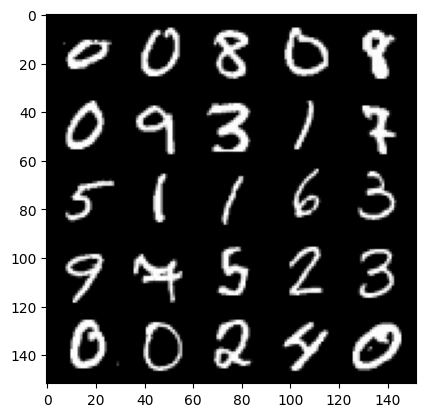

 91%|█████████▏| 429/469 [00:10<00:01, 38.38it/s]

Step 14500: Generator loss: 3.8910886373519933, discriminator loss: 0.09448338219523426


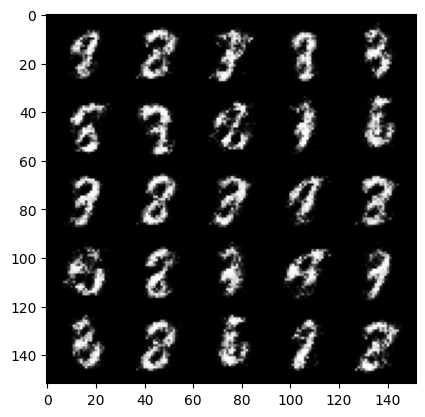

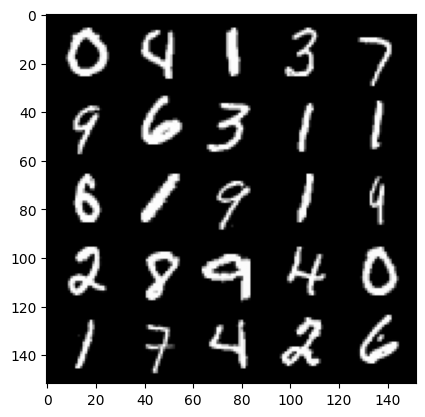

 98%|█████████▊| 460/469 [00:11<00:00, 37.79it/s]

Step 15000: Generator loss: 3.918056206703187, discriminator loss: 0.0936488502547144


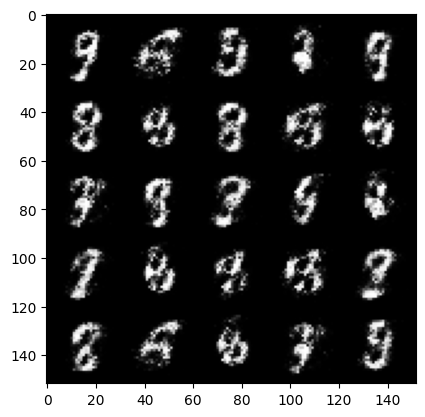

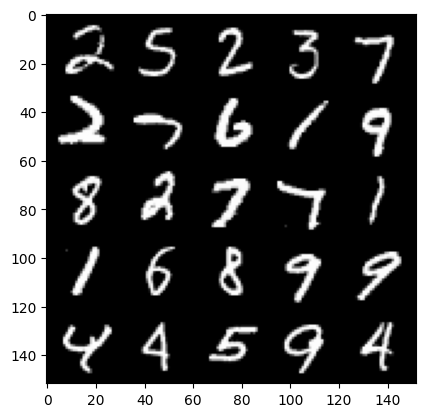

  4%|▍         | 21/469 [00:00<00:11, 37.38it/s]

Step 15500: Generator loss: 3.8600407080650374, discriminator loss: 0.09645922537893058


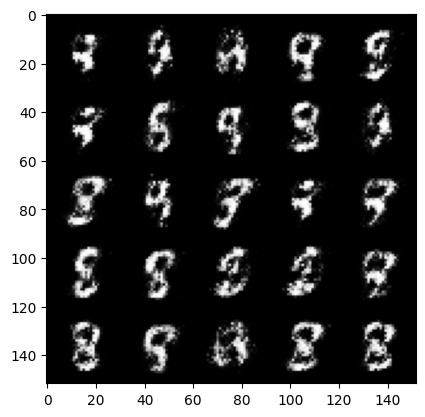

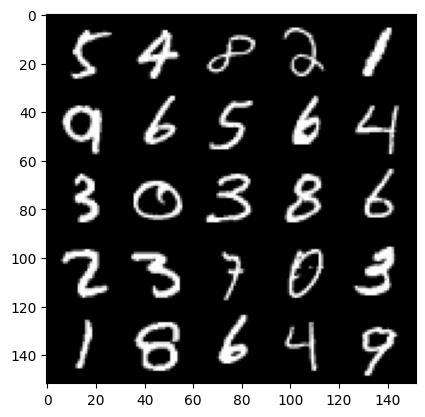

 11%|█         | 52/469 [00:01<00:11, 36.55it/s]

Step 16000: Generator loss: 3.61276899433136, discriminator loss: 0.11987900276482095


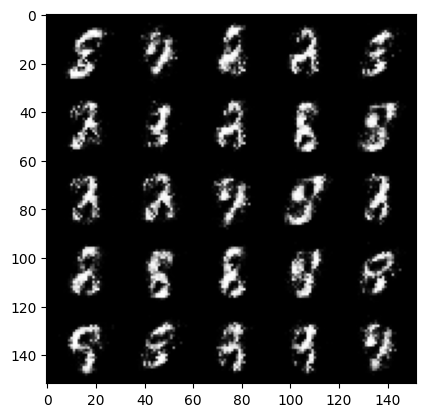

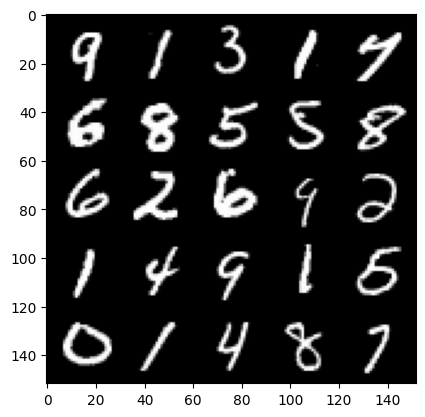

 17%|█▋        | 82/469 [00:02<00:10, 38.19it/s]

Step 16500: Generator loss: 3.7835607905387865, discriminator loss: 0.11149156765639776


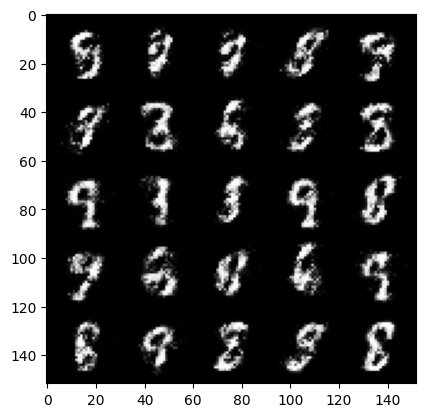

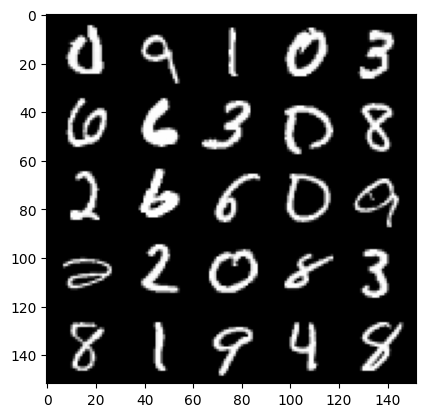

 24%|██▍       | 113/469 [00:02<00:08, 40.00it/s]

Step 17000: Generator loss: 3.865853620529174, discriminator loss: 0.10833960158377881


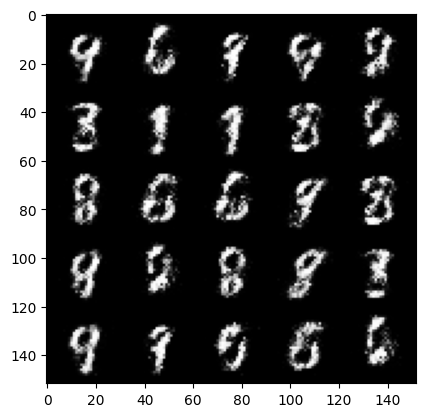

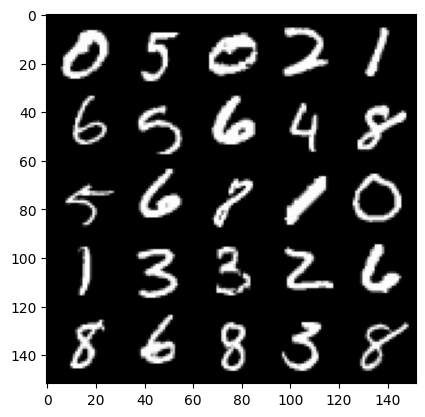

 31%|███▏      | 147/469 [00:03<00:08, 39.19it/s]

Step 17500: Generator loss: 3.657805702686311, discriminator loss: 0.12308465623110536


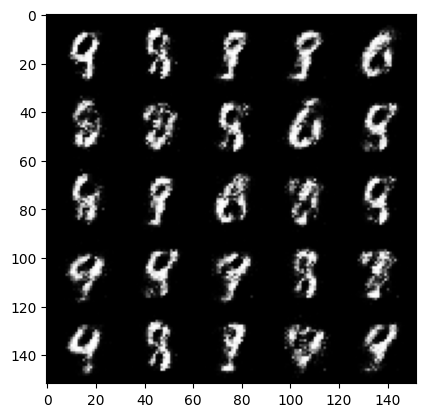

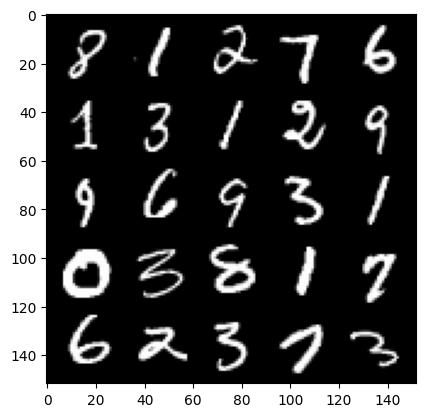

 38%|███▊      | 178/469 [00:04<00:07, 39.56it/s]

Step 18000: Generator loss: 3.648511924266815, discriminator loss: 0.12758364887535573


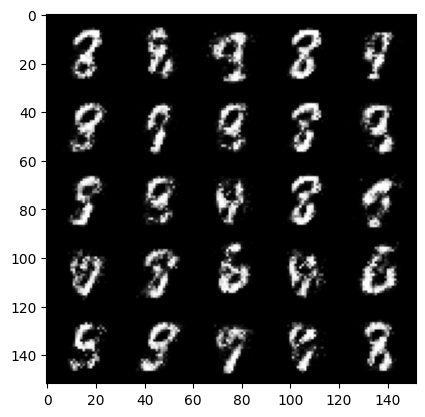

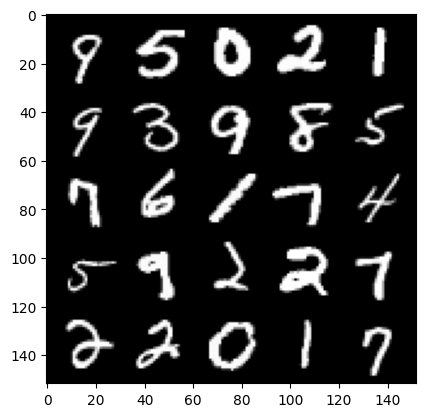

 44%|████▎     | 205/469 [00:05<00:06, 38.77it/s]

Step 18500: Generator loss: 3.6307796130180368, discriminator loss: 0.14488275121152394


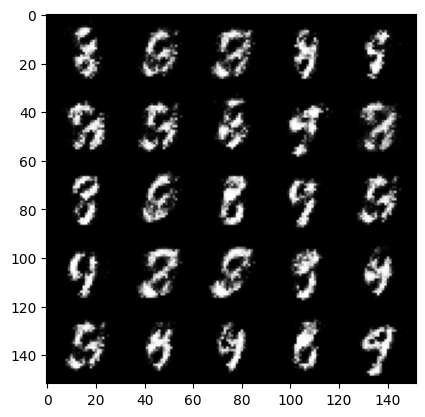

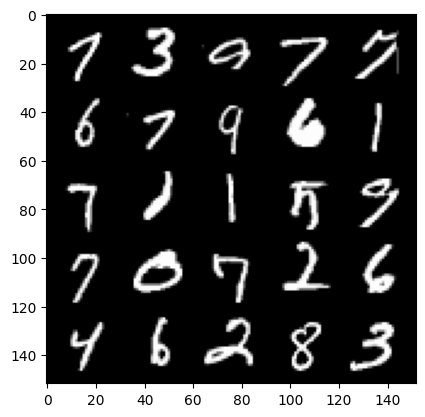

 51%|█████     | 237/469 [00:06<00:06, 38.38it/s]

Step 19000: Generator loss: 3.486879043579104, discriminator loss: 0.13270050268620237


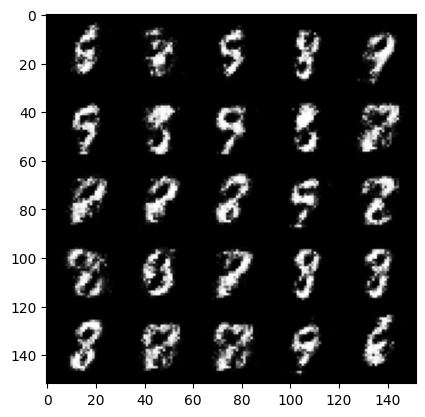

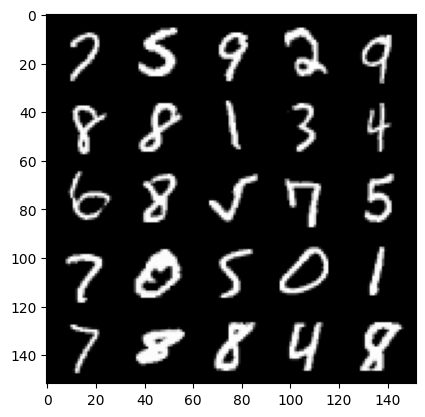

 58%|█████▊    | 270/469 [00:06<00:05, 38.48it/s]

Step 19500: Generator loss: 3.513264094829561, discriminator loss: 0.1398895150721074


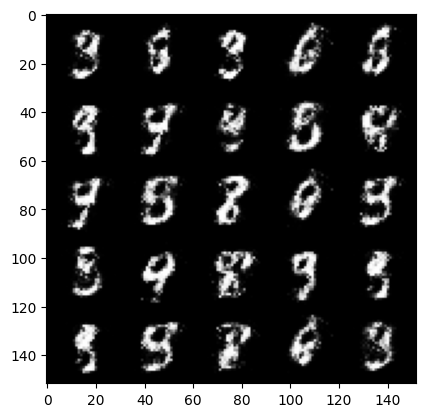

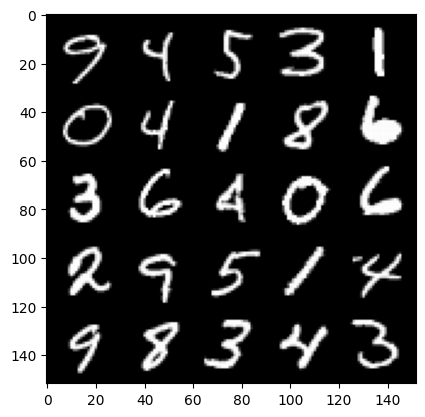

 64%|██████▎   | 298/469 [00:07<00:04, 40.14it/s]

Step 20000: Generator loss: 3.508959066867824, discriminator loss: 0.16045628598332393


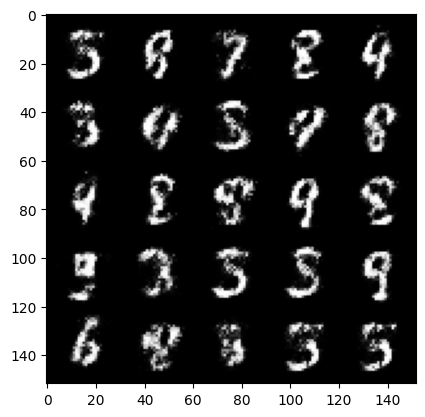

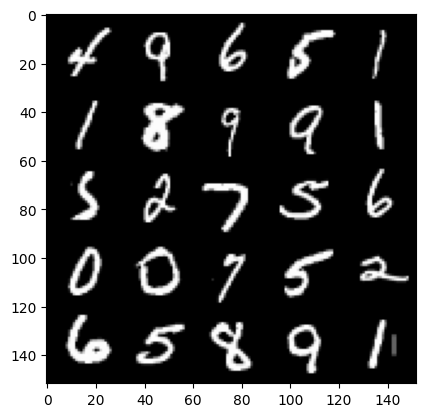

 71%|███████   | 332/469 [00:08<00:03, 39.19it/s]

Step 20500: Generator loss: 3.4308215847015378, discriminator loss: 0.16992378416657425


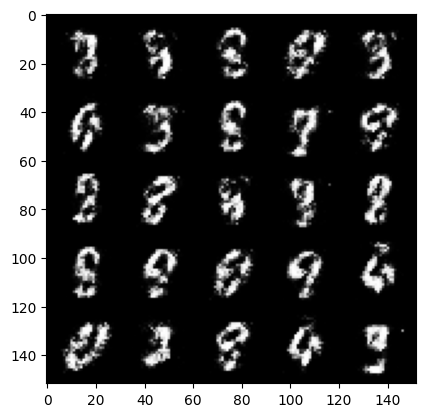

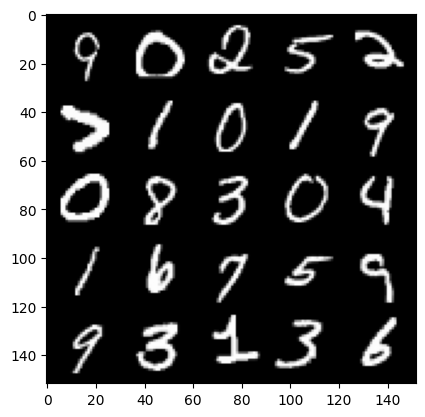

 77%|███████▋  | 362/469 [00:09<00:02, 39.41it/s]

Step 21000: Generator loss: 3.410557319641112, discriminator loss: 0.164782396569848


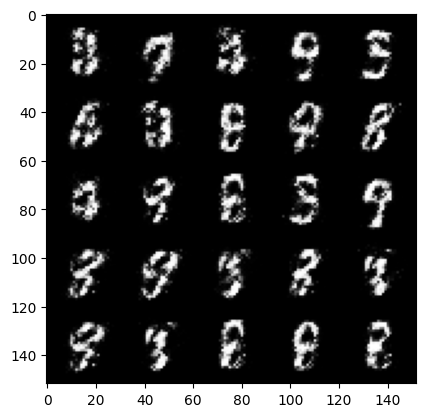

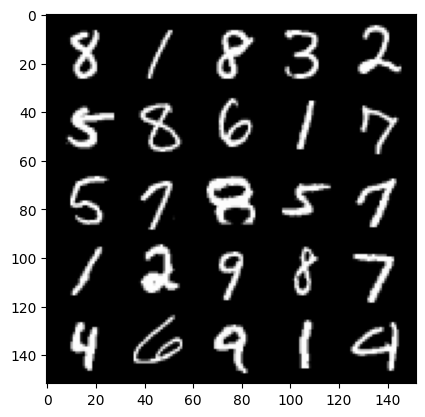

 84%|████████▍ | 393/469 [00:09<00:01, 40.05it/s]

Step 21500: Generator loss: 3.362111229896548, discriminator loss: 0.1571438020467759


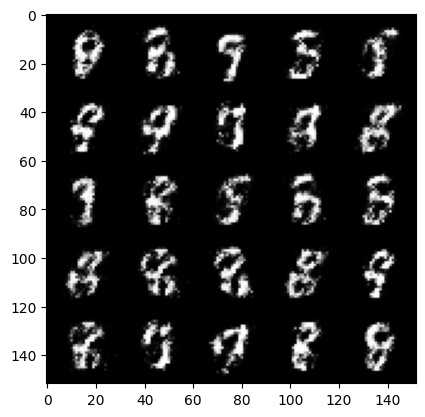

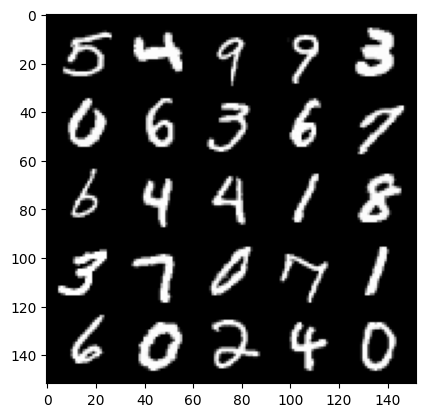

 91%|█████████ | 426/469 [00:11<00:01, 38.46it/s]

Step 22000: Generator loss: 3.2271568231582632, discriminator loss: 0.1899552656412127


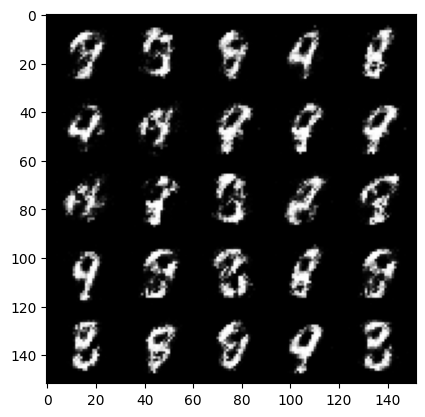

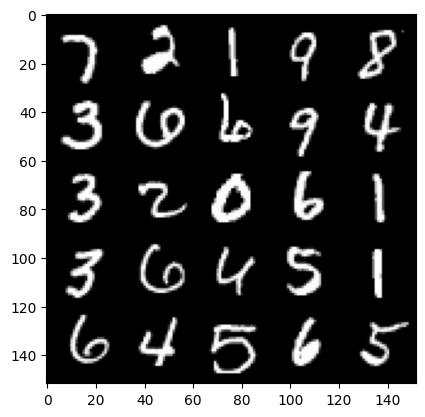

 97%|█████████▋| 454/469 [00:11<00:00, 39.94it/s]

Step 22500: Generator loss: 3.062668996810912, discriminator loss: 0.202773400962353


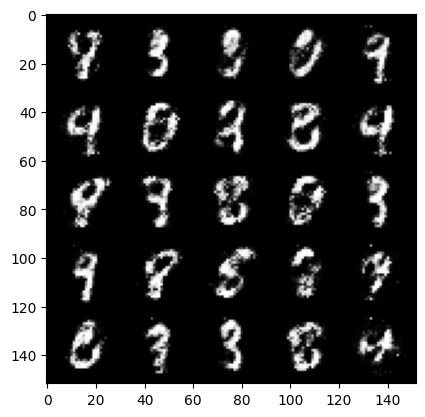

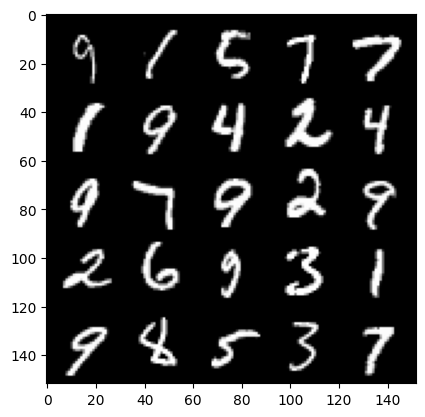

  3%|▎         | 16/469 [00:00<00:12, 36.51it/s]

Step 23000: Generator loss: 2.9574232339859, discriminator loss: 0.20786253380775466


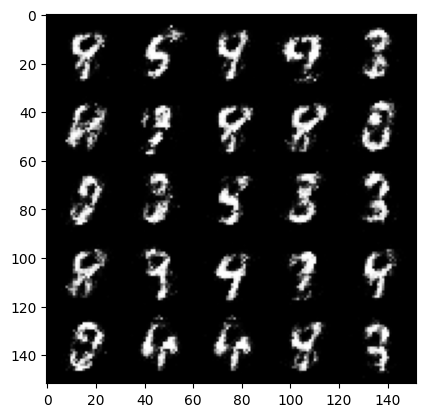

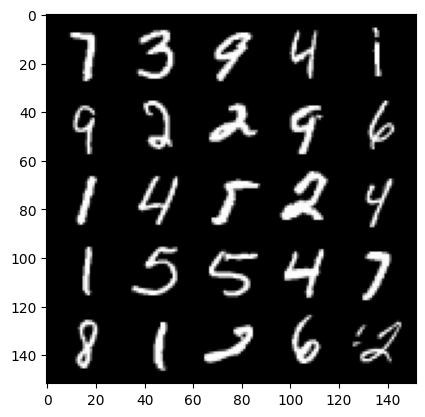

 10%|█         | 47/469 [00:01<00:10, 38.45it/s]

Step 23500: Generator loss: 3.0632640604972856, discriminator loss: 0.1814341157227756


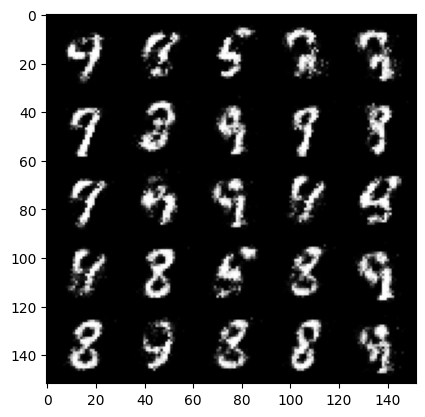

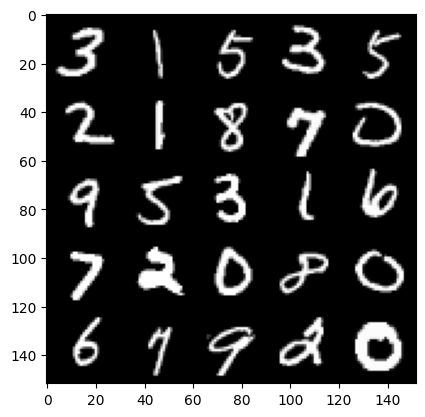

 17%|█▋        | 81/469 [00:02<00:10, 37.11it/s]

Step 24000: Generator loss: 2.9405578479766823, discriminator loss: 0.20870978674292565


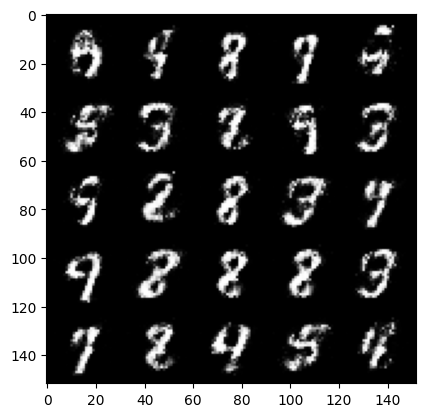

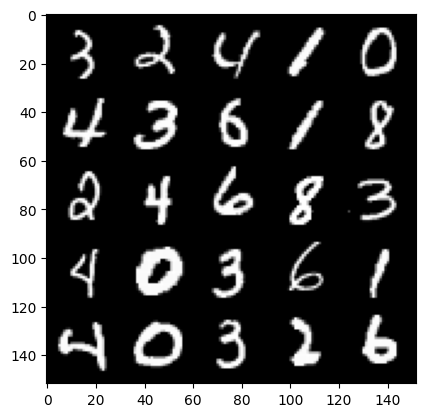

 23%|██▎       | 109/469 [00:02<00:09, 38.41it/s]

Step 24500: Generator loss: 2.83772673559189, discriminator loss: 0.20204021665453892


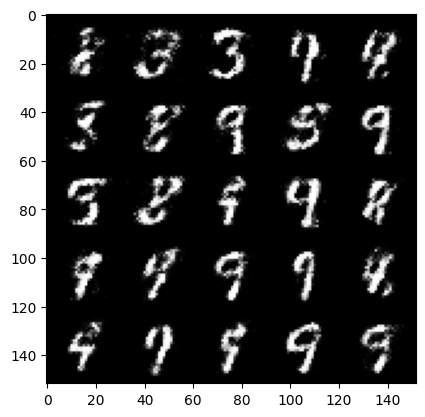

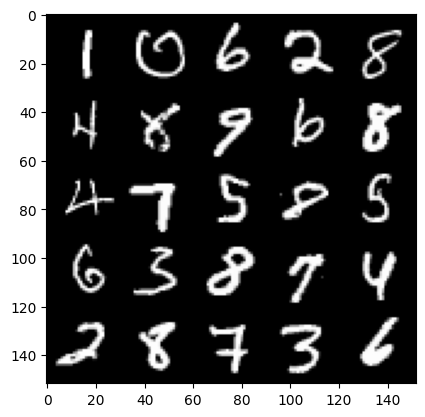

 30%|███       | 141/469 [00:03<00:08, 39.24it/s]

Step 25000: Generator loss: 2.950832222461701, discriminator loss: 0.18962498202919958


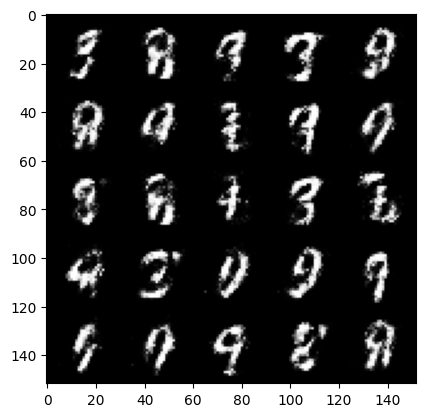

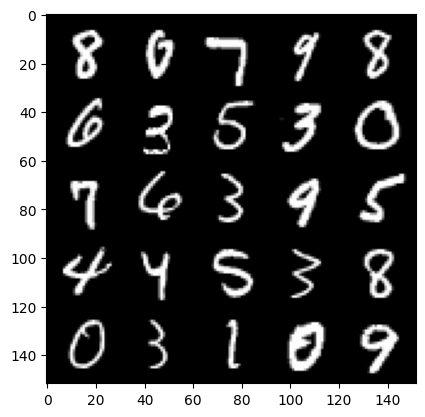

 37%|███▋      | 173/469 [00:04<00:07, 37.98it/s]

Step 25500: Generator loss: 2.968175625324252, discriminator loss: 0.18674183751642706


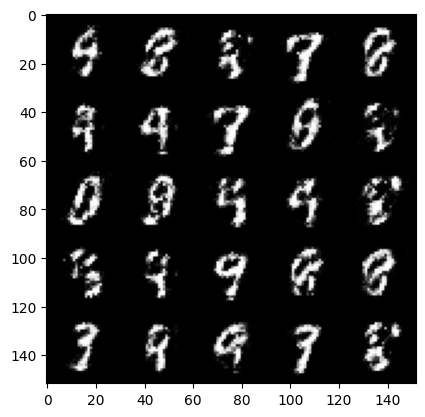

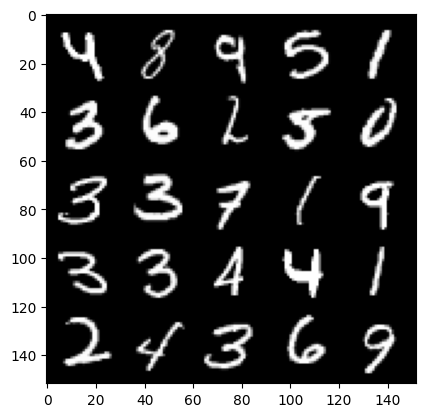

 43%|████▎     | 202/469 [00:05<00:07, 36.81it/s]

Step 26000: Generator loss: 3.040915251731871, discriminator loss: 0.1809506868869065


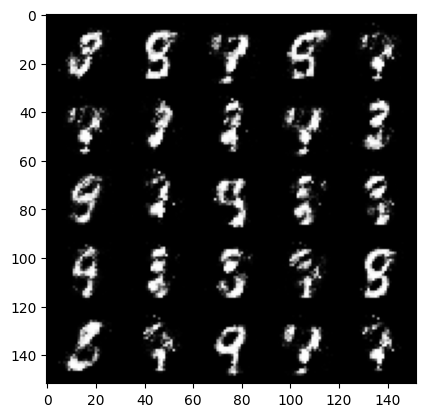

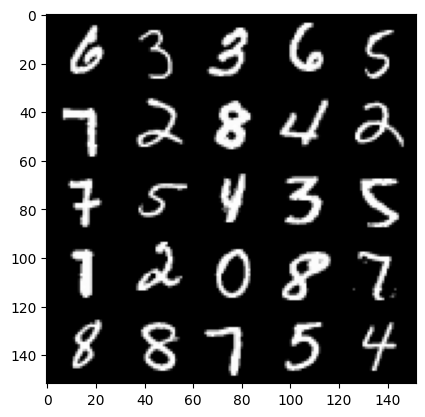

 50%|████▉     | 234/469 [00:06<00:06, 35.55it/s]

Step 26500: Generator loss: 3.1284450931549106, discriminator loss: 0.19027606768906122


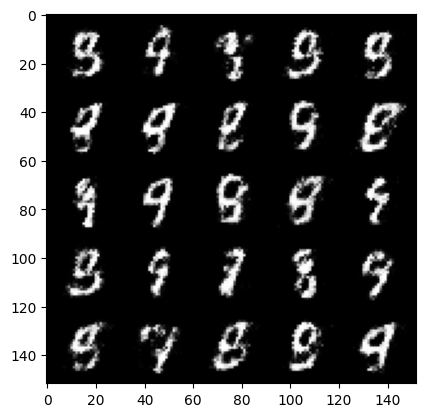

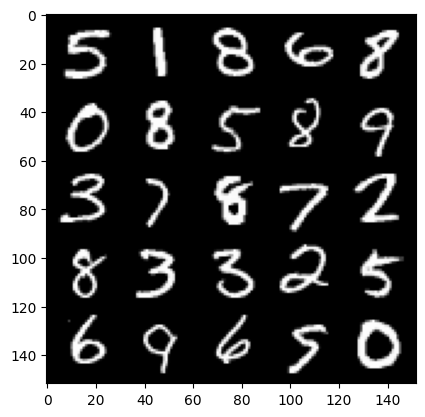

 57%|█████▋    | 266/469 [00:06<00:05, 37.40it/s]

Step 27000: Generator loss: 2.929013353347775, discriminator loss: 0.20250437618792058


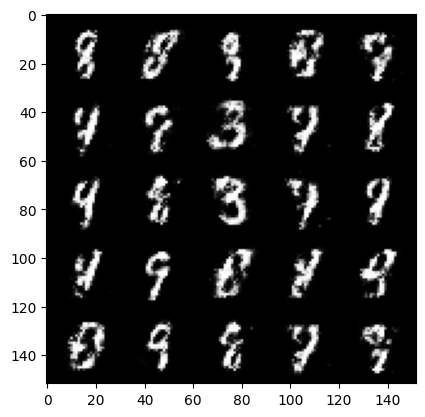

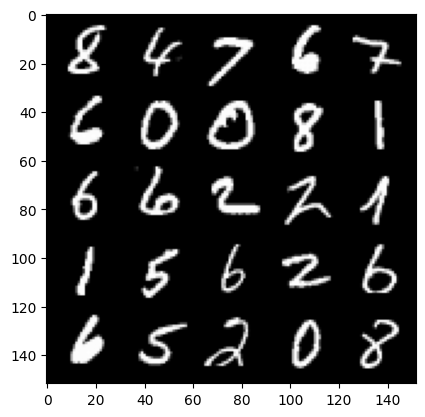

 63%|██████▎   | 297/469 [00:08<00:04, 37.87it/s]

Step 27500: Generator loss: 2.9013926444053646, discriminator loss: 0.21120187884569172


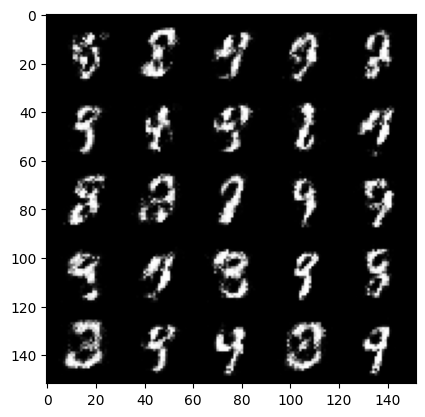

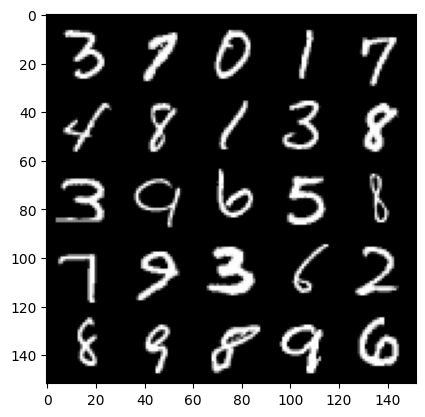

 70%|██████▉   | 326/469 [00:08<00:03, 37.48it/s]

Step 28000: Generator loss: 2.7730124549865725, discriminator loss: 0.22299344584345818


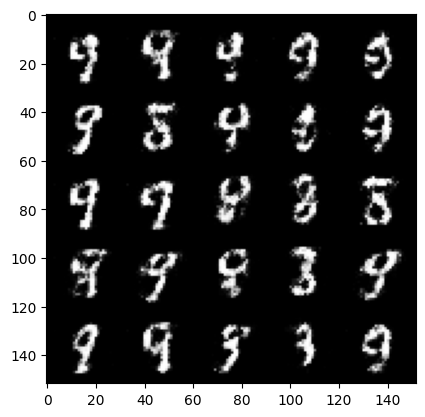

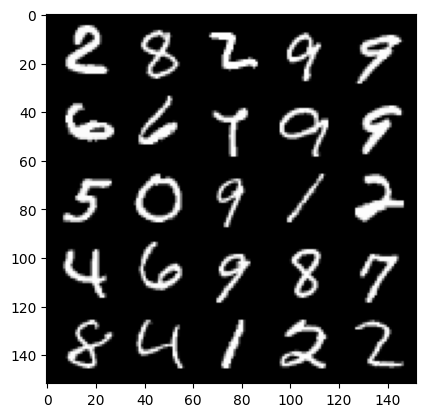

 76%|███████▌  | 357/469 [00:09<00:02, 37.49it/s]

Step 28500: Generator loss: 2.7706953177452087, discriminator loss: 0.20719339272379866


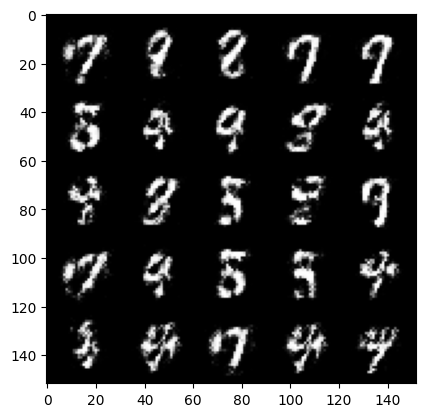

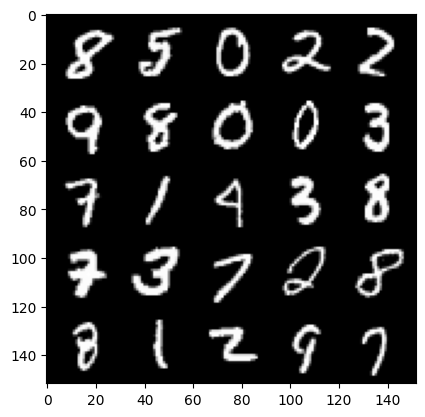

 83%|████████▎ | 390/469 [00:10<00:02, 38.66it/s]

Step 29000: Generator loss: 2.7007913866043074, discriminator loss: 0.21522564938664435


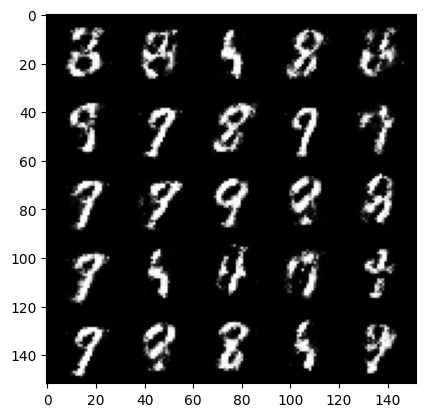

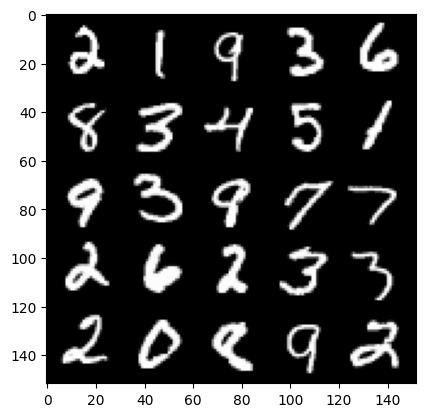

 89%|████████▉ | 419/469 [00:11<00:01, 37.39it/s]

Step 29500: Generator loss: 2.7753890333175666, discriminator loss: 0.2207754121124744


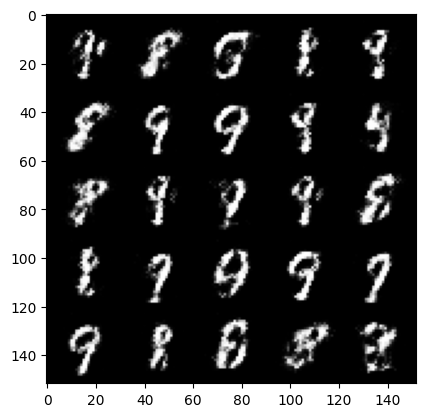

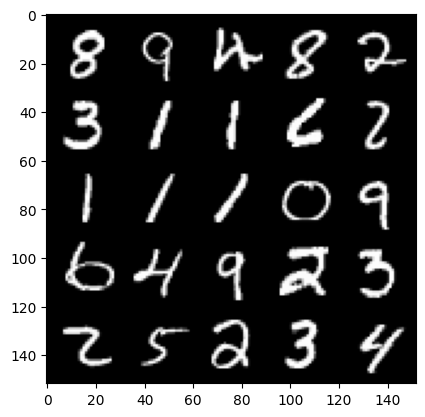

 96%|█████████▌| 451/469 [00:11<00:00, 38.76it/s]

Step 30000: Generator loss: 2.5698116016387935, discriminator loss: 0.24720734474062928


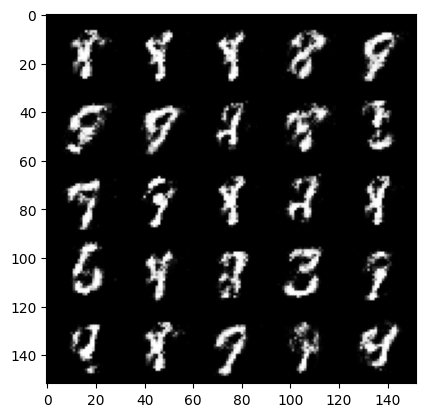

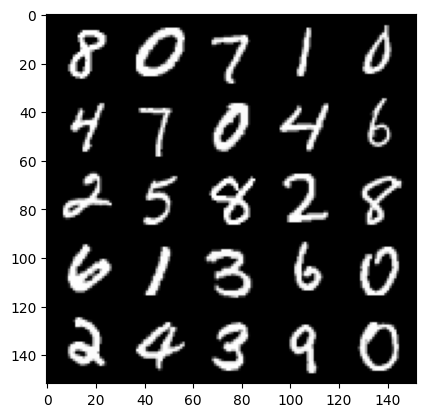

  3%|▎         | 12/469 [00:00<00:13, 34.96it/s]

Step 30500: Generator loss: 2.5534510889053315, discriminator loss: 0.25115226218104364


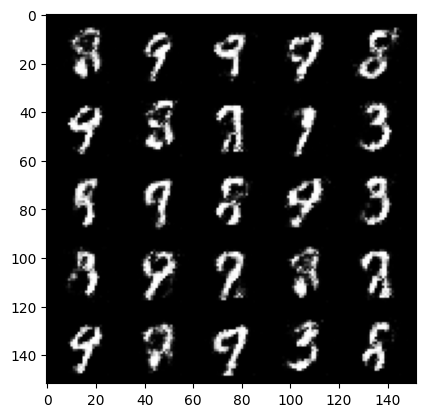

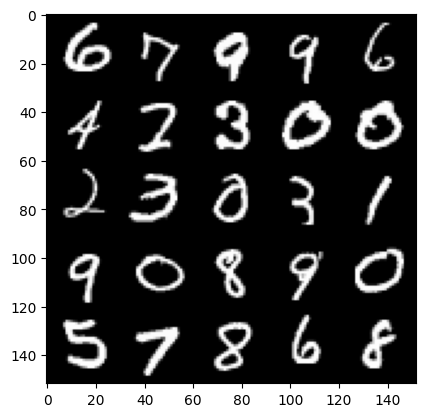

  9%|▉         | 44/469 [00:01<00:11, 37.79it/s]

Step 31000: Generator loss: 2.4692673499584186, discriminator loss: 0.2757672348022459


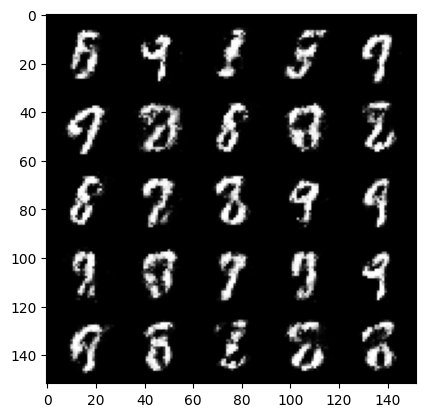

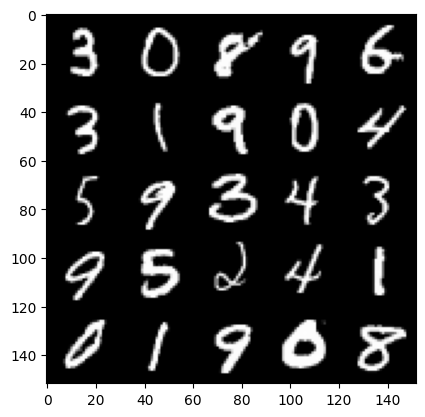

 16%|█▌        | 75/469 [00:01<00:10, 39.22it/s]

Step 31500: Generator loss: 2.4664916672706587, discriminator loss: 0.26308696317672753


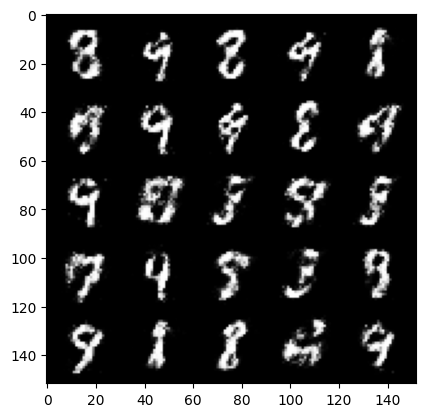

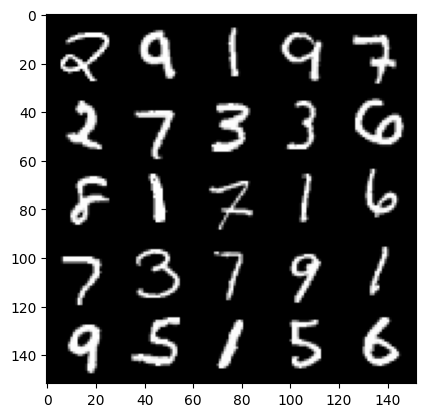

 23%|██▎       | 108/469 [00:03<00:09, 36.42it/s]

Step 32000: Generator loss: 2.3832359092235564, discriminator loss: 0.2738271289467809


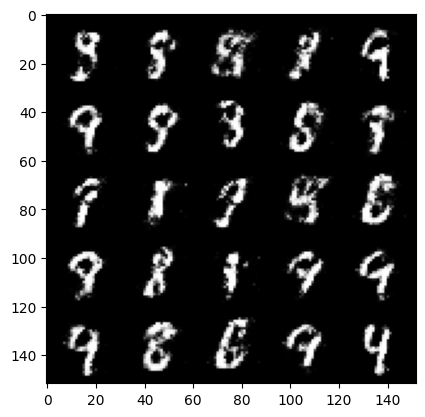

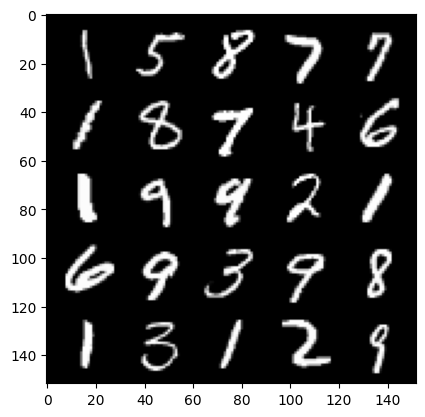

 29%|██▉       | 138/469 [00:03<00:08, 36.99it/s]

Step 32500: Generator loss: 2.515193979263307, discriminator loss: 0.25063496209681035


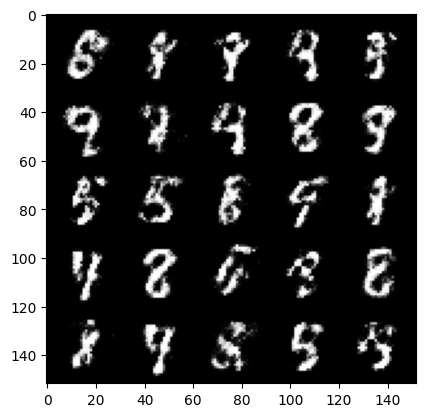

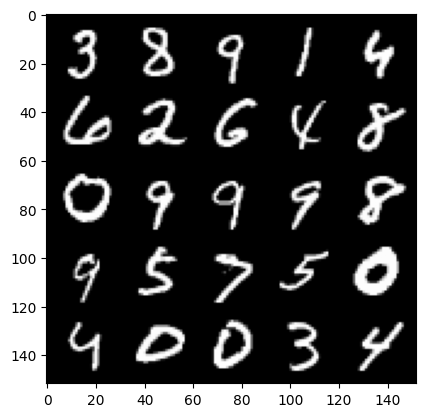

 36%|███▌      | 167/469 [00:04<00:07, 38.49it/s]

Step 33000: Generator loss: 2.41195658612251, discriminator loss: 0.2668676262795924


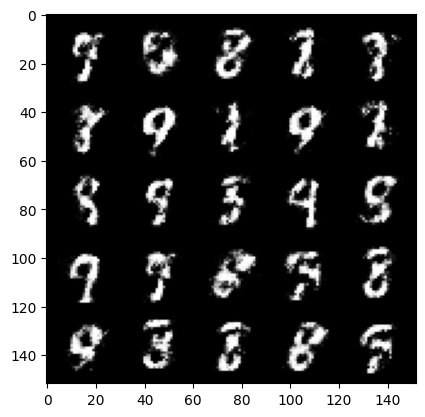

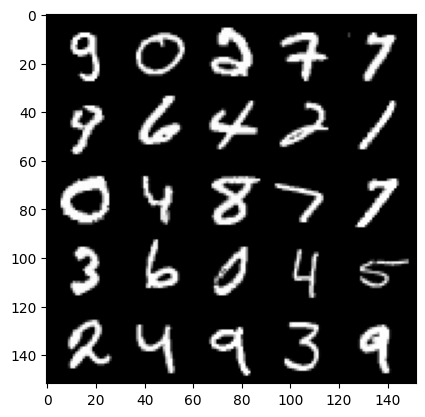

 43%|████▎     | 201/469 [00:05<00:06, 38.96it/s]

Step 33500: Generator loss: 2.44131725645065, discriminator loss: 0.26248234924674047


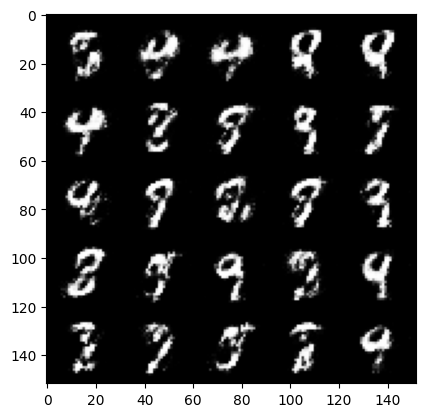

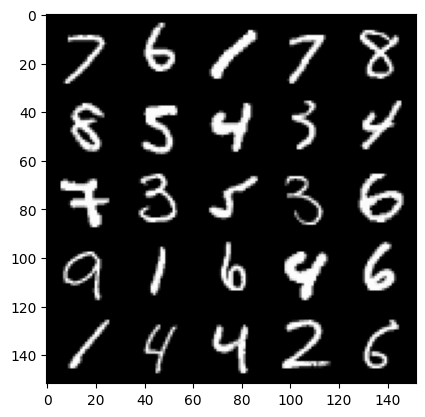

 49%|████▉     | 232/469 [00:06<00:06, 39.20it/s]

Step 34000: Generator loss: 2.381310889959336, discriminator loss: 0.27586008745431917


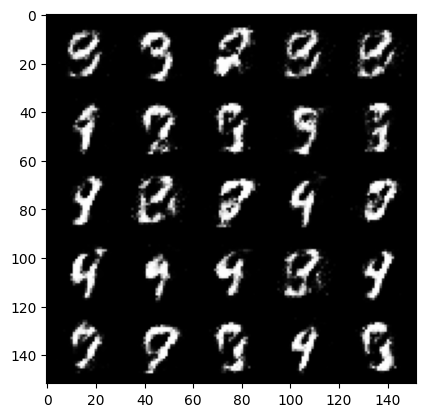

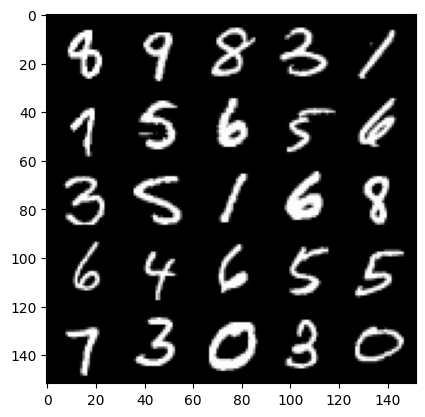

 55%|█████▌    | 260/469 [00:06<00:05, 38.92it/s]

Step 34500: Generator loss: 2.2997226166725153, discriminator loss: 0.27621127927303296


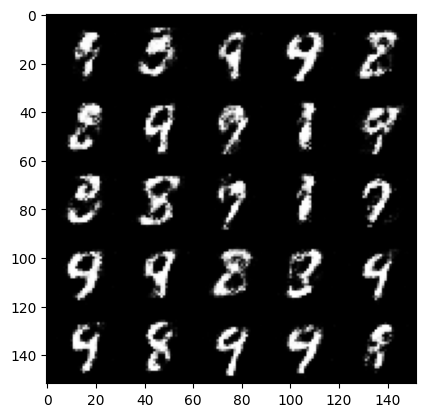

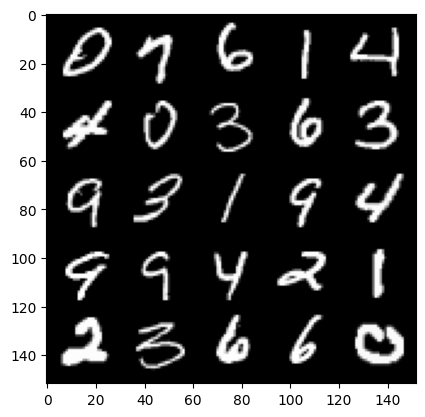

 62%|██████▏   | 291/469 [00:07<00:04, 38.11it/s]

Step 35000: Generator loss: 2.3867838377952566, discriminator loss: 0.25543400186300286


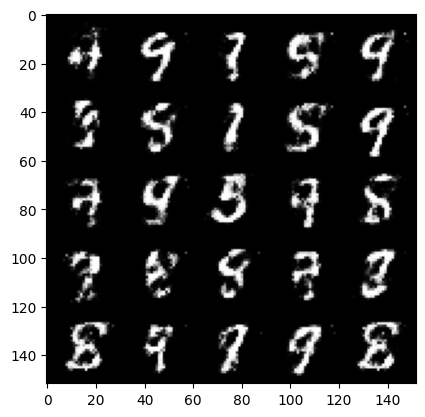

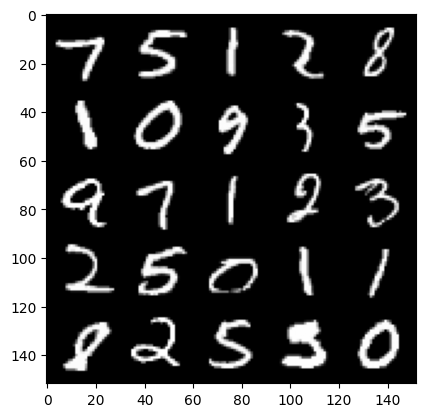

 69%|██████▊   | 322/469 [00:08<00:03, 38.62it/s]

Step 35500: Generator loss: 2.349398104667664, discriminator loss: 0.27590059682726886


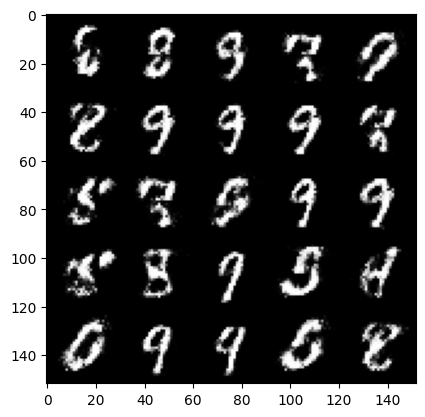

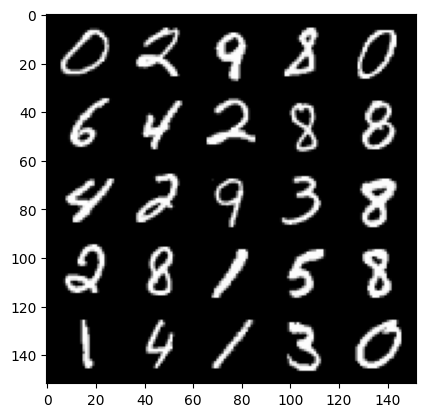

 76%|███████▌  | 356/469 [00:09<00:02, 38.57it/s]

Step 36000: Generator loss: 2.3836982595920553, discriminator loss: 0.25966200879216184


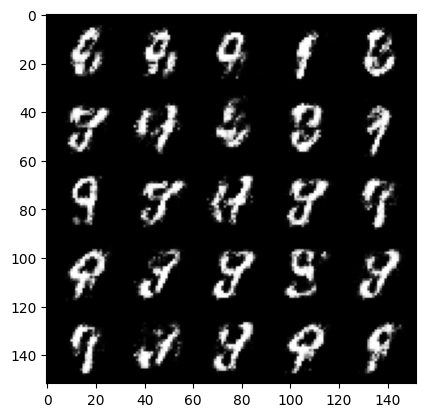

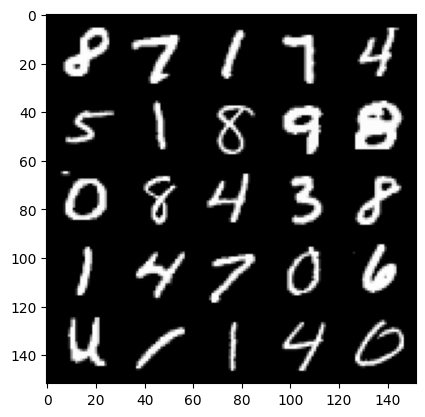

 82%|████████▏ | 386/469 [00:09<00:02, 39.00it/s]

Step 36500: Generator loss: 2.225195165634155, discriminator loss: 0.30047099530696886


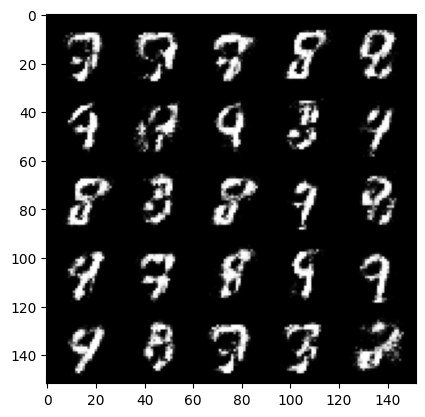

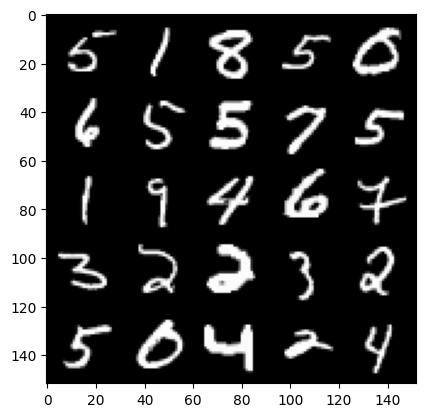

 89%|████████▉ | 417/469 [00:10<00:01, 38.00it/s]

Step 37000: Generator loss: 2.2993635830879184, discriminator loss: 0.29987666746974


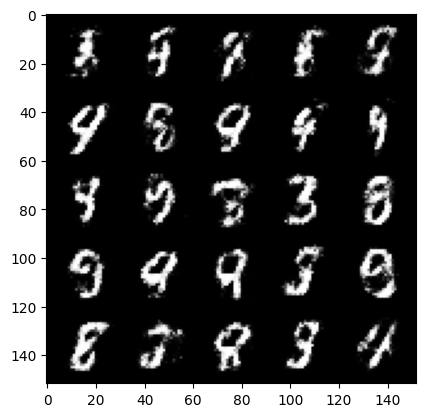

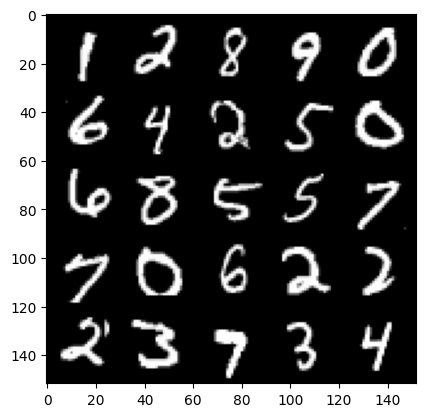

 95%|█████████▌| 447/469 [00:11<00:00, 39.54it/s]

Step 37500: Generator loss: 2.2668215432167047, discriminator loss: 0.300064894556999


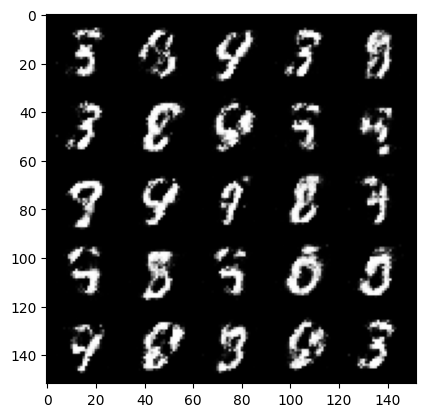

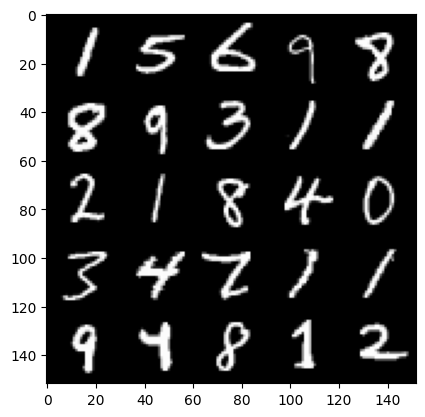

  2%|▏         | 11/469 [00:00<00:13, 33.89it/s]

Step 38000: Generator loss: 2.1640716772079456, discriminator loss: 0.30552015584707265


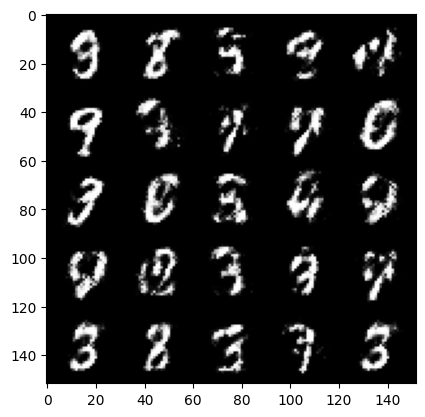

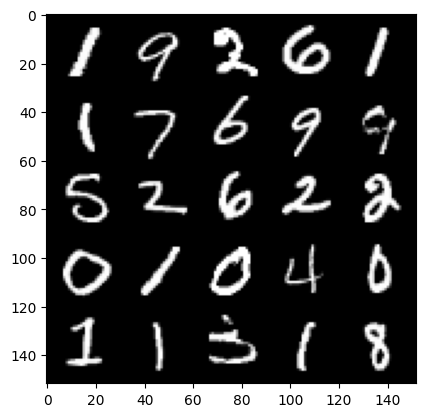

  9%|▊         | 40/469 [00:01<00:11, 38.57it/s]

Step 38500: Generator loss: 2.330380769252775, discriminator loss: 0.26951536837220197


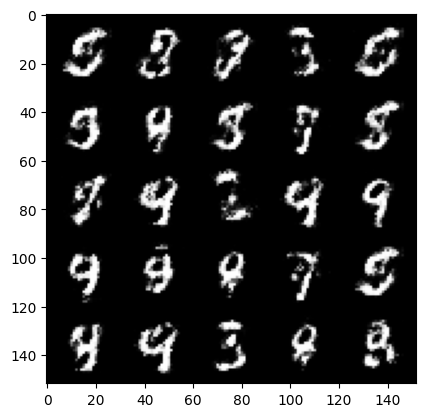

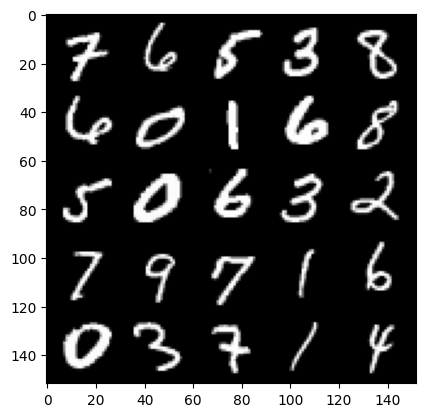

 16%|█▌        | 73/469 [00:01<00:10, 39.12it/s]

Step 39000: Generator loss: 2.3836957888603205, discriminator loss: 0.268798879265785


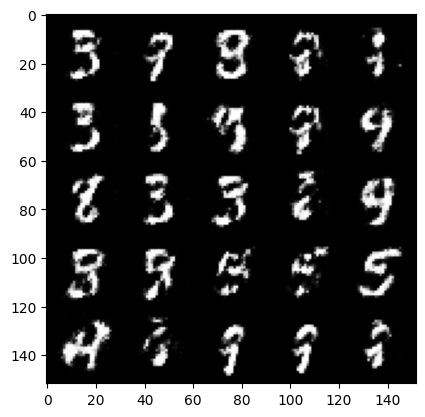

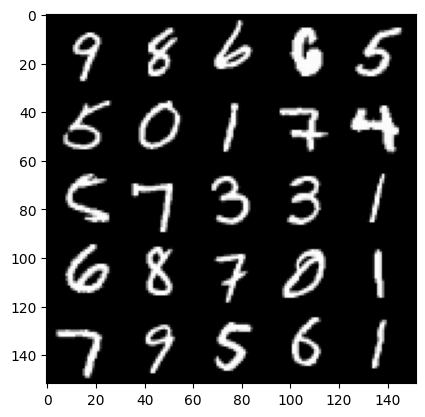

 22%|██▏       | 103/469 [00:02<00:09, 39.53it/s]

Step 39500: Generator loss: 2.1903162968158703, discriminator loss: 0.30383014062047026


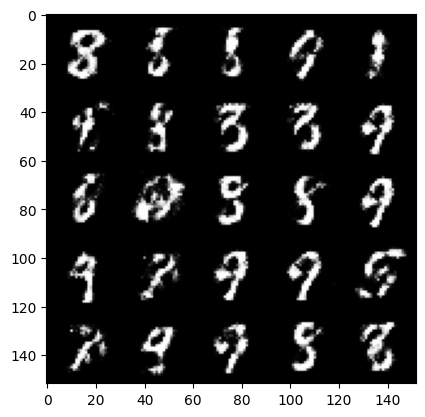

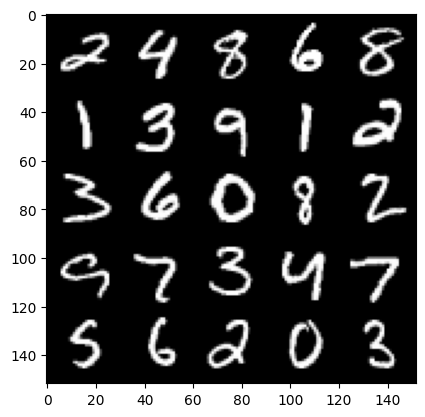

 29%|██▊       | 134/469 [00:03<00:08, 38.32it/s]

Step 40000: Generator loss: 2.066888485431671, discriminator loss: 0.32388423588871934


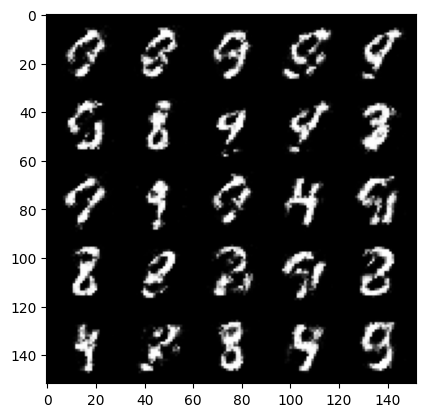

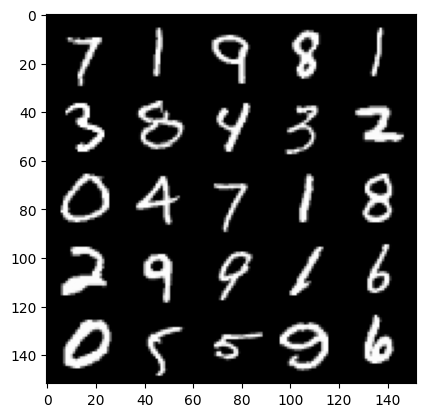

 35%|███▍      | 164/469 [00:04<00:07, 38.17it/s]

Step 40500: Generator loss: 2.179074529170989, discriminator loss: 0.29720476484298686


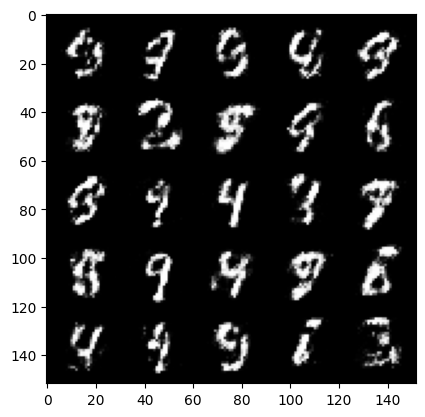

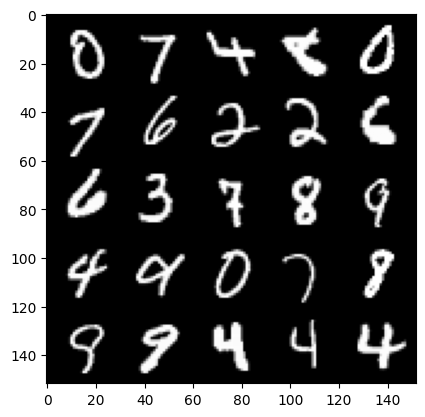

 42%|████▏     | 196/469 [00:05<00:06, 39.07it/s]

Step 41000: Generator loss: 2.0828382468223583, discriminator loss: 0.32568347889184956


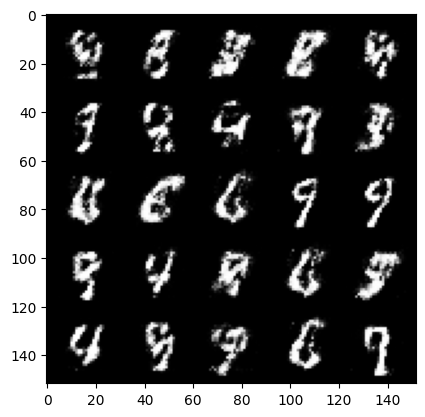

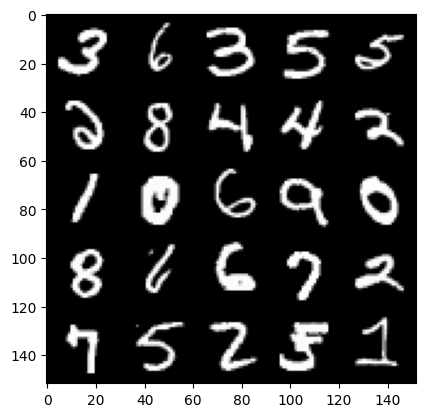

 48%|████▊     | 226/469 [00:05<00:06, 38.62it/s]

Step 41500: Generator loss: 2.1415261268615726, discriminator loss: 0.30812003368139296


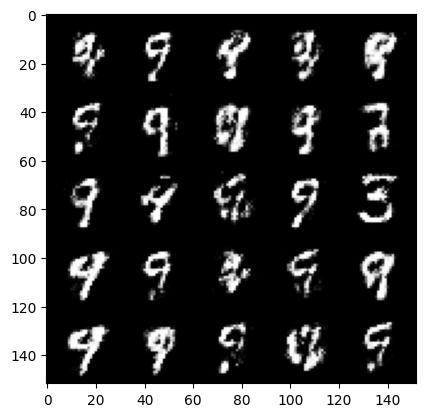

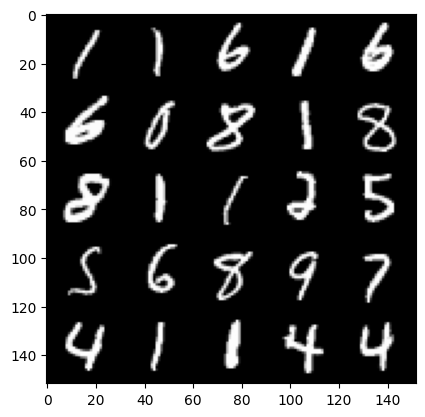

 54%|█████▍    | 255/469 [00:06<00:05, 39.77it/s]

Step 42000: Generator loss: 2.162827856779099, discriminator loss: 0.3124856586158275


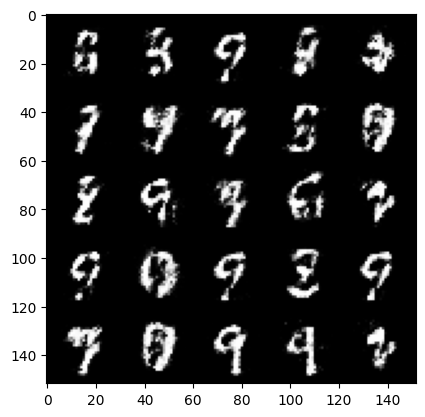

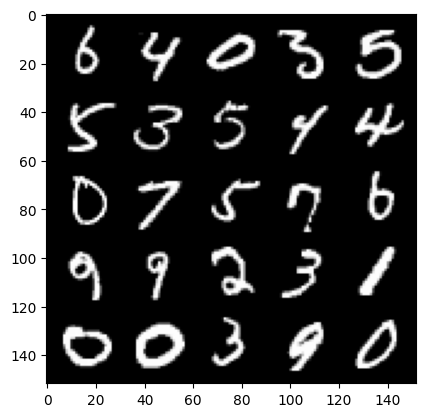

 61%|██████▏   | 288/469 [00:07<00:04, 38.91it/s]

Step 42500: Generator loss: 2.102890125751496, discriminator loss: 0.315596085757017


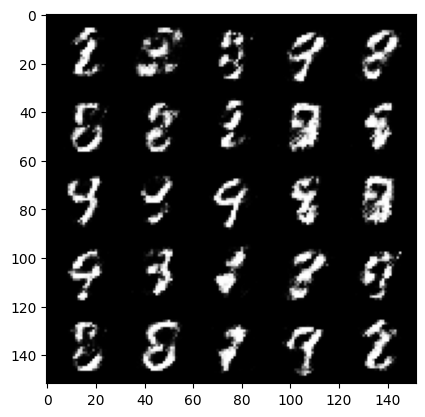

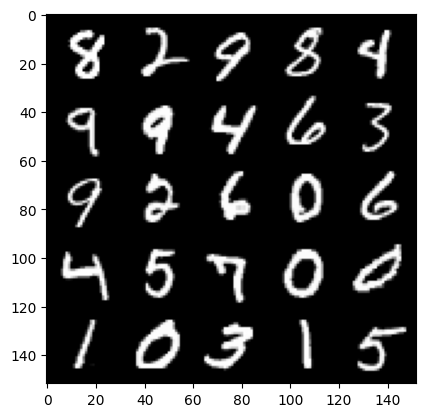

 68%|██████▊   | 317/469 [00:08<00:03, 38.09it/s]

Step 43000: Generator loss: 2.160071523427962, discriminator loss: 0.29941004461050047


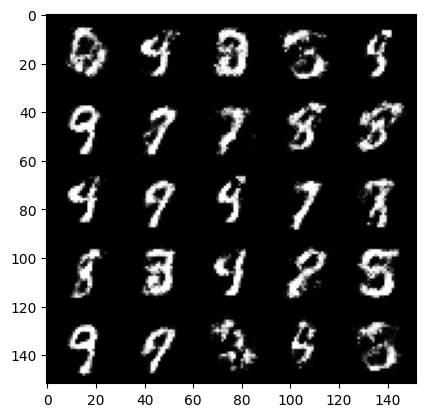

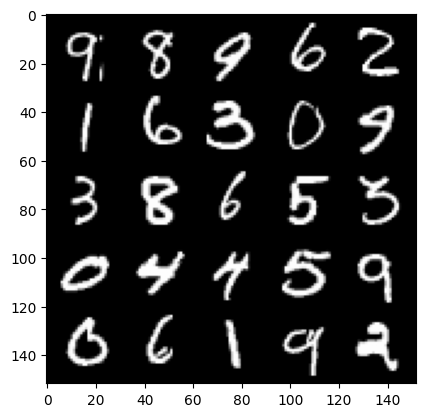

 74%|███████▍  | 349/469 [00:09<00:03, 37.88it/s]

Step 43500: Generator loss: 2.0458915710449226, discriminator loss: 0.32565664869546895


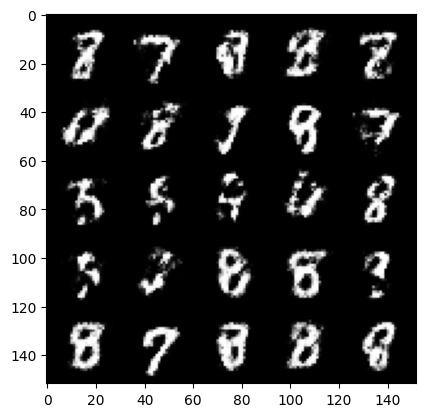

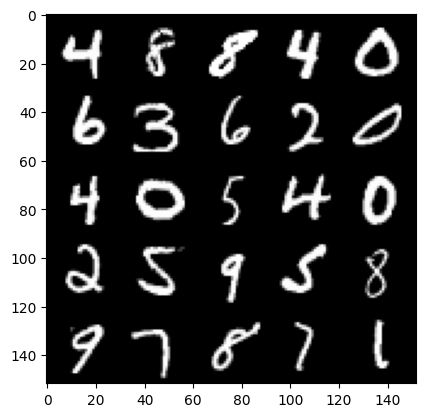

 81%|████████  | 380/469 [00:09<00:02, 39.71it/s]

Step 44000: Generator loss: 1.9640689480304727, discriminator loss: 0.3485105592310428


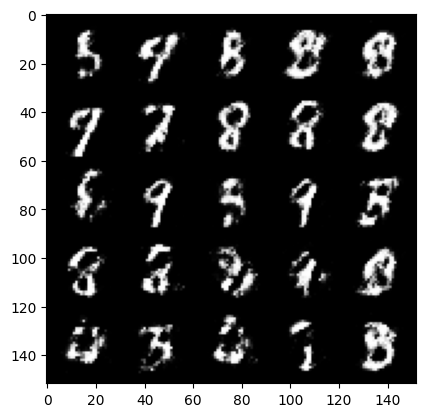

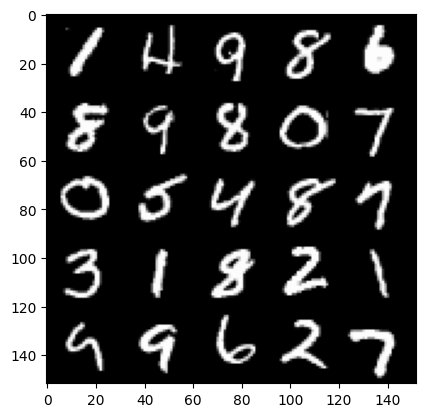

 88%|████████▊ | 414/469 [00:10<00:01, 39.24it/s]

Step 44500: Generator loss: 1.906326608896255, discriminator loss: 0.35279578536748896


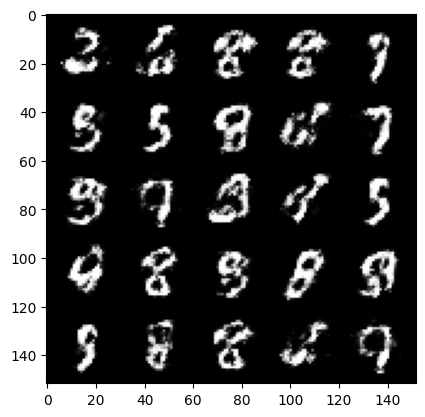

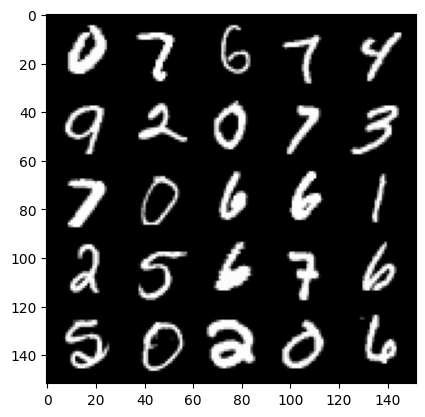

 95%|█████████▍| 444/469 [00:11<00:00, 38.93it/s]

Step 45000: Generator loss: 1.8893666419982917, discriminator loss: 0.36459380859136536


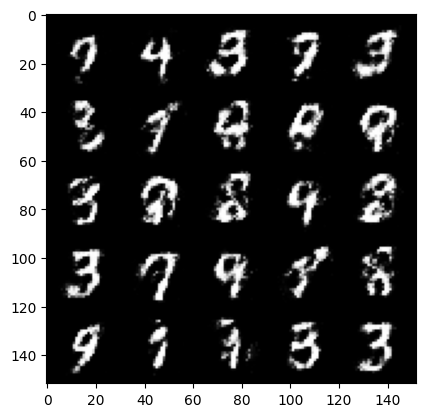

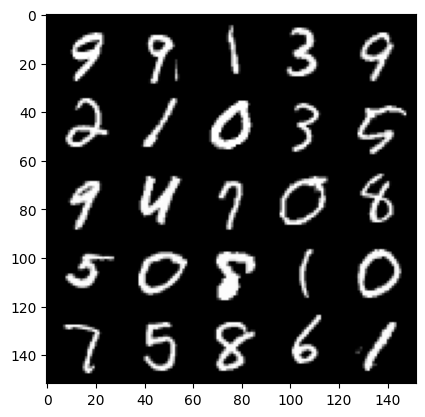

  1%|          | 4/469 [00:00<00:14, 31.88it/s]

Step 45500: Generator loss: 1.9337146613597889, discriminator loss: 0.34763325679302254


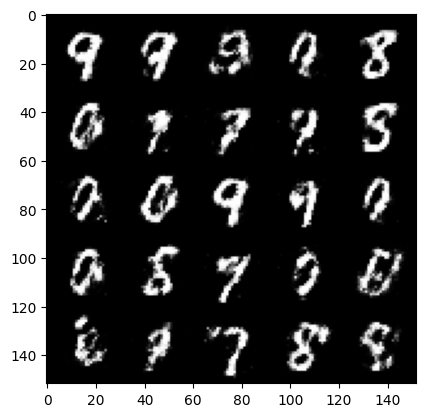

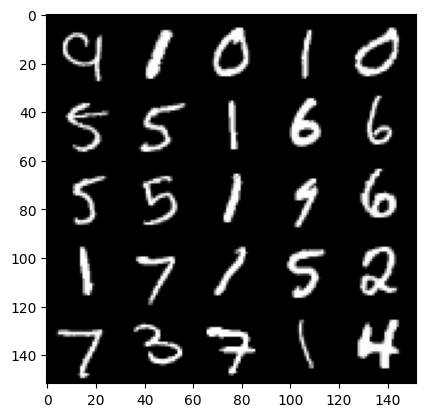

  8%|▊         | 37/469 [00:00<00:11, 38.10it/s]

Step 46000: Generator loss: 1.9441494514942177, discriminator loss: 0.340607700675726


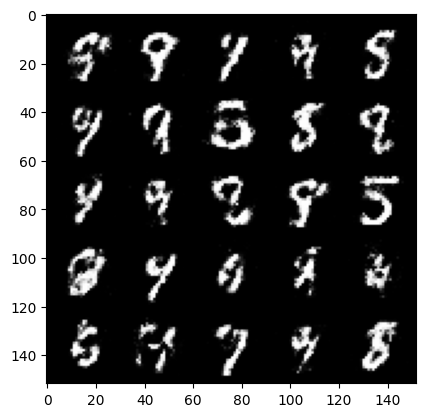

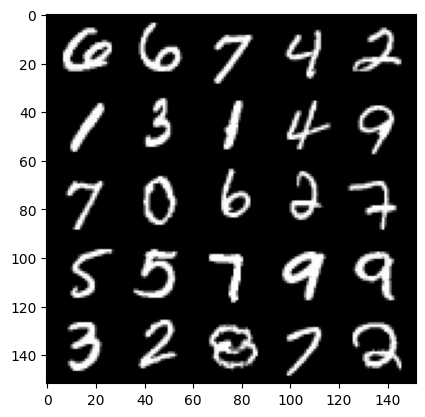

 14%|█▍        | 66/469 [00:01<00:10, 38.13it/s]

Step 46500: Generator loss: 1.8627473638057699, discriminator loss: 0.3553762950301171


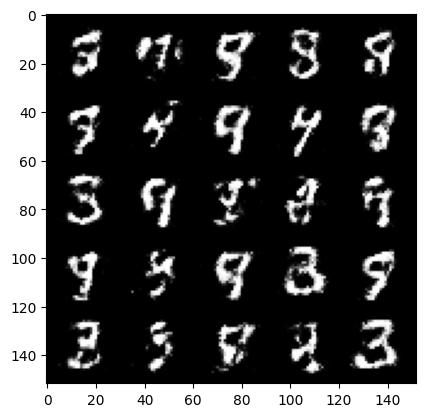

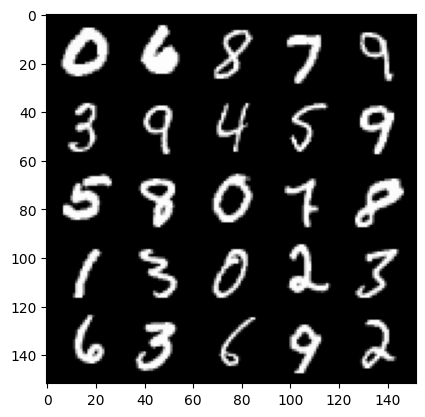

 21%|██        | 99/469 [00:02<00:09, 38.59it/s]

Step 47000: Generator loss: 1.9357028279304493, discriminator loss: 0.33787248864769914


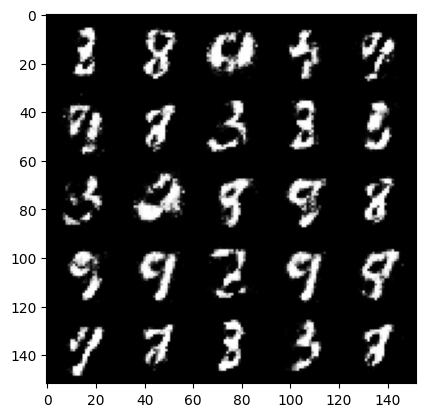

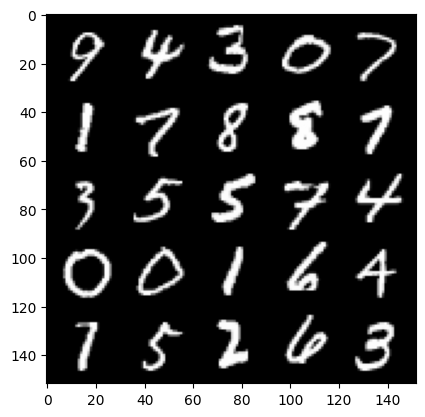

 28%|██▊       | 130/469 [00:03<00:09, 36.10it/s]

Step 47500: Generator loss: 2.0135118751525884, discriminator loss: 0.3279090337157249


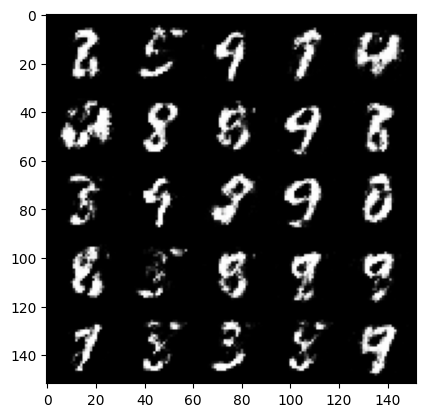

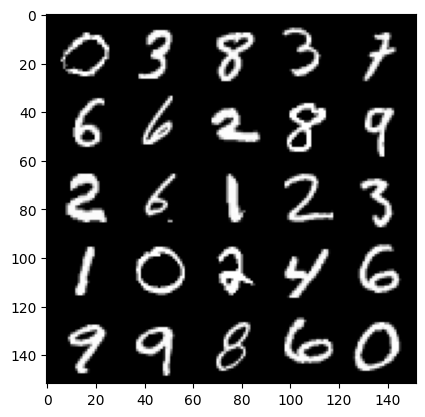

 34%|███▍      | 160/469 [00:04<00:08, 35.80it/s]

Step 48000: Generator loss: 1.930168600559234, discriminator loss: 0.34937014126777666


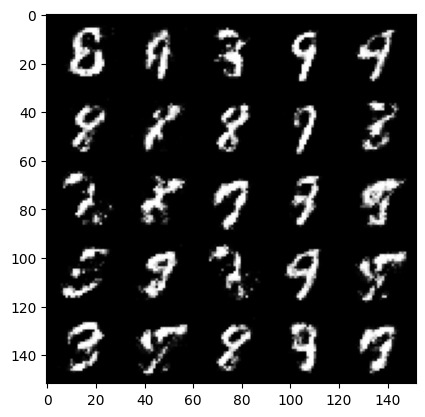

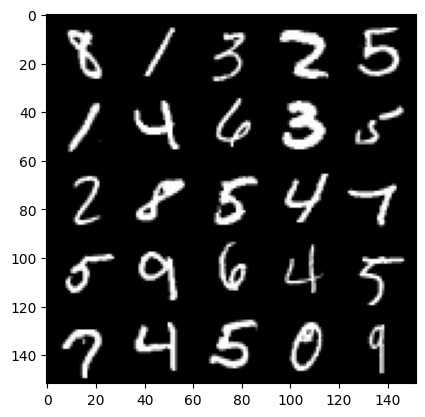

 41%|████      | 191/469 [00:05<00:07, 39.15it/s]

Step 48500: Generator loss: 1.9389881730079654, discriminator loss: 0.3544742670953276


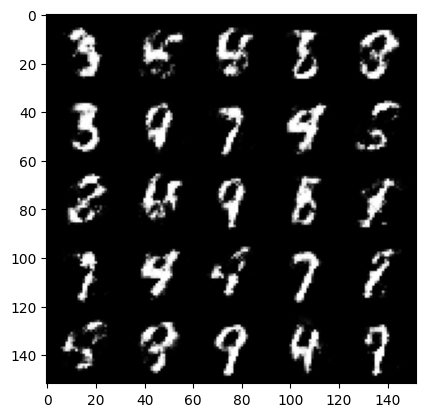

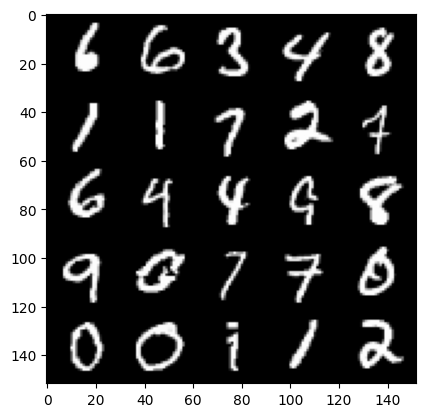

 47%|████▋     | 222/469 [00:05<00:06, 37.34it/s]

Step 49000: Generator loss: 1.9604344317913087, discriminator loss: 0.3454359211325644


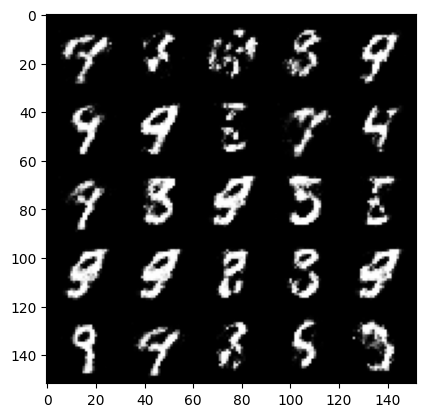

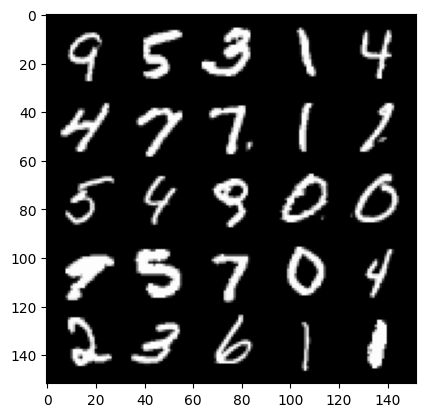

 54%|█████▍    | 255/469 [00:07<00:06, 30.72it/s]

Step 49500: Generator loss: 1.8819993214607238, discriminator loss: 0.36556969016790397


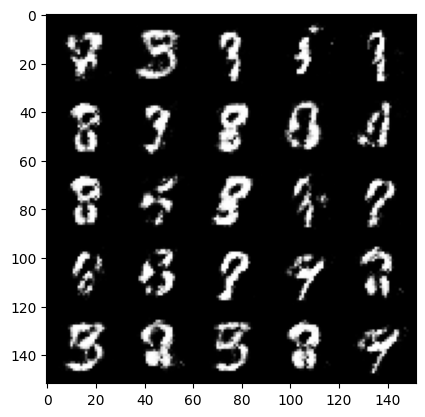

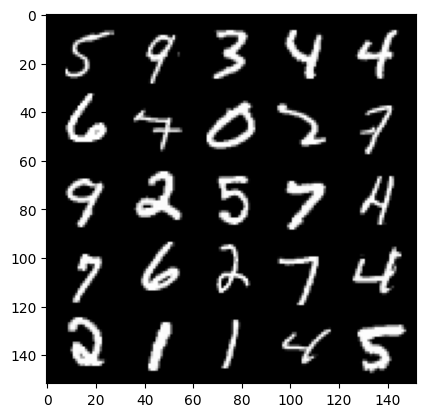

 61%|██████    | 286/469 [00:08<00:06, 28.89it/s]

Step 50000: Generator loss: 1.8447229650020591, discriminator loss: 0.36726578637957585


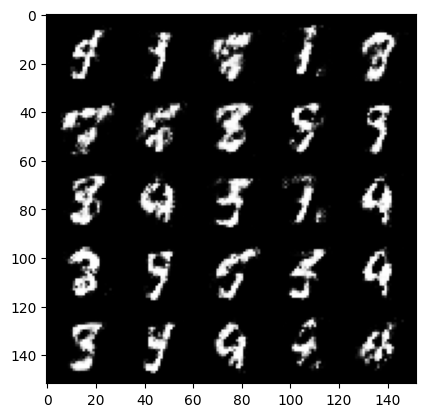

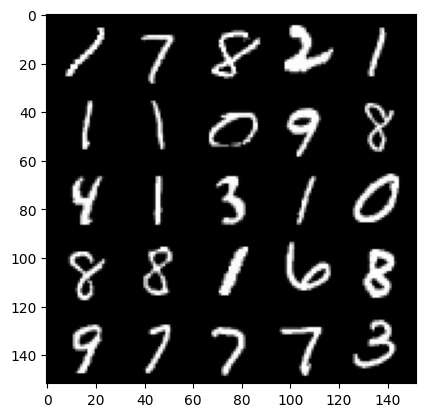

 67%|██████▋   | 316/469 [00:09<00:04, 37.99it/s]

Step 50500: Generator loss: 1.9359710376262673, discriminator loss: 0.33204947745799995


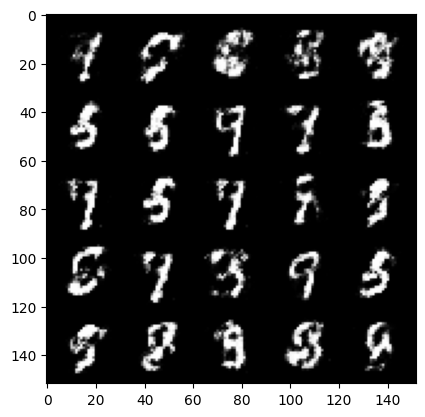

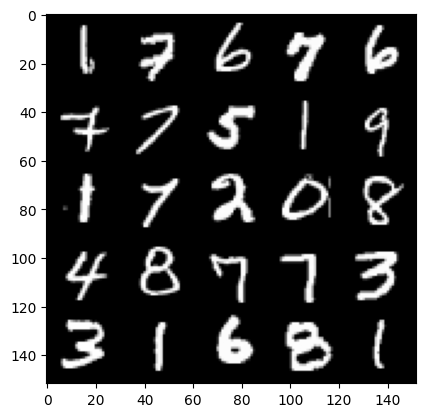

 74%|███████▎  | 345/469 [00:09<00:03, 36.45it/s]

Step 51000: Generator loss: 1.9722111973762513, discriminator loss: 0.3340230613648888


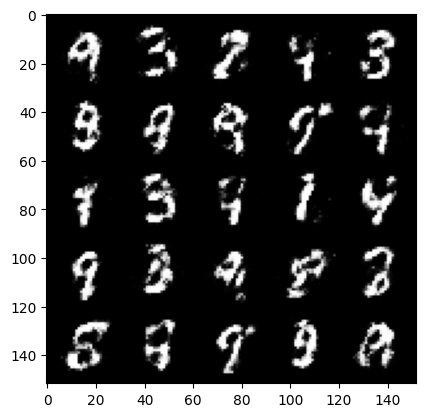

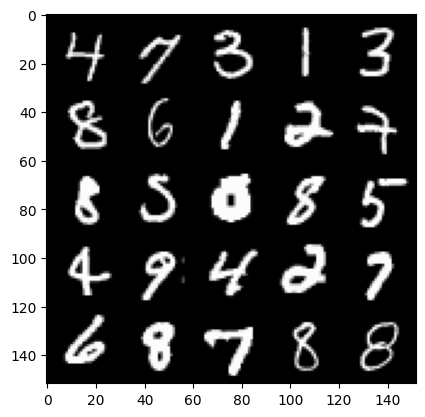

 81%|████████  | 378/469 [00:10<00:02, 37.02it/s]

Step 51500: Generator loss: 1.9036320903301247, discriminator loss: 0.35175035727024107


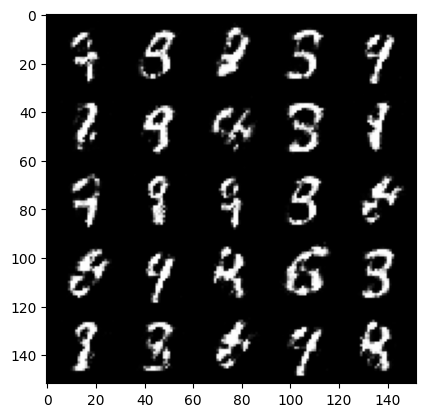

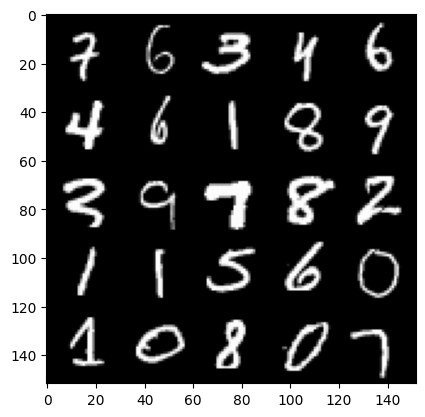

 87%|████████▋ | 407/469 [00:10<00:01, 37.97it/s]

Step 52000: Generator loss: 1.8758335185050976, discriminator loss: 0.3587572488188744


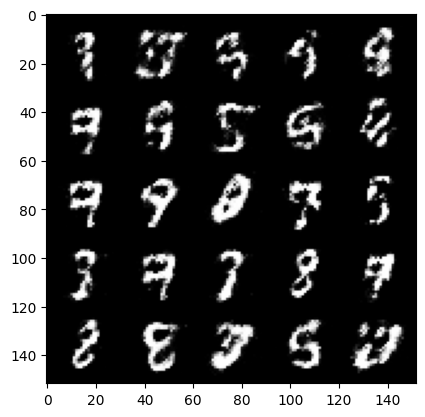

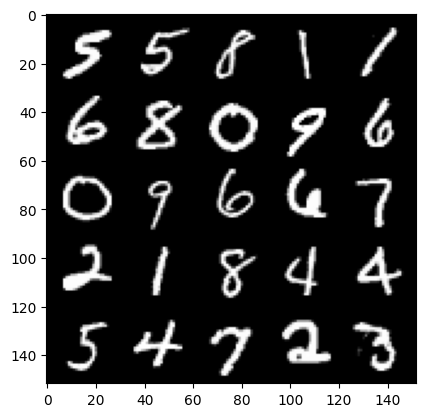

 94%|█████████▍| 440/469 [00:11<00:00, 37.22it/s]

Step 52500: Generator loss: 1.8273245470523845, discriminator loss: 0.36799310535192503


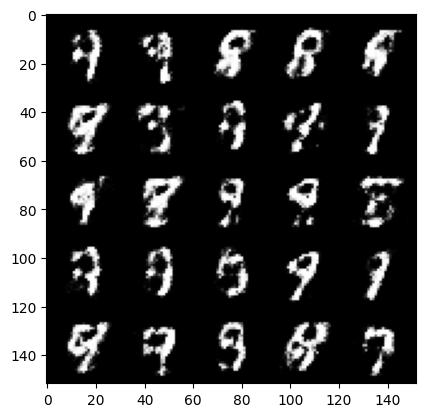

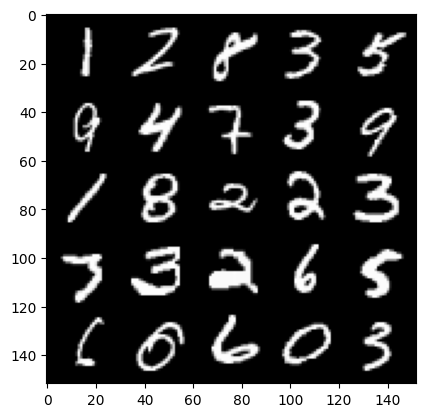

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.8354900388717637, discriminator loss: 0.3639578965008259


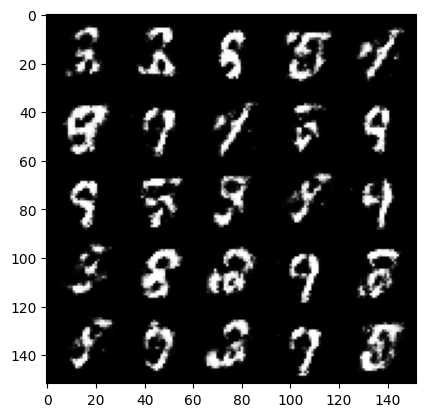

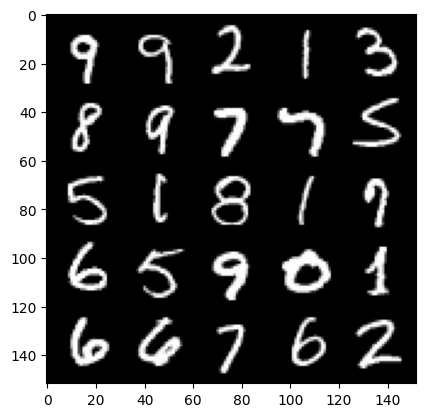

  7%|▋         | 32/469 [00:00<00:12, 36.34it/s]

Step 53500: Generator loss: 1.8416229782104494, discriminator loss: 0.34885142415761966


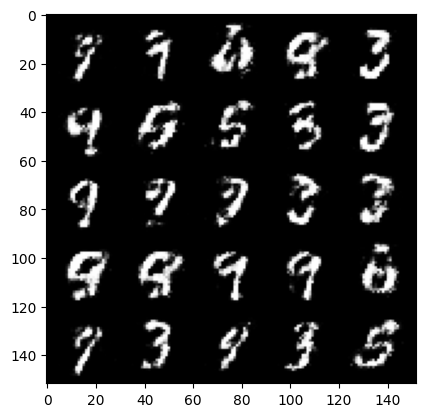

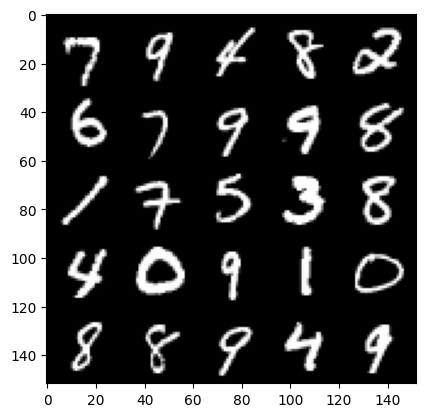

 13%|█▎        | 63/469 [00:01<00:10, 36.94it/s]

Step 54000: Generator loss: 1.8683381645679469, discriminator loss: 0.34484106904268313


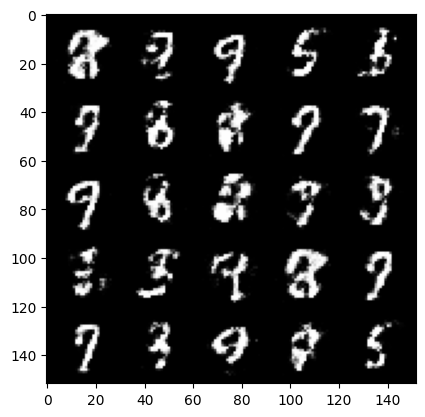

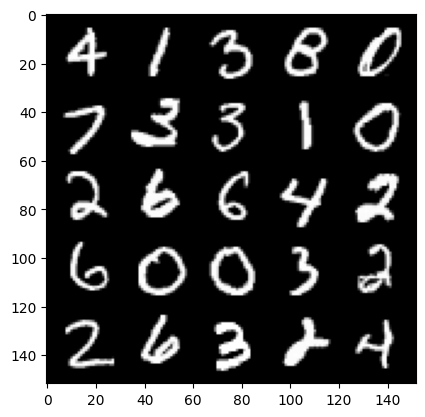

 20%|██        | 95/469 [00:02<00:10, 34.96it/s]

Step 54500: Generator loss: 1.849936732769013, discriminator loss: 0.3528083525896072


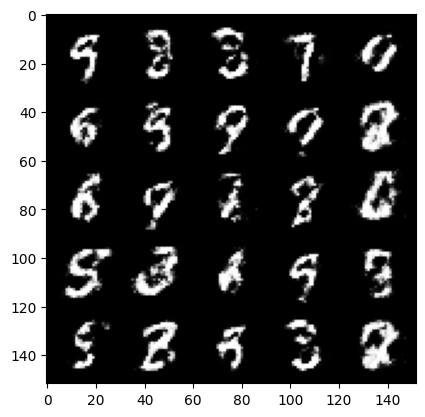

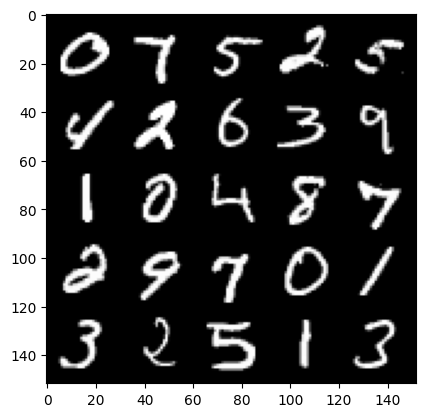

 27%|██▋       | 125/469 [00:03<00:09, 34.66it/s]

Step 55000: Generator loss: 1.8084450562000276, discriminator loss: 0.363913359284401


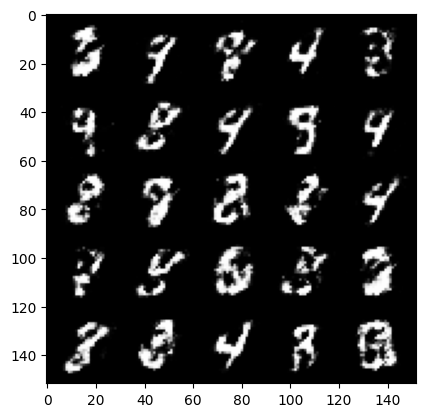

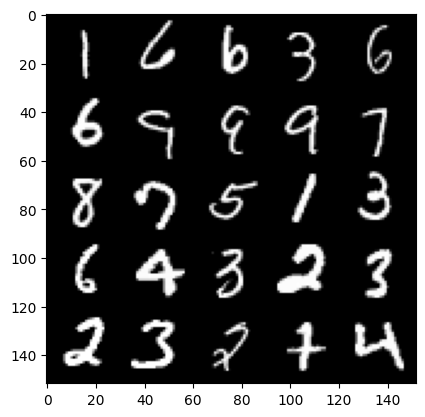

 33%|███▎      | 156/469 [00:04<00:08, 35.80it/s]

Step 55500: Generator loss: 1.8514735066890717, discriminator loss: 0.3592045489251615


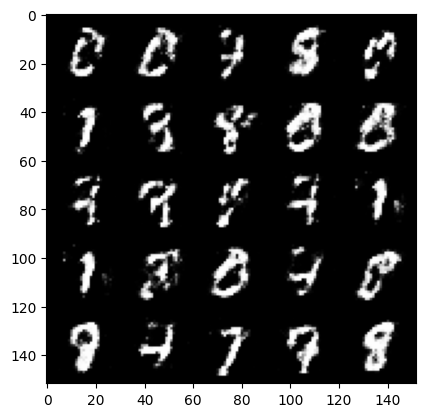

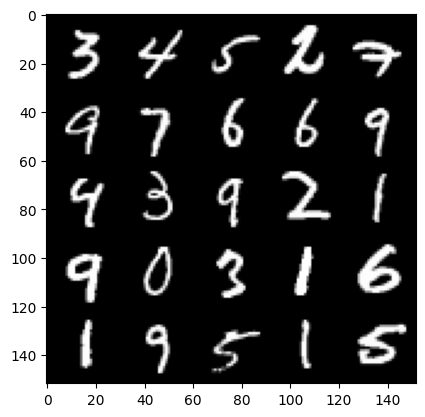

 40%|███▉      | 187/469 [00:05<00:07, 36.76it/s]

Step 56000: Generator loss: 1.7870584292411804, discriminator loss: 0.3616876450181009


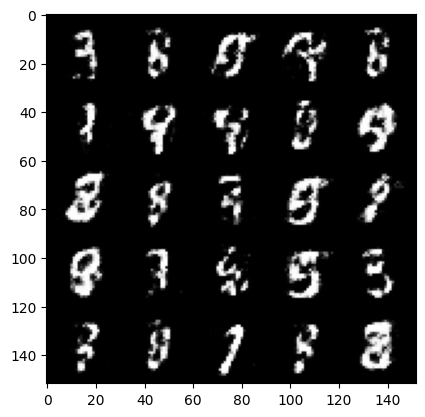

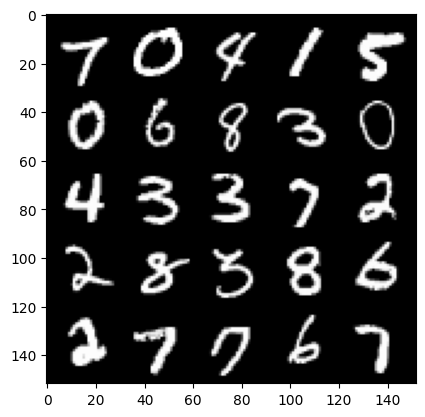

 47%|████▋     | 219/469 [00:06<00:07, 35.33it/s]

Step 56500: Generator loss: 1.7289540400505072, discriminator loss: 0.3735186156630516


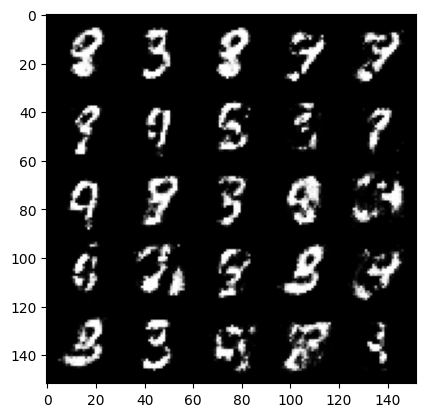

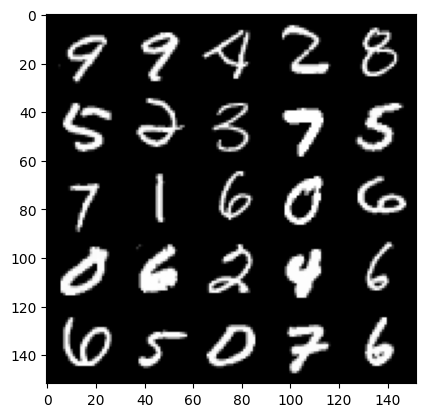

 53%|█████▎    | 250/469 [00:07<00:07, 29.12it/s]

Step 57000: Generator loss: 1.8154879636764532, discriminator loss: 0.3579727360010146


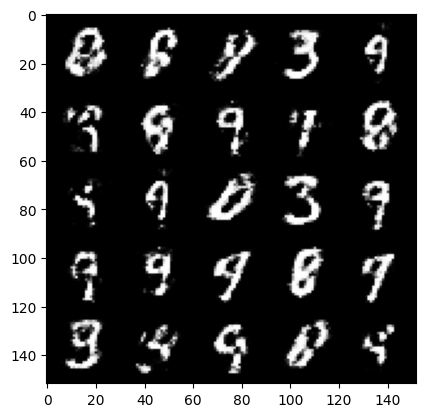

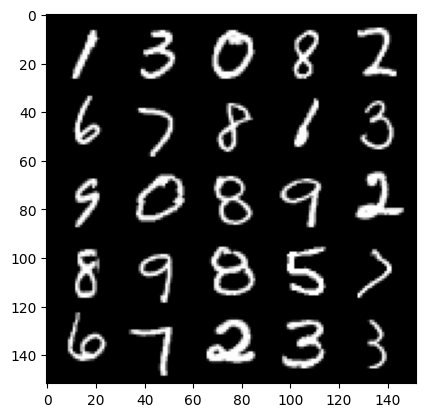

 60%|█████▉    | 281/469 [00:07<00:04, 37.73it/s]

Step 57500: Generator loss: 1.8336534068584436, discriminator loss: 0.36205243223905587


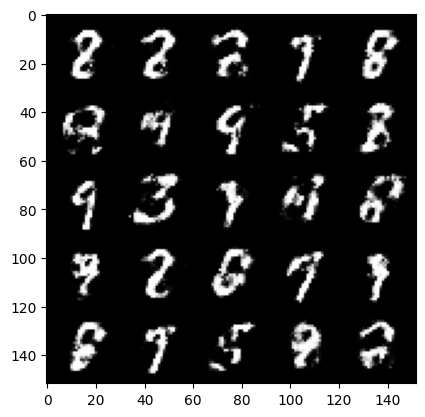

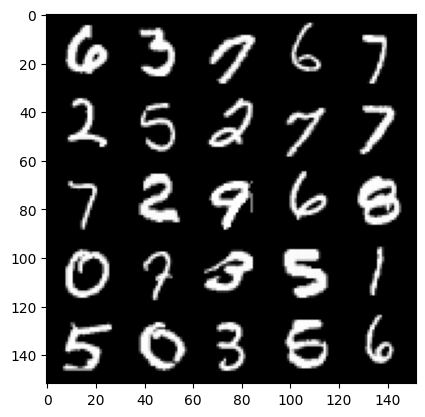

 67%|██████▋   | 312/469 [00:08<00:04, 37.86it/s]

Step 58000: Generator loss: 1.8002710847854626, discriminator loss: 0.37379145646095263


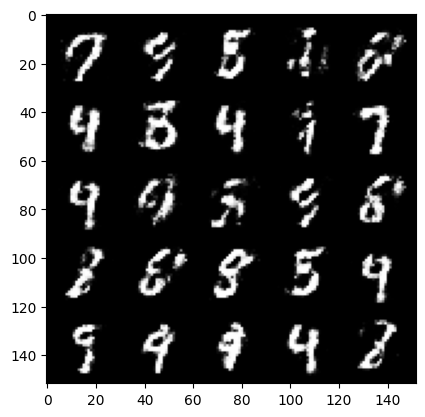

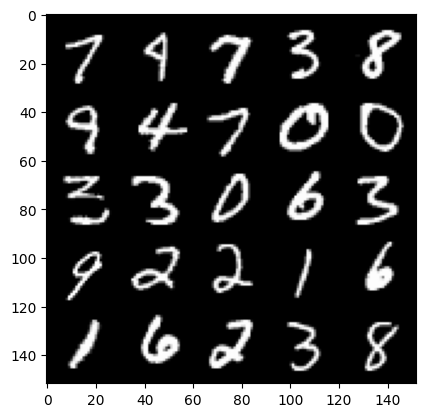

 73%|███████▎  | 342/469 [00:09<00:03, 36.87it/s]

Step 58500: Generator loss: 1.7691811246871936, discriminator loss: 0.3745264350771901


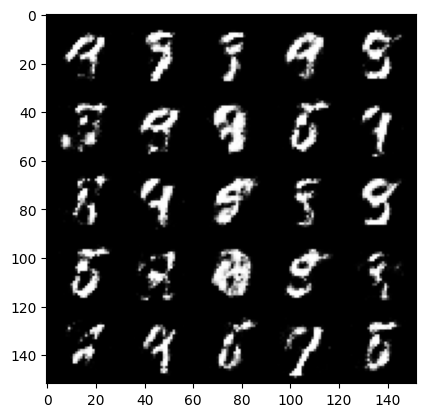

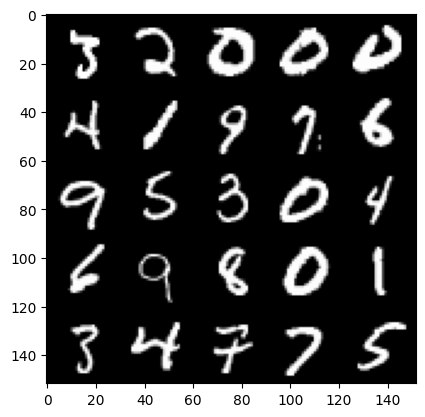

 79%|███████▉  | 372/469 [00:09<00:02, 37.61it/s]

Step 59000: Generator loss: 1.7295199894905082, discriminator loss: 0.38625513803958883


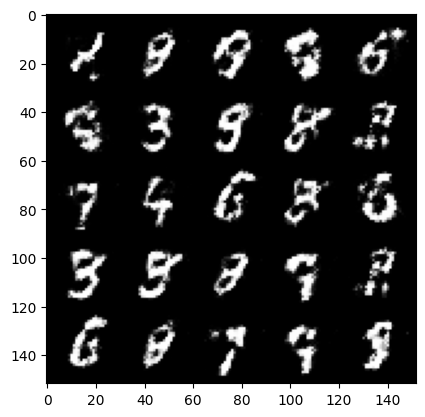

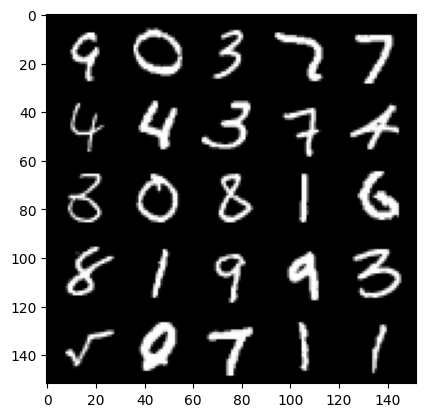

 86%|████████▋ | 405/469 [00:10<00:01, 38.12it/s]

Step 59500: Generator loss: 1.82701315140724, discriminator loss: 0.3547048725485799


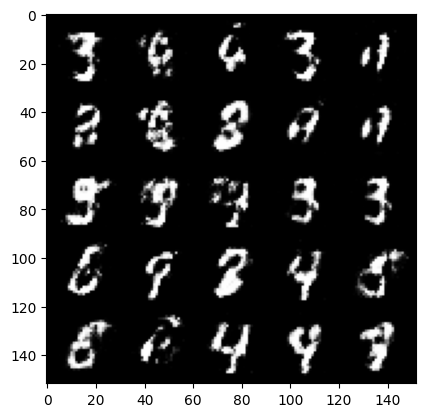

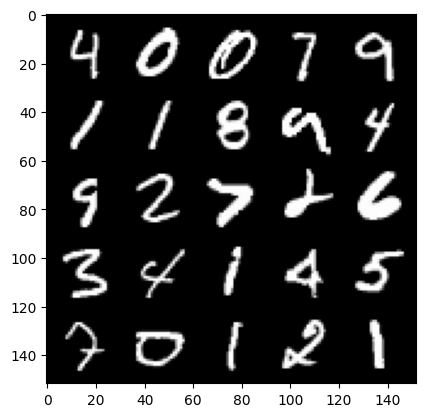

 93%|█████████▎| 435/469 [00:11<00:00, 37.10it/s]

Step 60000: Generator loss: 1.7838903870582585, discriminator loss: 0.375852920562029


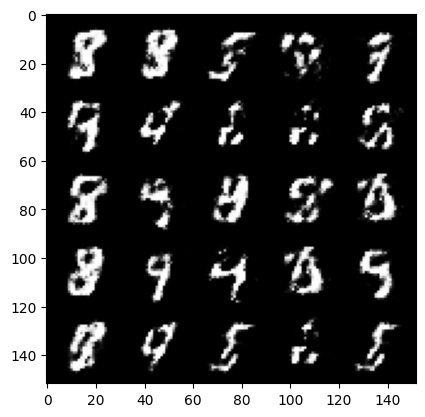

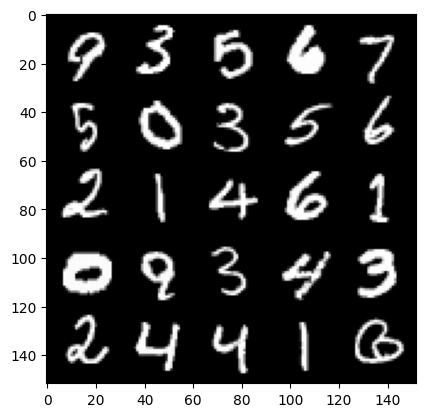

100%|█████████▉| 467/469 [00:12<00:00, 38.48it/s]

Step 60500: Generator loss: 1.857150820255279, discriminator loss: 0.3389875958859924


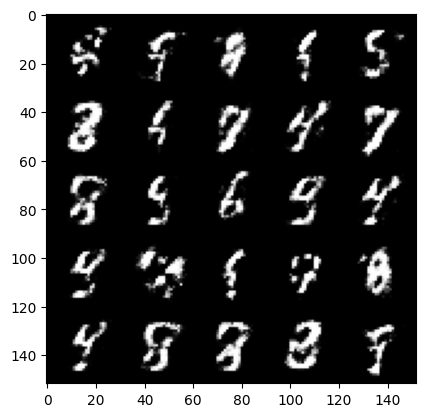

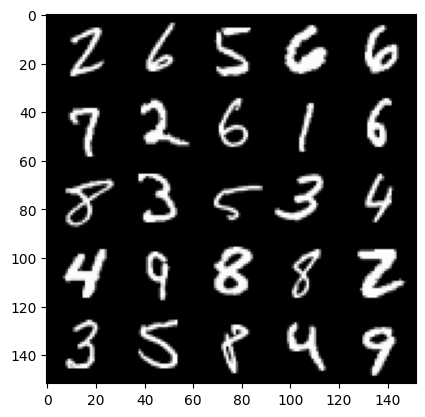

  6%|▌         | 28/469 [00:00<00:12, 35.80it/s]

Step 61000: Generator loss: 1.8375847835540766, discriminator loss: 0.3505965915918355


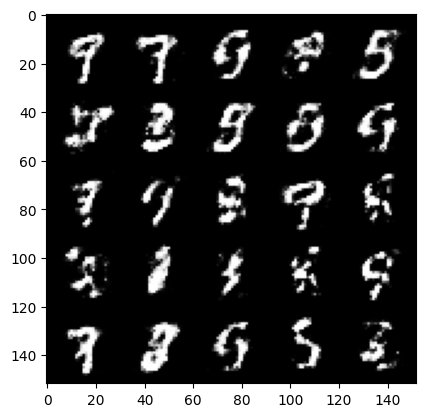

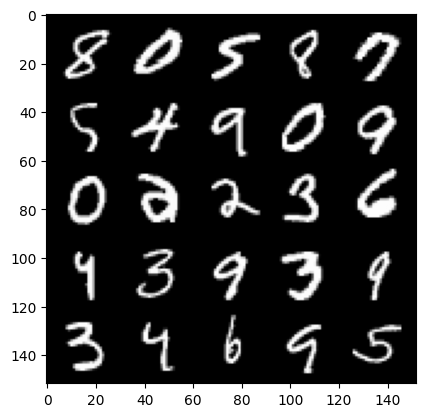

 13%|█▎        | 60/469 [00:01<00:11, 36.61it/s]

Step 61500: Generator loss: 1.7974865045547481, discriminator loss: 0.35920103800296826


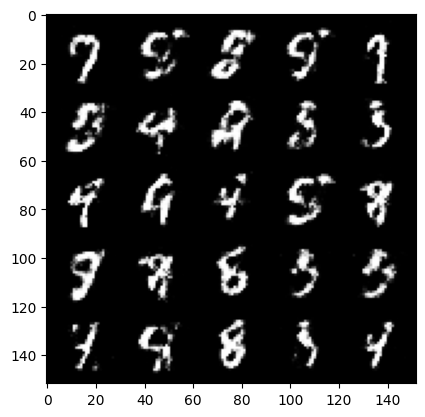

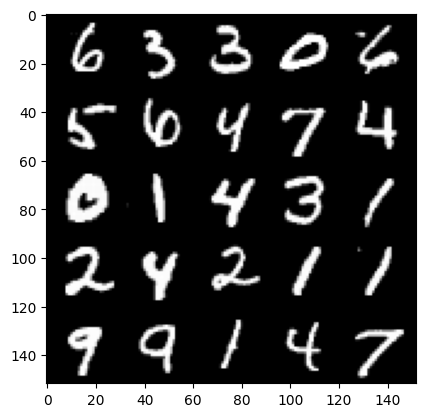

 19%|█▉        | 91/469 [00:02<00:11, 33.38it/s]

Step 62000: Generator loss: 1.7421786305904408, discriminator loss: 0.3782619317173955


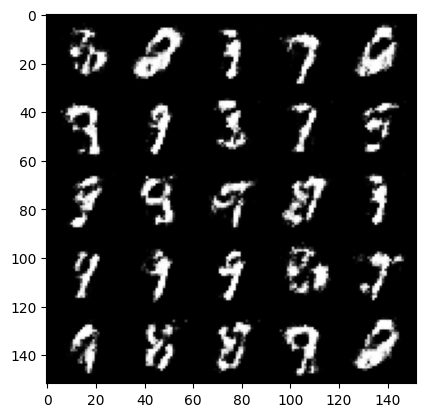

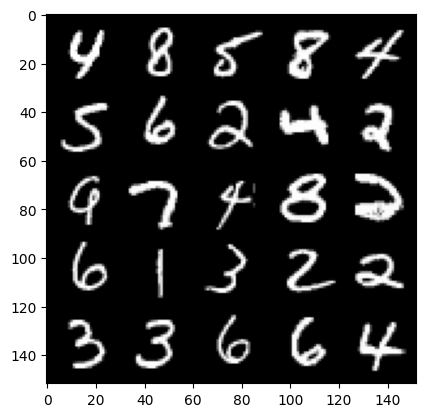

 26%|██▌       | 121/469 [00:03<00:10, 34.14it/s]

Step 62500: Generator loss: 1.7705566904544843, discriminator loss: 0.3749060612916949


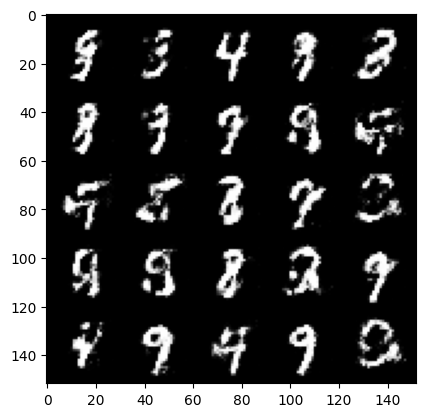

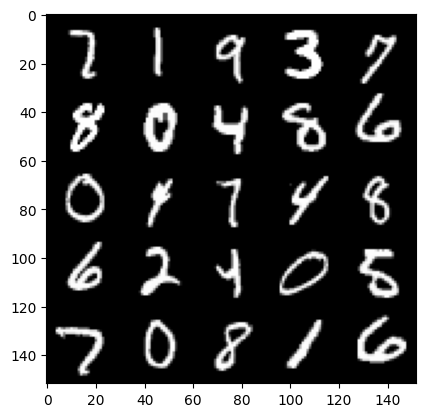

 33%|███▎      | 154/469 [00:04<00:08, 38.30it/s]

Step 63000: Generator loss: 1.7762644903659812, discriminator loss: 0.37187762379646283


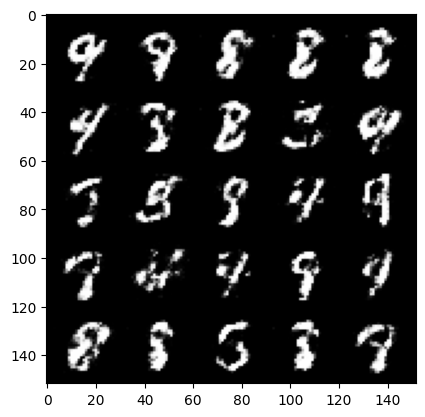

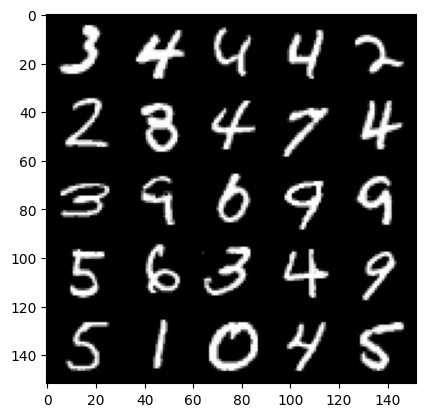

 39%|███▉      | 182/469 [00:04<00:07, 38.31it/s]

Step 63500: Generator loss: 1.7442152626514442, discriminator loss: 0.36988426893949494


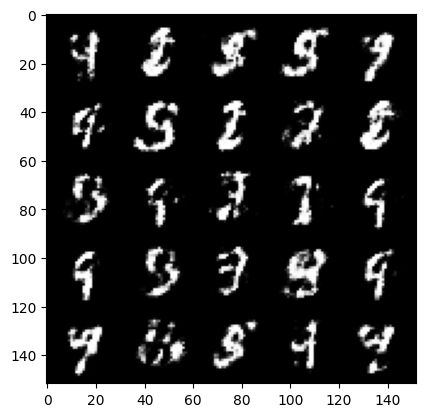

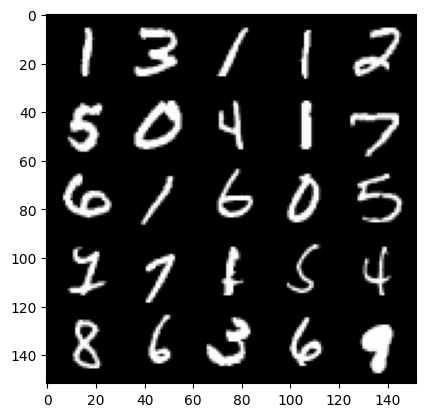

 46%|████▌     | 214/469 [00:05<00:06, 36.79it/s]

Step 64000: Generator loss: 1.7251325867176064, discriminator loss: 0.36900190156698276


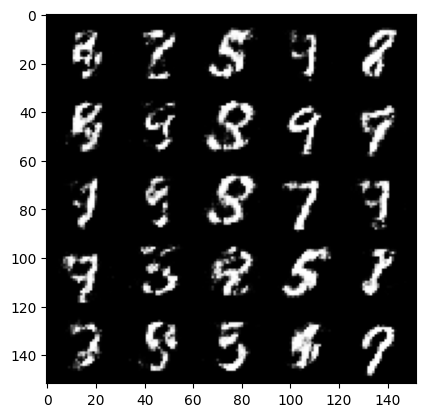

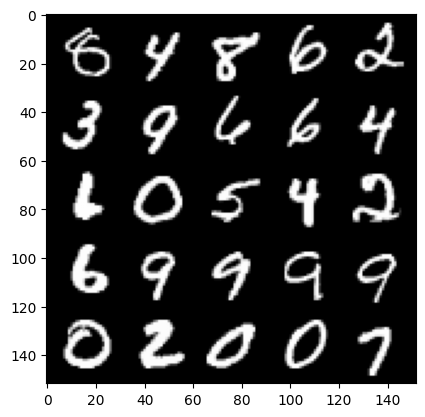

 52%|█████▏    | 245/469 [00:06<00:05, 39.21it/s]

Step 64500: Generator loss: 1.7321809835433972, discriminator loss: 0.36801031905412646


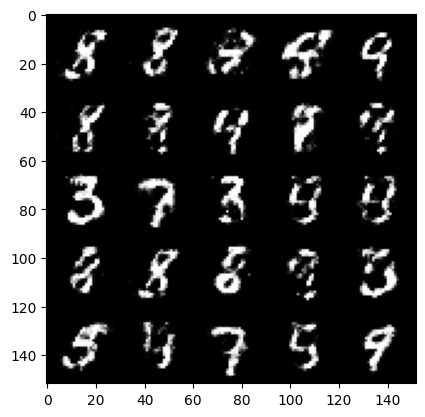

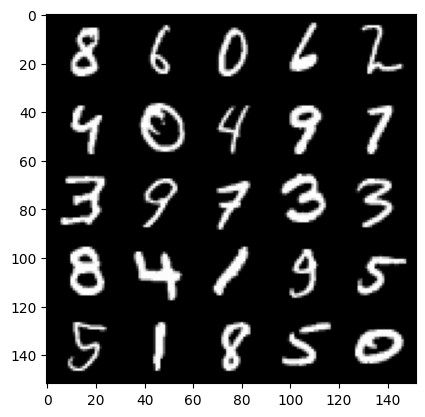

 59%|█████▉    | 276/469 [00:07<00:05, 38.45it/s]

Step 65000: Generator loss: 1.745021111011506, discriminator loss: 0.3705608418583873


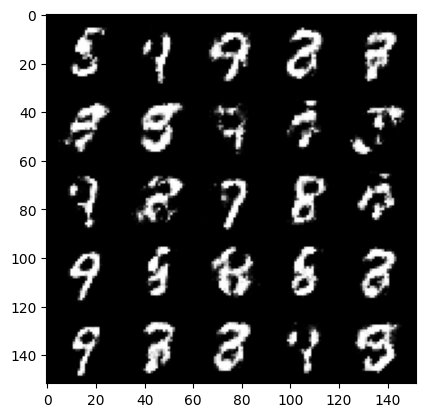

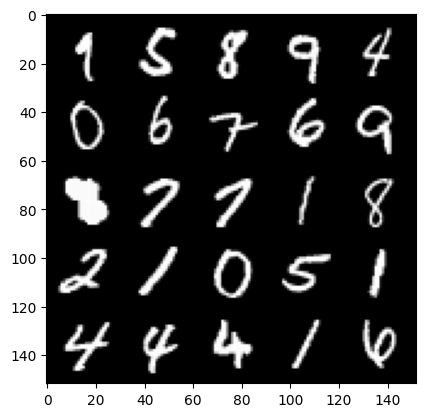

 65%|██████▌   | 306/469 [00:08<00:04, 38.31it/s]

Step 65500: Generator loss: 1.6128890972137475, discriminator loss: 0.402718185722828


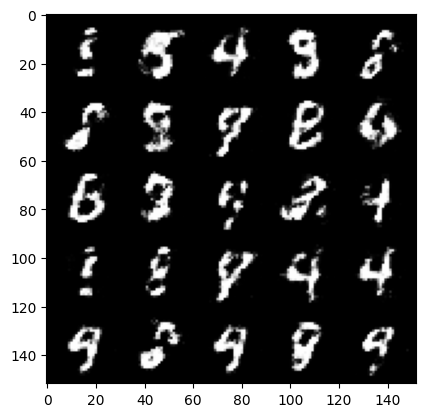

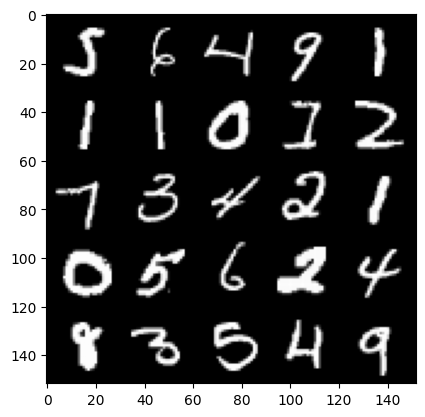

 72%|███████▏  | 339/469 [00:09<00:04, 32.09it/s]

Step 66000: Generator loss: 1.66484318780899, discriminator loss: 0.38951451164484036


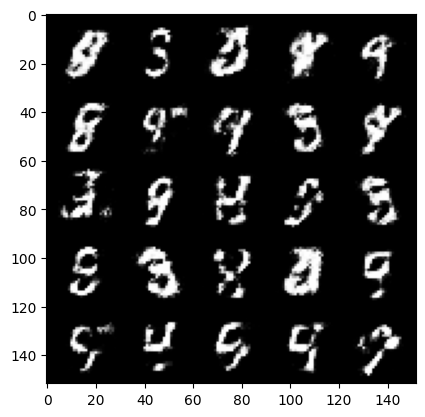

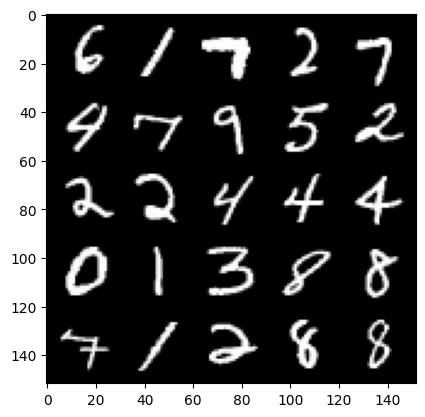

 78%|███████▊  | 368/469 [00:10<00:02, 38.57it/s]

Step 66500: Generator loss: 1.6264624614715602, discriminator loss: 0.39582786965370226


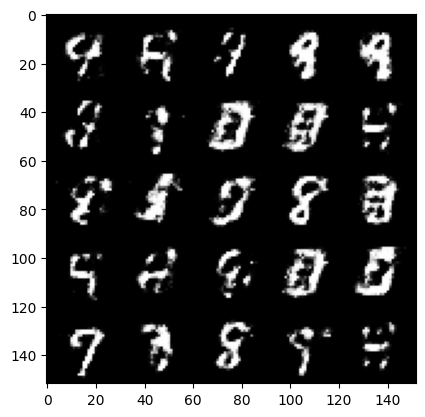

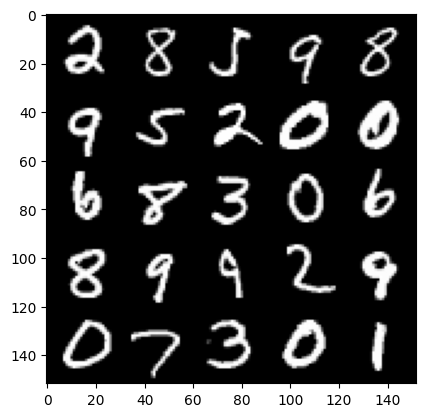

 86%|████████▌ | 402/469 [00:10<00:01, 35.90it/s]

Step 67000: Generator loss: 1.5884555962085707, discriminator loss: 0.41180624043941494


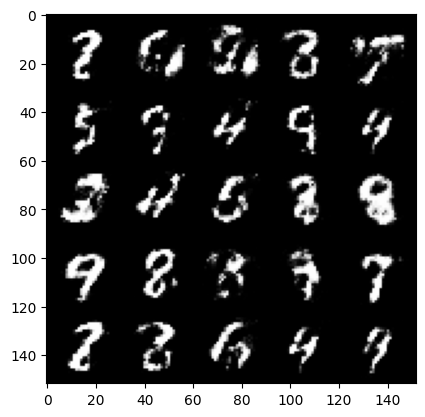

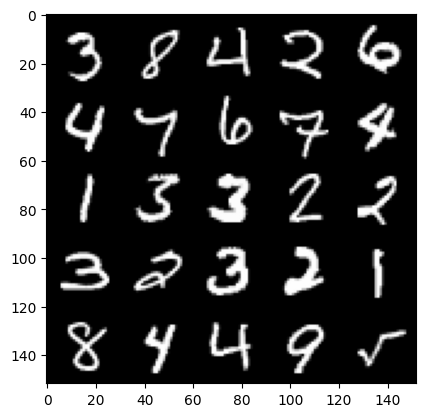

 92%|█████████▏| 430/469 [00:11<00:01, 34.78it/s]

Step 67500: Generator loss: 1.5808716766834265, discriminator loss: 0.402557536303997


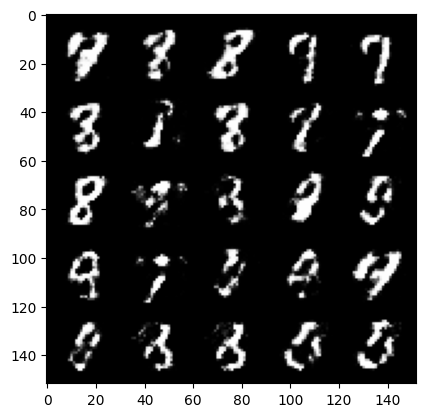

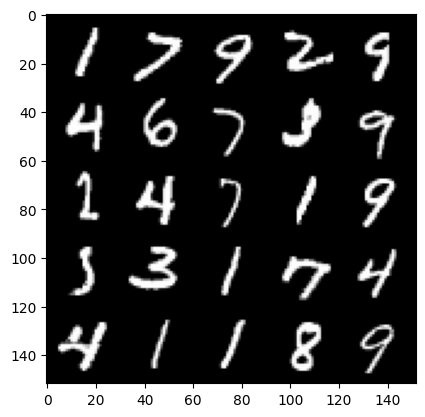

 99%|█████████▊| 463/469 [00:12<00:00, 35.51it/s]

Step 68000: Generator loss: 1.5467024602890005, discriminator loss: 0.4113836616277693


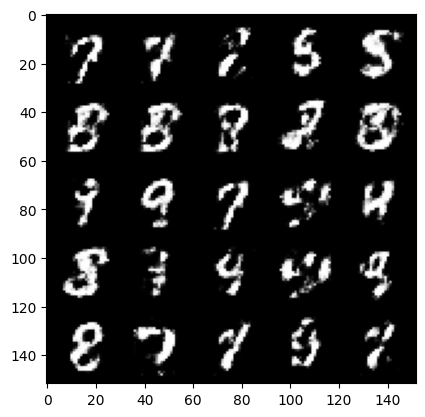

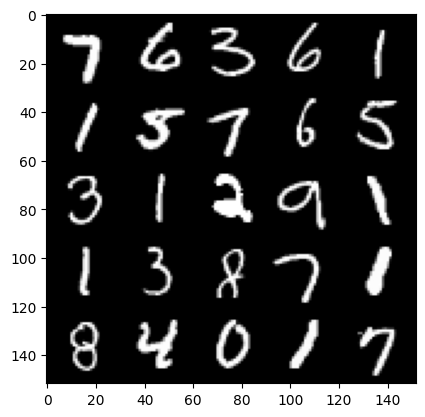

  5%|▌         | 24/469 [00:00<00:12, 35.60it/s]

Step 68500: Generator loss: 1.603577243089677, discriminator loss: 0.40619656008481986


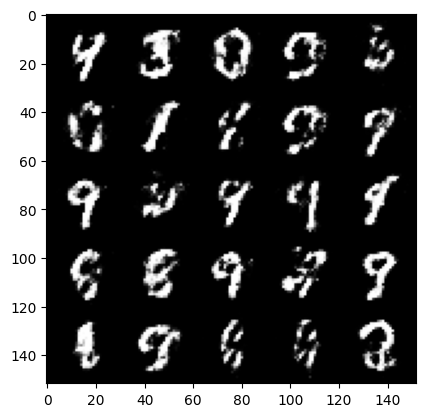

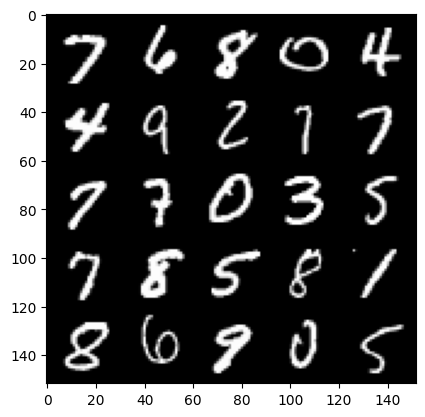

 12%|█▏        | 54/469 [00:01<00:11, 35.44it/s]

Step 69000: Generator loss: 1.5790369594097138, discriminator loss: 0.41233889389038114


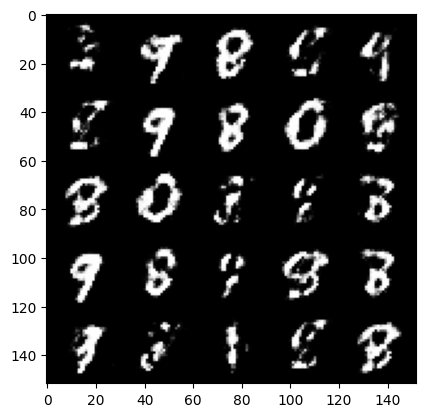

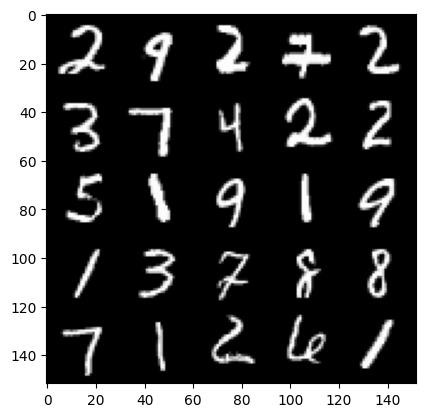

 18%|█▊        | 86/469 [00:02<00:09, 38.48it/s]

Step 69500: Generator loss: 1.5795179271697994, discriminator loss: 0.40987432712316524


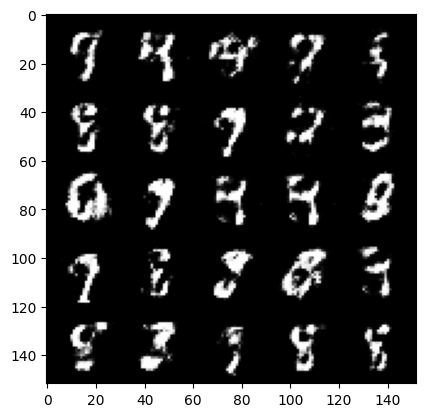

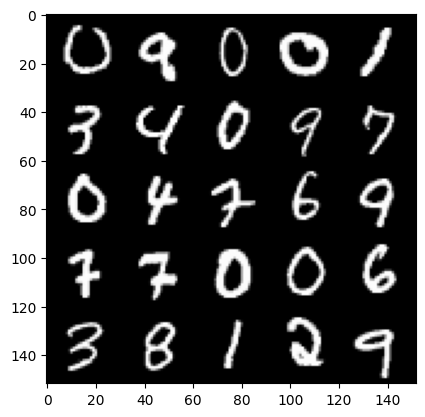

 25%|██▌       | 119/469 [00:03<00:09, 38.19it/s]

Step 70000: Generator loss: 1.6191721405982975, discriminator loss: 0.4002095724940299


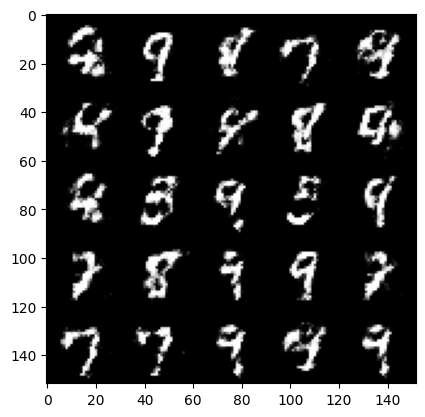

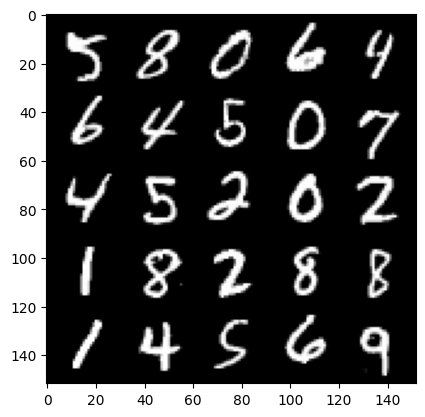

 32%|███▏      | 149/469 [00:06<00:13, 24.03it/s]

Step 70500: Generator loss: 1.6252191176414488, discriminator loss: 0.39801425880193697


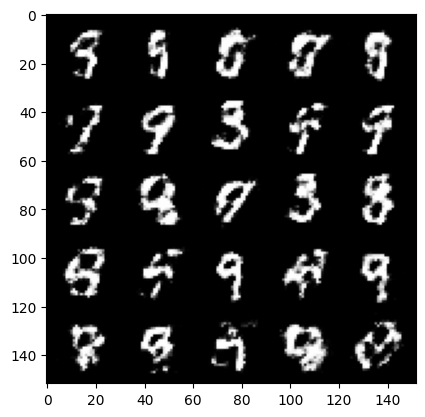

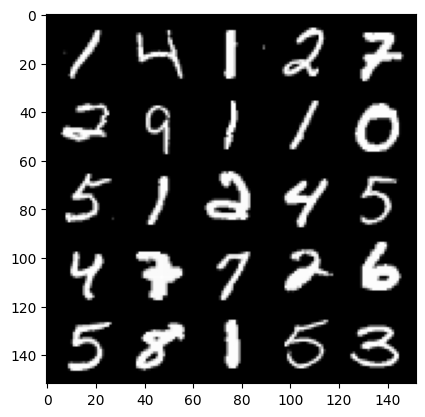

 38%|███▊      | 178/469 [00:08<00:13, 20.84it/s]

Step 71000: Generator loss: 1.6396476054191589, discriminator loss: 0.40187510520219805


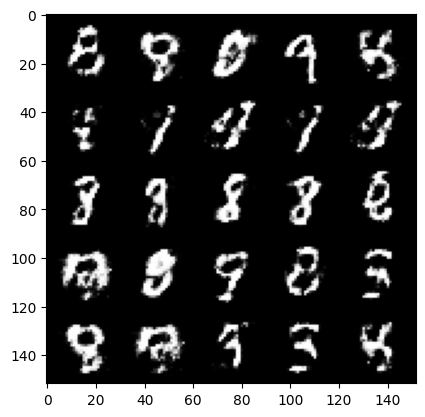

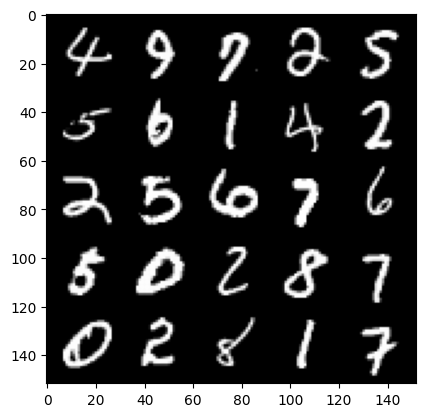

 45%|████▌     | 212/469 [00:09<00:12, 20.43it/s]

Step 71500: Generator loss: 1.6106020367145524, discriminator loss: 0.40318967312574366


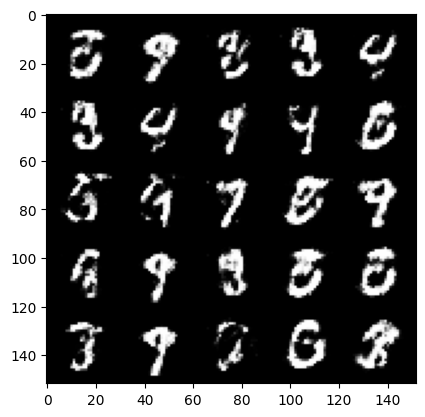

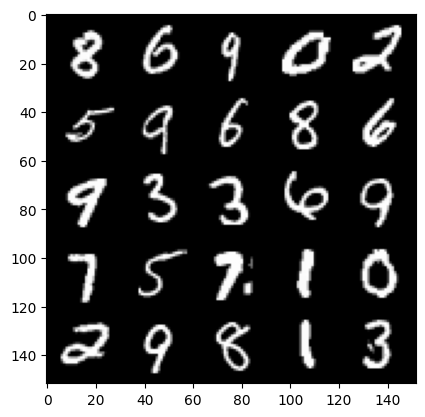

 52%|█████▏    | 242/469 [00:11<00:12, 18.25it/s]

Step 72000: Generator loss: 1.5433436236381537, discriminator loss: 0.4252021363973619


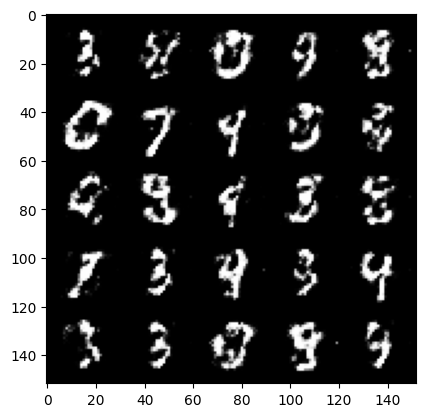

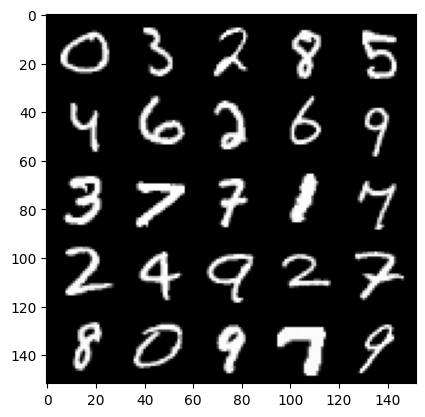

 58%|█████▊    | 270/469 [00:08<00:05, 39.08it/s]

Step 72500: Generator loss: 1.5738842933177954, discriminator loss: 0.41102598893642406


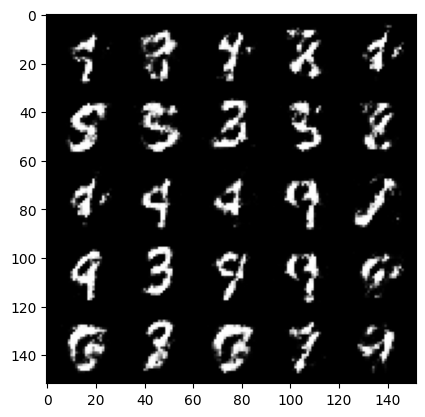

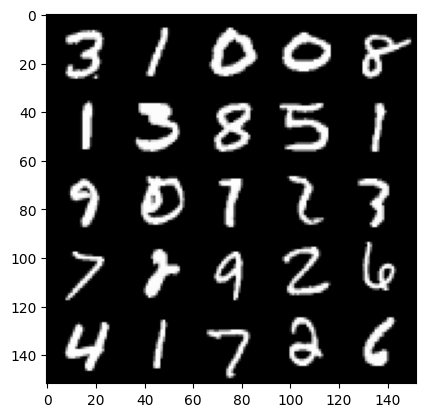

 65%|██████▌   | 305/469 [00:07<00:04, 40.69it/s]

Step 73000: Generator loss: 1.5541808331012719, discriminator loss: 0.41488966971635827


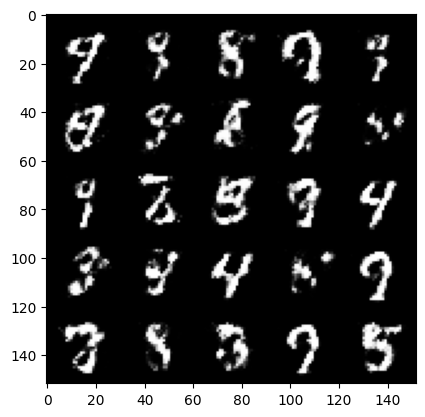

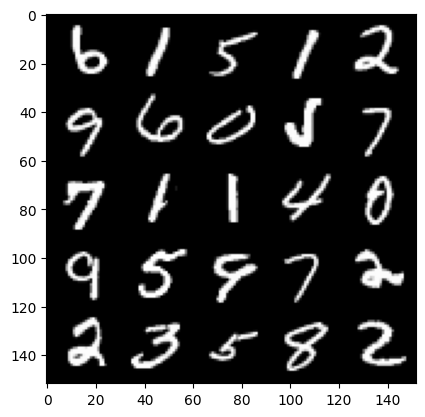

 71%|███████   | 333/469 [00:08<00:03, 38.09it/s]

Step 73500: Generator loss: 1.5363942325115205, discriminator loss: 0.4209777974486352


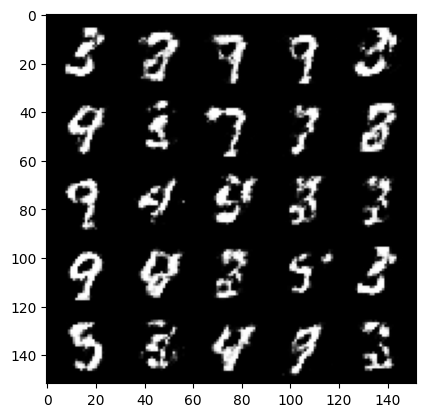

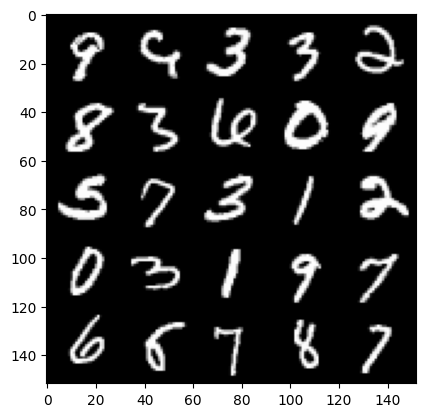

 78%|███████▊  | 367/469 [00:09<00:02, 38.41it/s]

Step 74000: Generator loss: 1.5937341306209565, discriminator loss: 0.39897927850484843


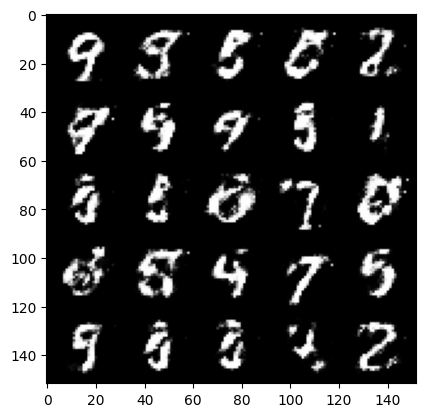

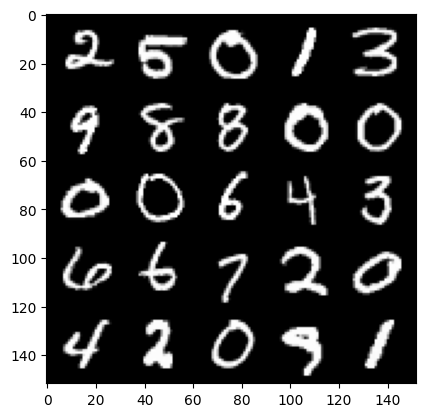

 84%|████████▍ | 395/469 [00:10<00:02, 35.63it/s]

Step 74500: Generator loss: 1.6236140253543858, discriminator loss: 0.39613319373130795


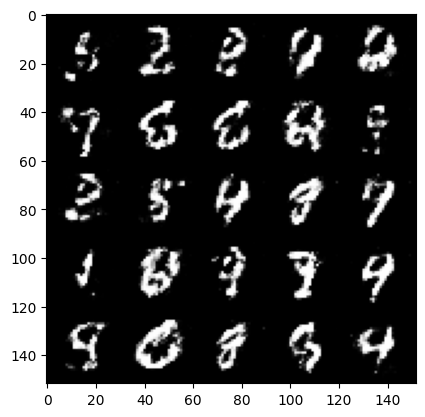

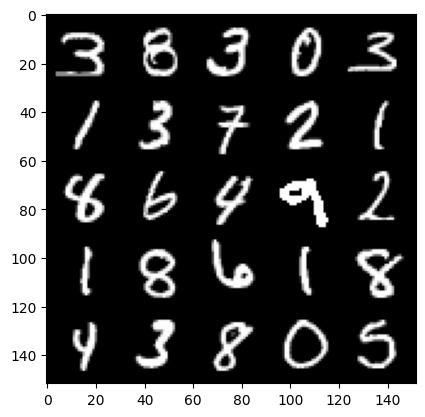

 91%|█████████ | 426/469 [00:11<00:01, 38.74it/s]

Step 75000: Generator loss: 1.51592850255966, discriminator loss: 0.42298422235250477


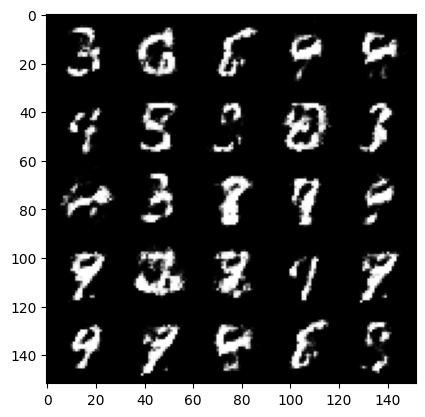

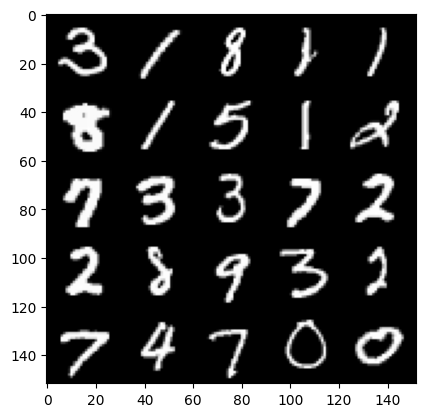

 98%|█████████▊| 459/469 [00:11<00:00, 41.83it/s]

Step 75500: Generator loss: 1.5456720345020298, discriminator loss: 0.4148668643832206


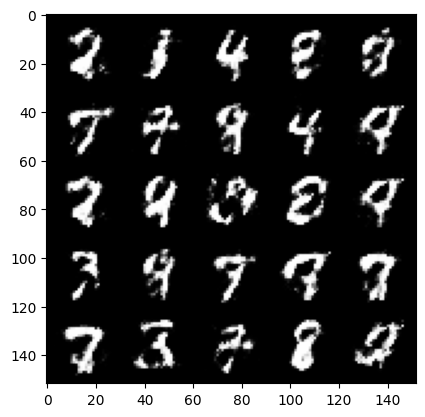

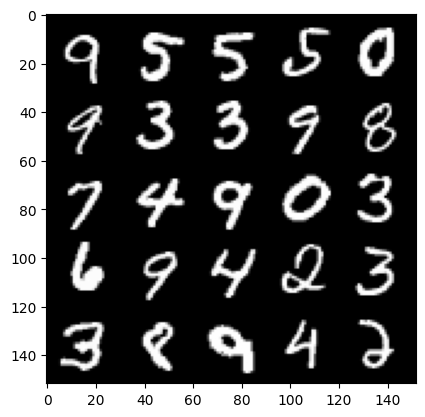

  4%|▍         | 21/469 [00:00<00:11, 37.67it/s]

Step 76000: Generator loss: 1.567328682184219, discriminator loss: 0.41514056992530807


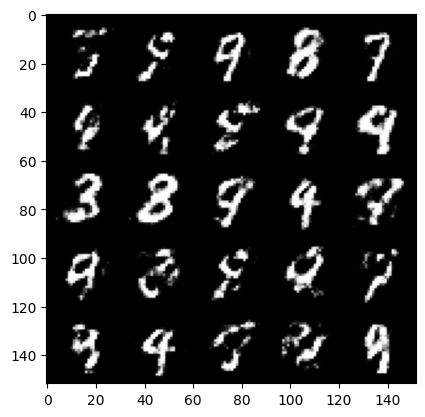

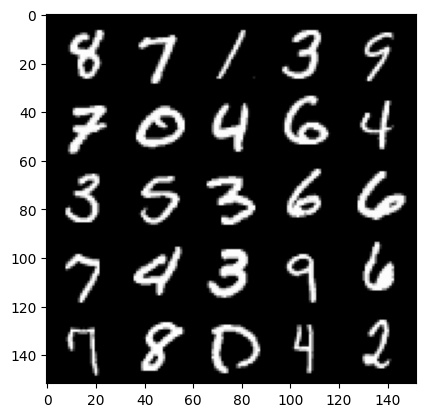

 11%|█         | 51/469 [00:01<00:11, 37.26it/s]

Step 76500: Generator loss: 1.438088670969009, discriminator loss: 0.45417442339658676


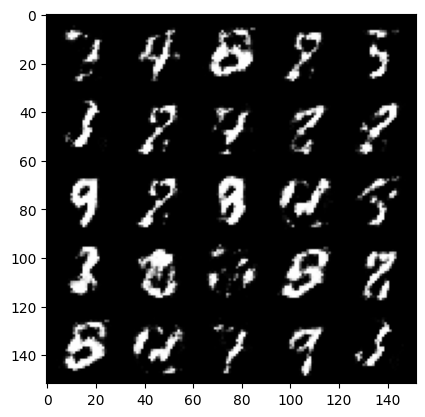

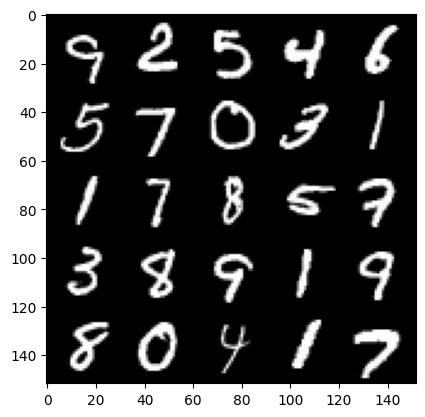

 17%|█▋        | 82/469 [00:02<00:09, 39.24it/s]

Step 77000: Generator loss: 1.3855458612442022, discriminator loss: 0.460344446957111


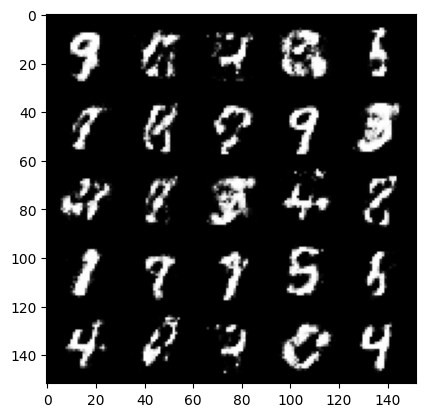

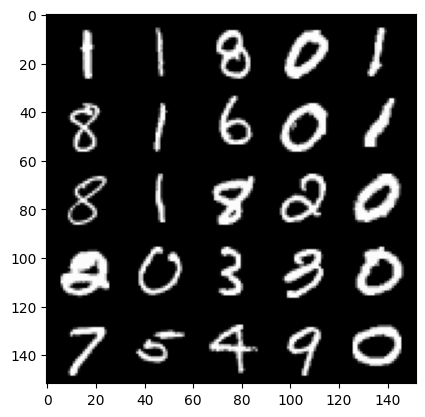

 24%|██▍       | 114/469 [00:02<00:08, 40.22it/s]

Step 77500: Generator loss: 1.5293240683078761, discriminator loss: 0.41055907273292525


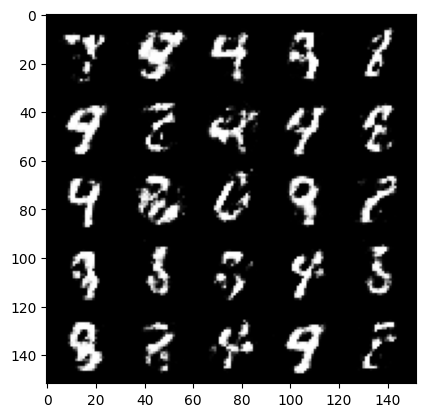

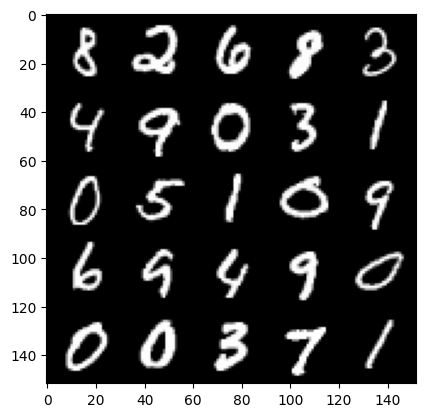

 30%|███       | 142/469 [00:03<00:08, 40.13it/s]

Step 78000: Generator loss: 1.4828446779251105, discriminator loss: 0.43764043527841556


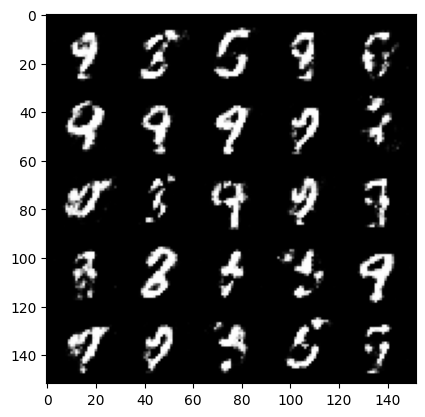

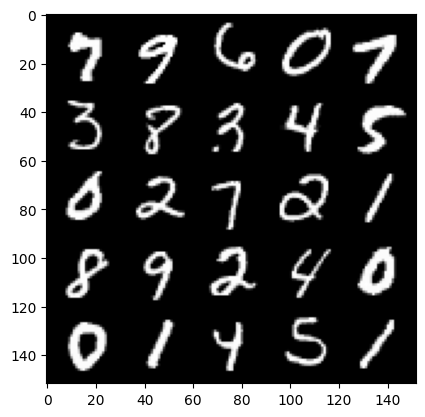

 37%|███▋      | 174/469 [00:04<00:07, 40.84it/s]

Step 78500: Generator loss: 1.609711754083634, discriminator loss: 0.39663001745939297


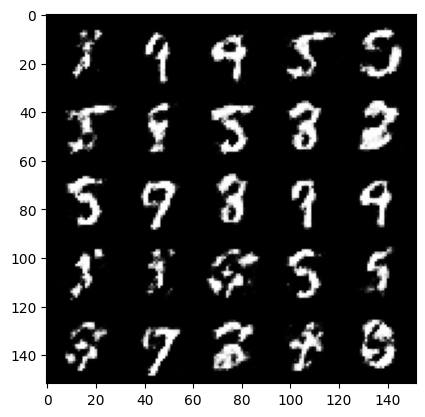

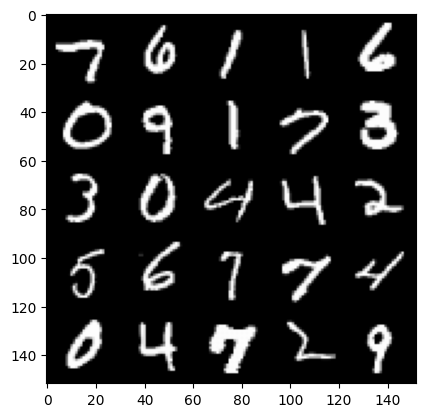

 44%|████▍     | 207/469 [00:05<00:06, 39.16it/s]

Step 79000: Generator loss: 1.563646325588227, discriminator loss: 0.4067950351834297


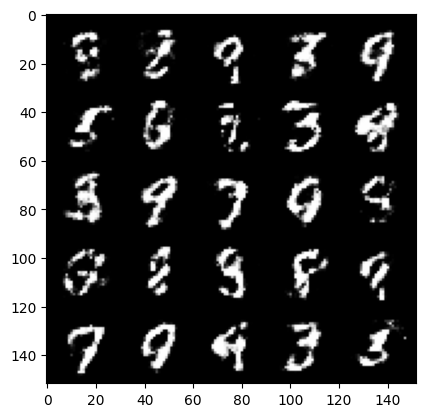

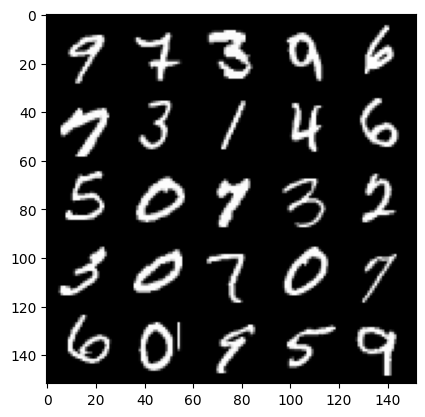

 51%|█████     | 238/469 [00:06<00:05, 40.57it/s]

Step 79500: Generator loss: 1.648305293083192, discriminator loss: 0.3806565176844596


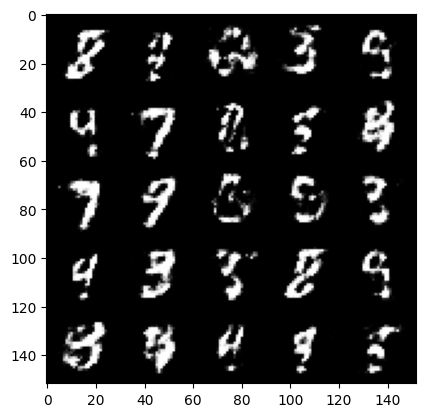

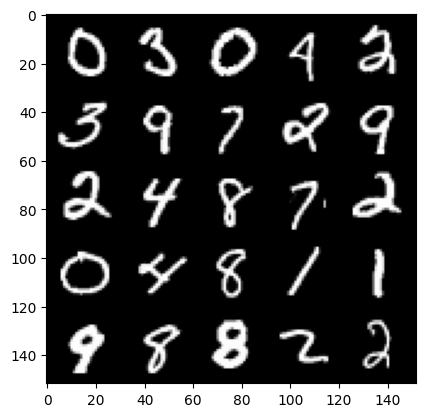

 57%|█████▋    | 269/469 [00:06<00:05, 39.12it/s]

Step 80000: Generator loss: 1.462155456304549, discriminator loss: 0.4422596784234048


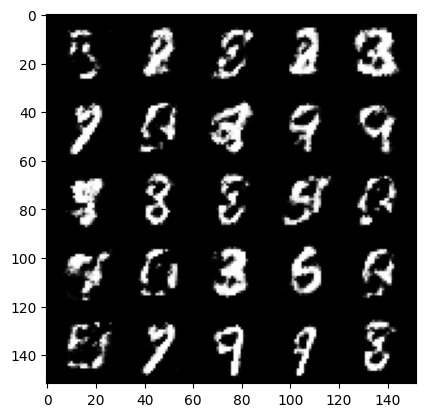

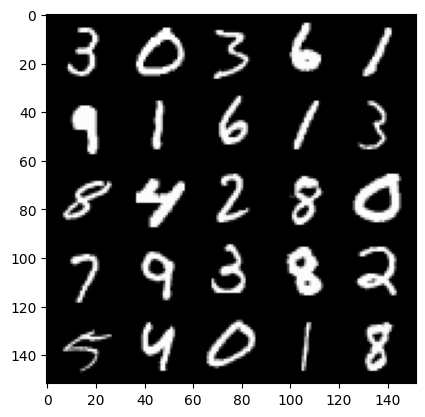

 63%|██████▎   | 297/469 [00:07<00:04, 40.03it/s]

Step 80500: Generator loss: 1.4716848390102384, discriminator loss: 0.42092868578434006


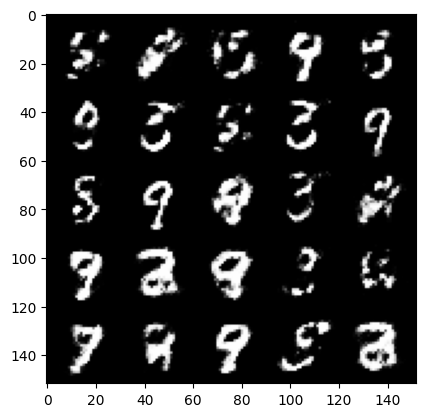

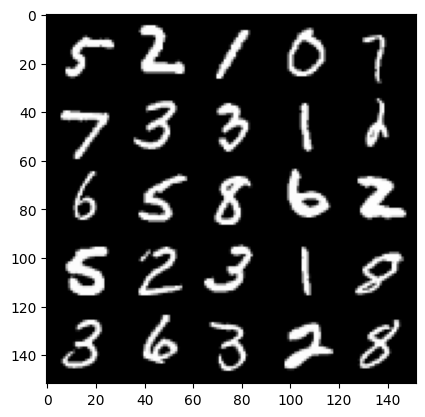

 71%|███████   | 332/469 [00:08<00:03, 40.04it/s]

Step 81000: Generator loss: 1.5419635927677149, discriminator loss: 0.4060923861265183


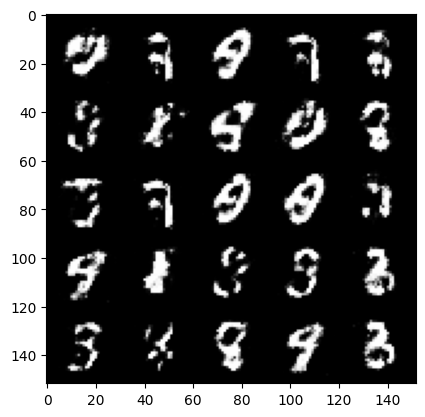

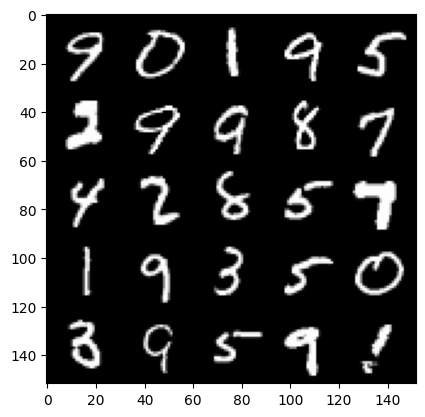

 77%|███████▋  | 362/469 [00:09<00:03, 31.54it/s]

Step 81500: Generator loss: 1.464586741924285, discriminator loss: 0.43491768097877476


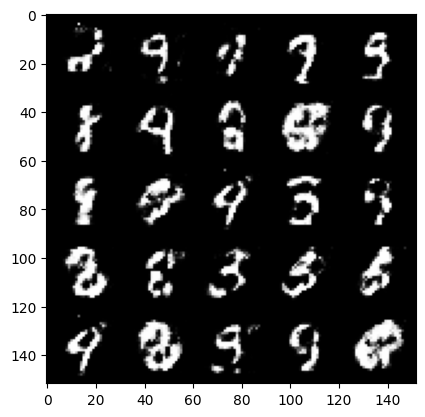

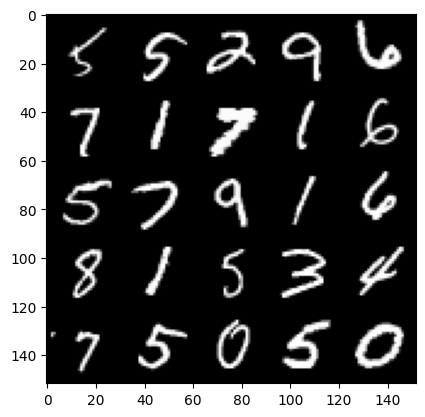

 84%|████████▍ | 394/469 [00:10<00:01, 39.74it/s]

Step 82000: Generator loss: 1.5486198899745938, discriminator loss: 0.40324135613441486


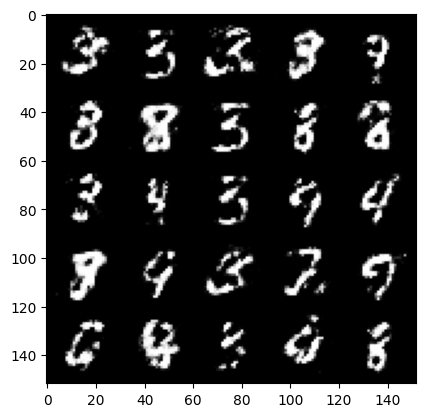

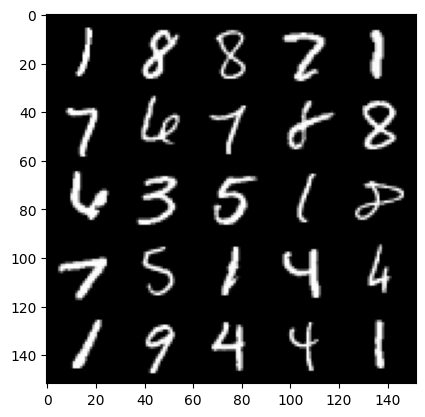

 90%|█████████ | 423/469 [00:10<00:01, 37.90it/s]

Step 82500: Generator loss: 1.5064477794170381, discriminator loss: 0.4192348617315293


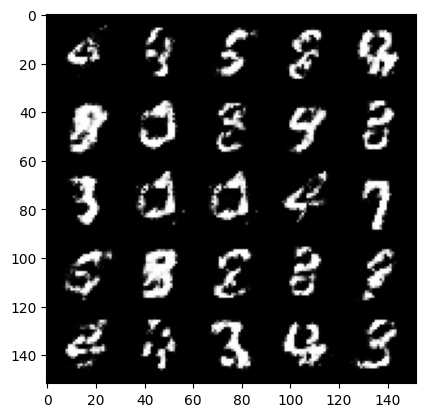

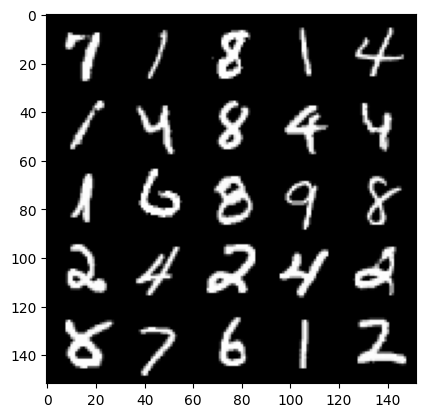

 97%|█████████▋| 454/469 [00:11<00:00, 37.88it/s]

Step 83000: Generator loss: 1.3768558197021485, discriminator loss: 0.4604205605387687


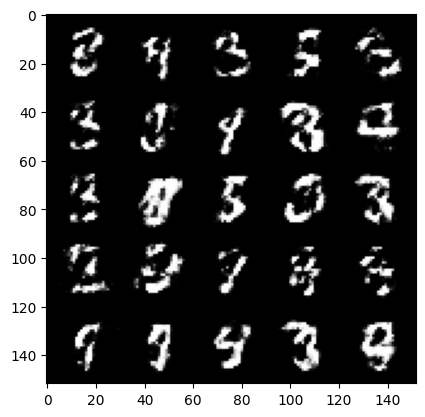

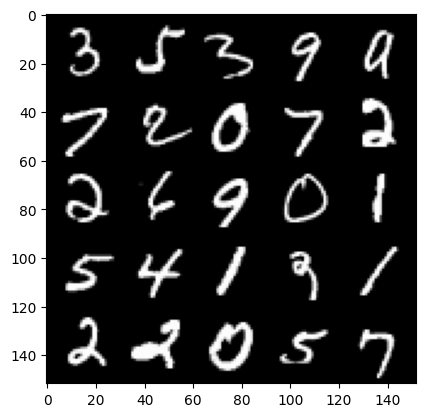

  3%|▎         | 16/469 [00:00<00:11, 38.14it/s]

Step 83500: Generator loss: 1.4840210640430456, discriminator loss: 0.4308772722482683


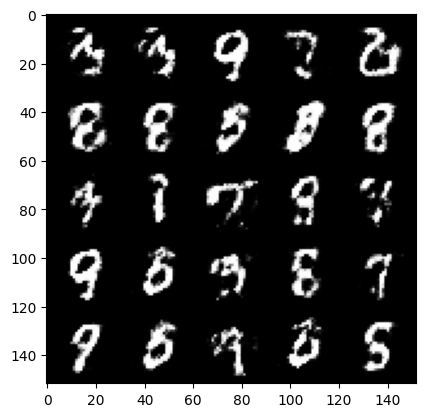

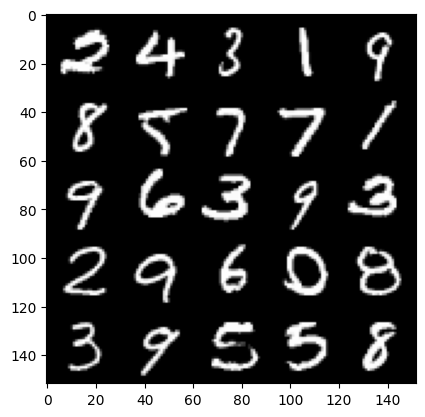

 10%|█         | 49/469 [00:01<00:10, 39.07it/s]

Step 84000: Generator loss: 1.4957316951751707, discriminator loss: 0.4169749824404716


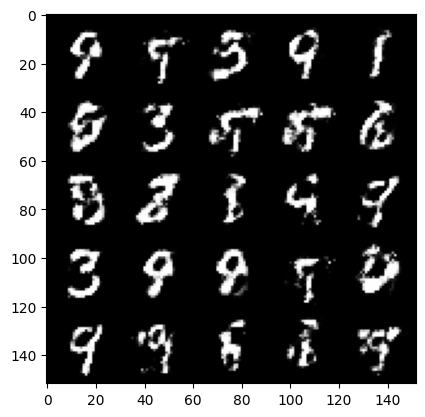

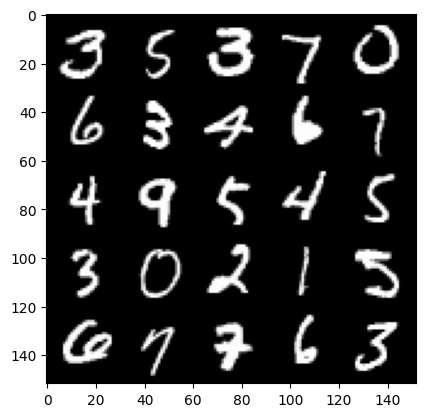

 17%|█▋        | 80/469 [00:02<00:10, 38.65it/s]

Step 84500: Generator loss: 1.5169515182971944, discriminator loss: 0.41777889049053196


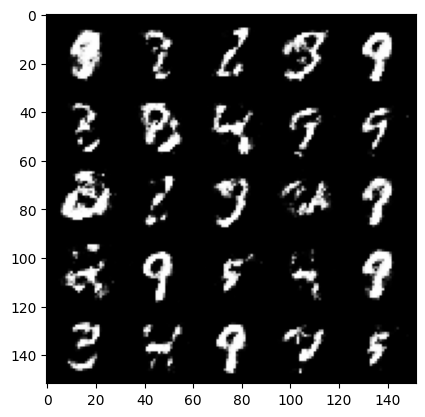

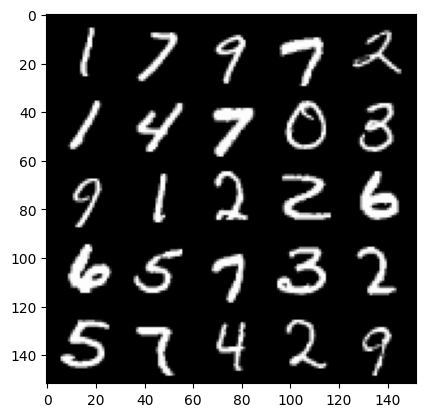

 23%|██▎       | 110/469 [00:02<00:09, 38.24it/s]

Step 85000: Generator loss: 1.515798409938812, discriminator loss: 0.41977226746082313


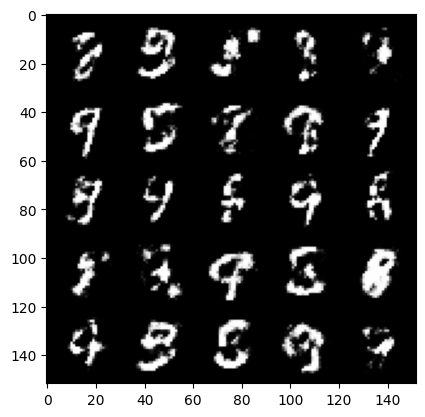

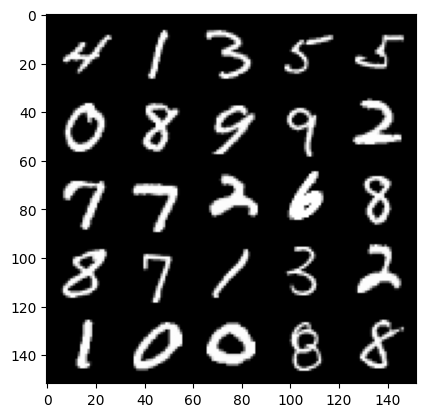

 30%|███       | 141/469 [00:03<00:08, 40.50it/s]

Step 85500: Generator loss: 1.5265881423950192, discriminator loss: 0.4304680051803588


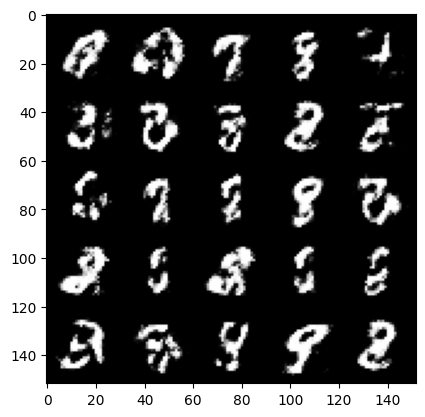

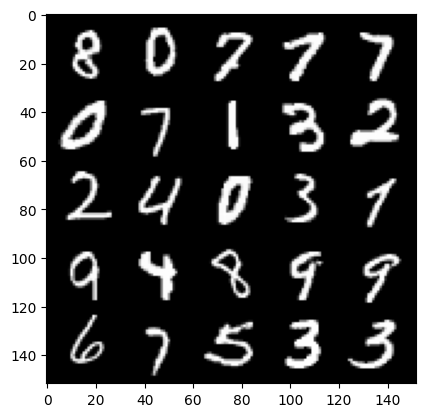

 36%|███▌      | 169/469 [00:04<00:07, 40.43it/s]

Step 86000: Generator loss: 1.5159210090637216, discriminator loss: 0.41950620400905597


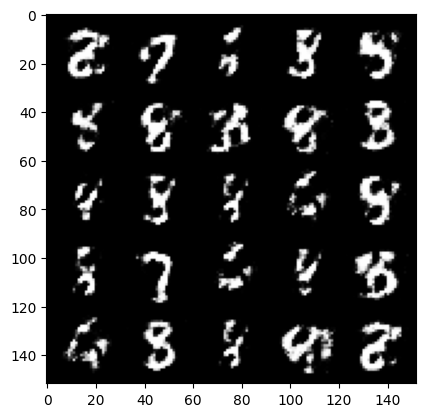

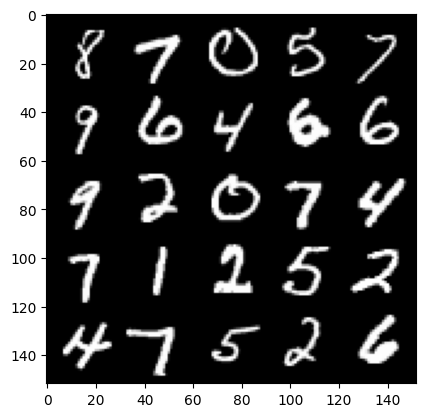

 43%|████▎     | 200/469 [00:05<00:06, 40.24it/s]

Step 86500: Generator loss: 1.505097341060639, discriminator loss: 0.420228284716606


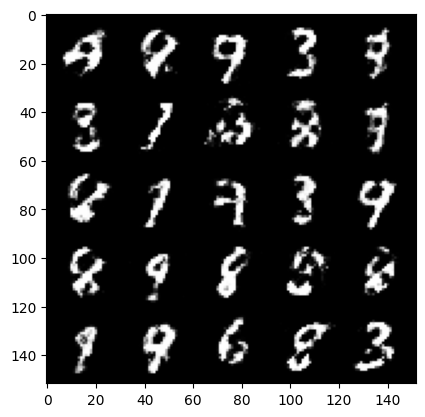

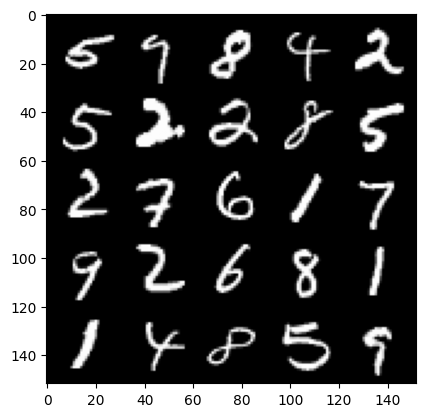

 50%|█████     | 235/469 [00:06<00:05, 39.38it/s]

Step 87000: Generator loss: 1.4784721593856807, discriminator loss: 0.4316261169910433


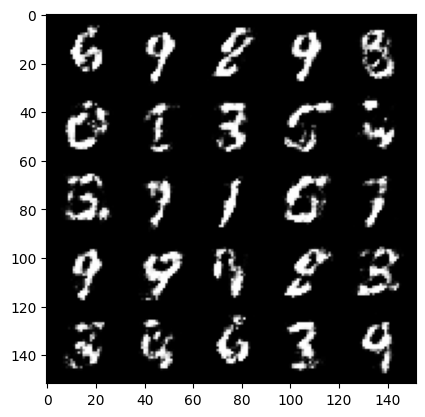

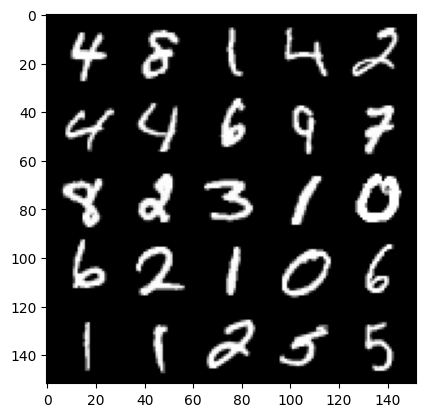

 56%|█████▌    | 262/469 [00:06<00:05, 40.30it/s]

Step 87500: Generator loss: 1.4568494753837589, discriminator loss: 0.45082982212305117


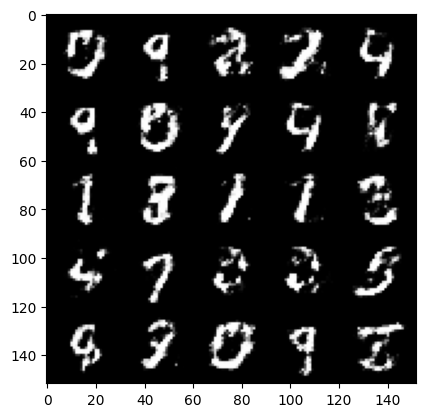

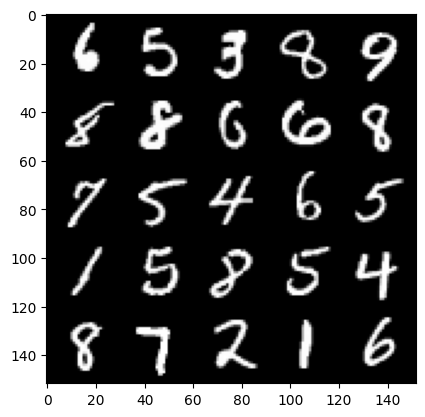

 62%|██████▏   | 293/469 [00:07<00:04, 40.01it/s]

Step 88000: Generator loss: 1.3512946109771717, discriminator loss: 0.4874371716976166


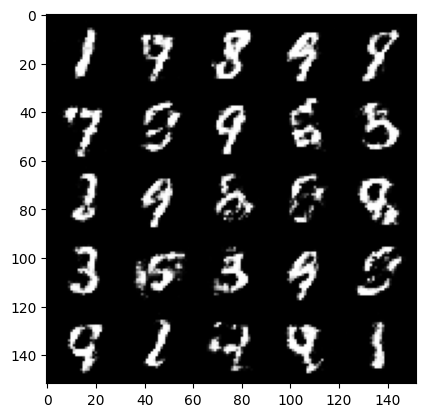

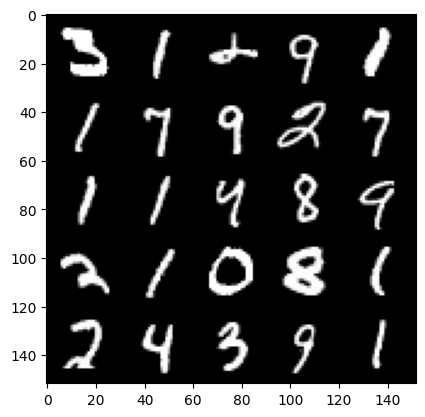

 69%|██████▉   | 325/469 [00:08<00:03, 40.24it/s]

Step 88500: Generator loss: 1.404240904808045, discriminator loss: 0.443303301155567


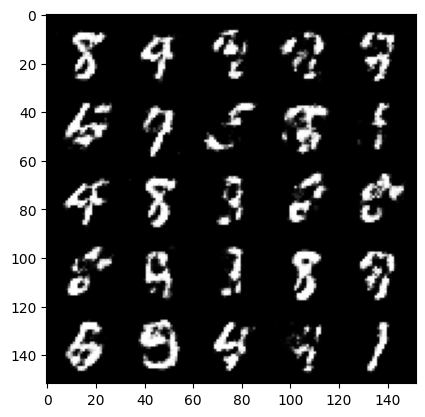

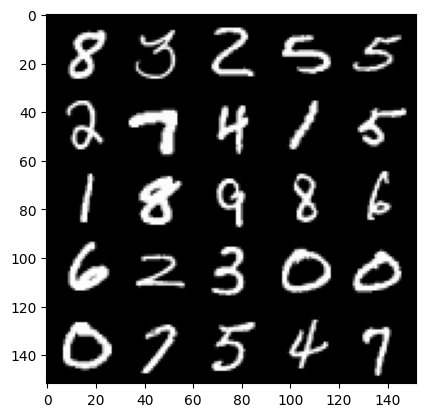

 76%|███████▋  | 358/469 [00:09<00:02, 37.87it/s]

Step 89000: Generator loss: 1.4180964837074268, discriminator loss: 0.4493388950824739


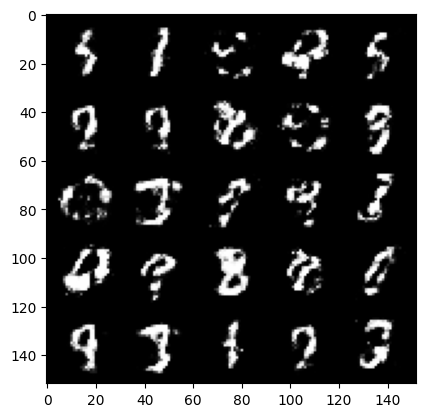

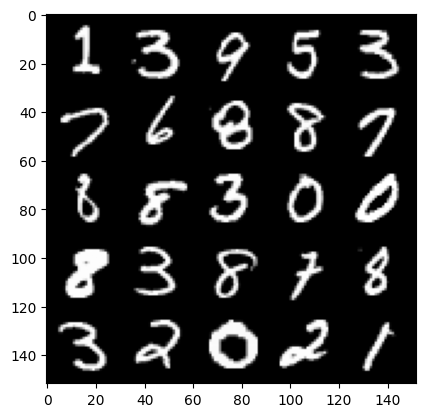

 82%|████████▏ | 386/469 [00:09<00:02, 38.71it/s]

Step 89500: Generator loss: 1.3496803660392755, discriminator loss: 0.47330250221490844


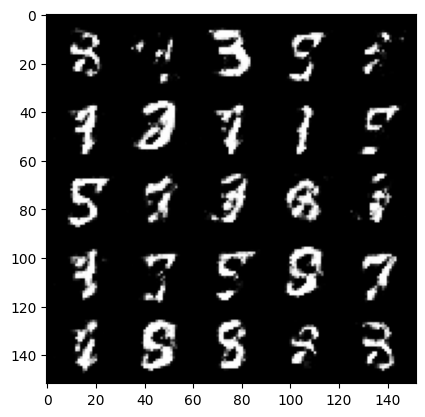

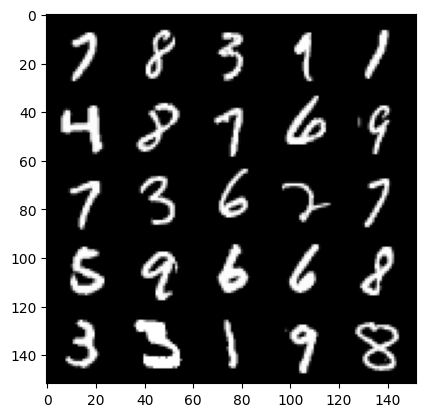

 90%|████████▉ | 421/469 [00:10<00:01, 39.22it/s]

Step 90000: Generator loss: 1.303978221416473, discriminator loss: 0.4868618931770323


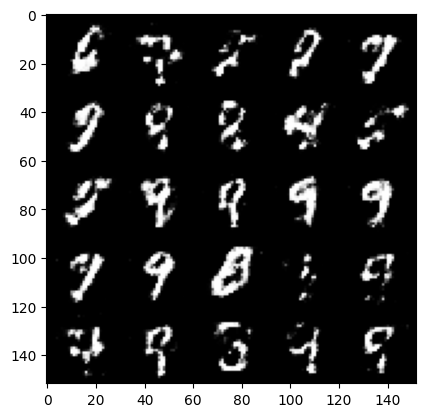

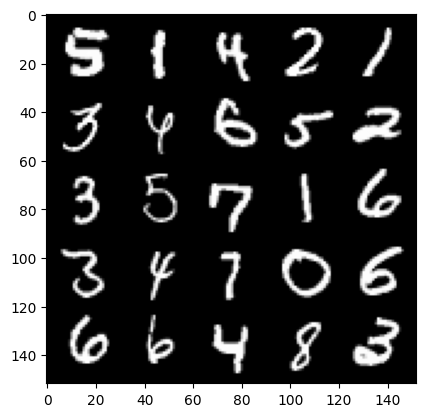

 96%|█████████▋| 452/469 [00:11<00:00, 39.58it/s]

Step 90500: Generator loss: 1.2795967419147494, discriminator loss: 0.4893460524678234


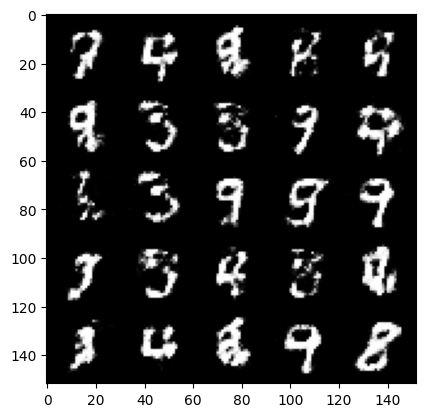

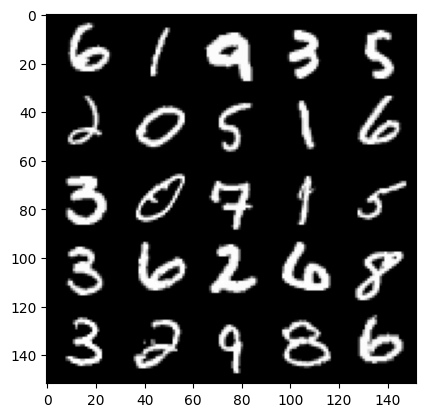

  3%|▎         | 12/469 [00:00<00:11, 38.15it/s]

Step 91000: Generator loss: 1.3202575936317438, discriminator loss: 0.47531739908456805


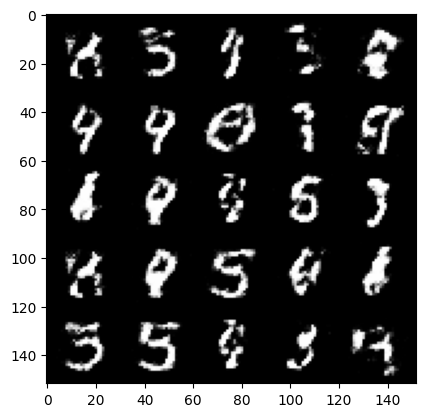

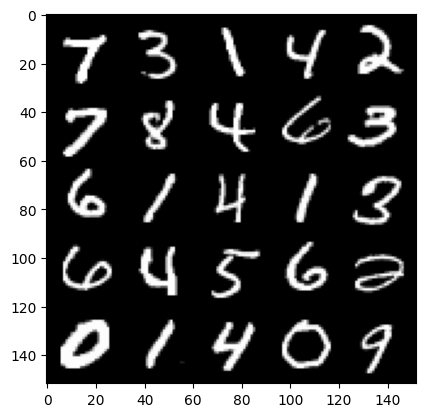

  9%|▉         | 43/469 [00:01<00:11, 38.66it/s]

Step 91500: Generator loss: 1.4365323474407206, discriminator loss: 0.43831544423103325


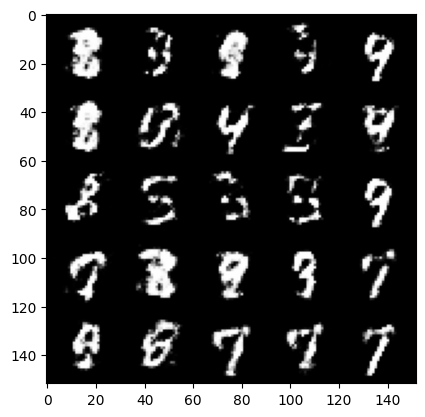

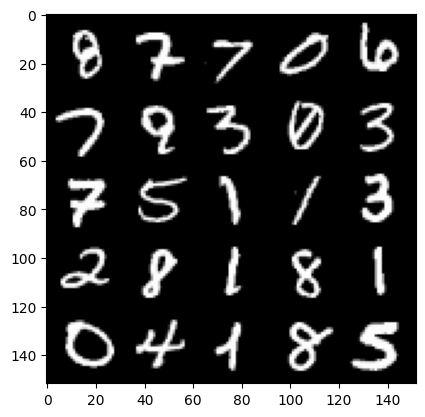

 16%|█▌        | 76/469 [00:01<00:10, 39.26it/s]

Step 92000: Generator loss: 1.3676953854560858, discriminator loss: 0.4596111959815024


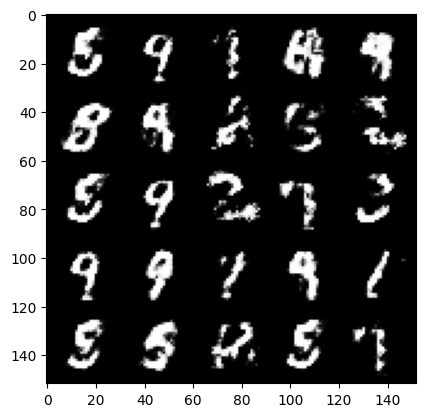

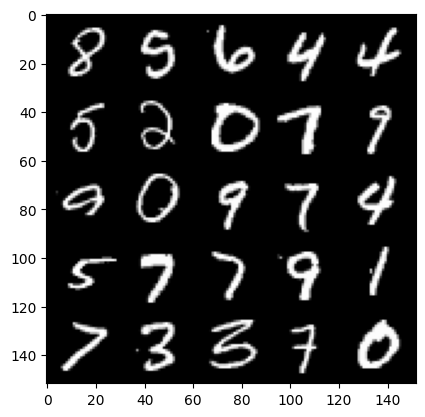

 22%|██▏       | 104/469 [00:02<00:09, 38.41it/s]

Step 92500: Generator loss: 1.3580789816379555, discriminator loss: 0.45915575957298266


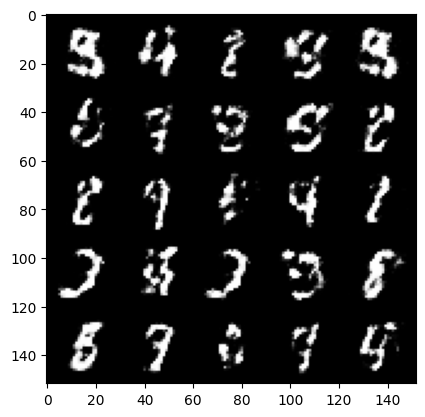

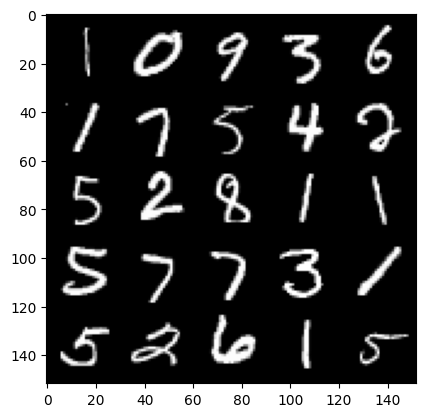

 29%|██▉       | 138/469 [00:03<00:08, 40.42it/s]

Step 93000: Generator loss: 1.357088175058365, discriminator loss: 0.45788790255784995


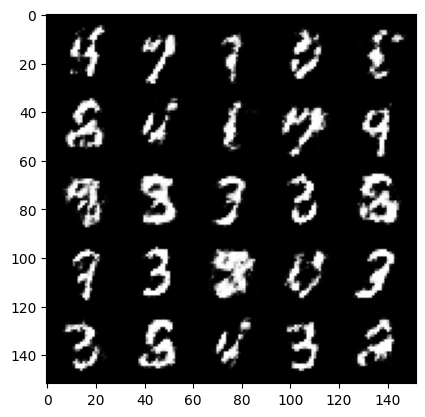

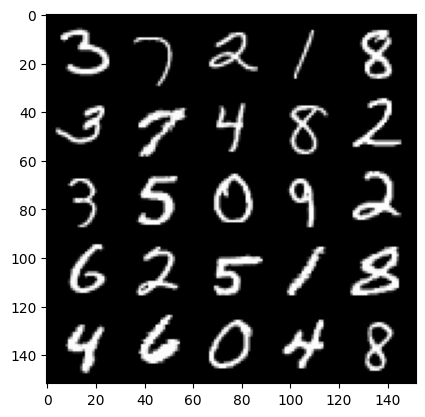

 36%|███▌      | 168/469 [00:04<00:07, 40.07it/s]

Step 93500: Generator loss: 1.3866077139377606, discriminator loss: 0.44502720147371294


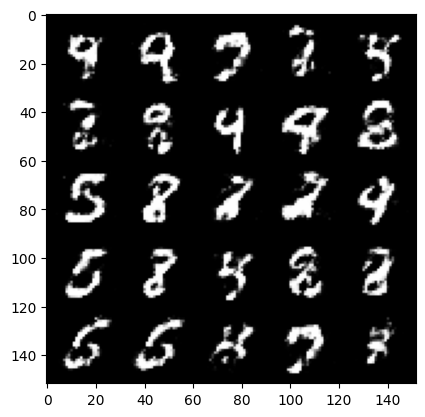

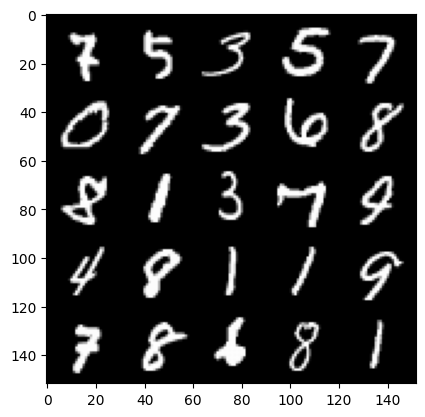

100%|██████████| 469/469 [00:12<00:00, 38.26it/s]


In [43]:
# UNQ_C8 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: 

cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False
for epoch in range(n_epochs):
  
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real,cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1
